# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
#data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Extracting mnist: 100%|██████████| 60.0K/60.0K [00:11<00:00, 5.23KFile/s]


Extracting celeba...


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

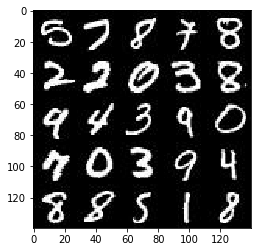

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

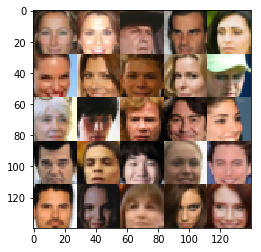

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    real_input_images = tf.placeholder(dtype=tf.float32,shape = [None,image_width,image_height,image_channels])
    z_data = tf.placeholder(dtype=tf.float32,shape = [None,z_dim])
    lr = tf.placeholder(dtype=tf.float32,name="learning_rate")
    return real_input_images, z_data, lr


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False,alpha = 0.2):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    
    xav_init = tf.contrib.layers.xavier_initializer()
    keep_prob = 0.5
    with tf.variable_scope("discriminator", reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same',kernel_initializer = xav_init)
        x1 = tf.layers.dropout(x1, rate=(keep_prob), training=True)
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same',kernel_initializer = xav_init)
        x2 = tf.layers.dropout(x2, rate=(keep_prob), training=True)
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same',kernel_initializer = xav_init)
        x3 = tf.layers.dropout(x3, rate=(keep_prob), training=True)
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True,alpha = 0.20):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    reuse_state = not is_train
    xav = tf.contrib.layers.xavier_initializer()
    keep_prob = 0.5
    with tf.variable_scope('generator', reuse=reuse_state):
         # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*256)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 256))
        x1 = tf.layers.dropout(x1, rate=(keep_prob), training=True)
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # print(x1.shape)
        # 4x4x256 now
        #change from 5 to 4 below
        x2 = tf.layers.conv2d_transpose(x1, 128, 4, strides=1, padding='valid', kernel_initializer=xav)
        x2 = tf.layers.dropout(x2, rate=(keep_prob), training=True)
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # print(x2.shape)
        # 7x7x128 now
        
        x3 = tf.layers.conv2d_transpose(x2, 64, 5, strides=2, padding='same', kernel_initializer=xav)
        x3 = tf.layers.dropout(x3, rate=(keep_prob), training=True)
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        
        x4 = tf.layers.conv2d_transpose(x2, 32, 5, strides=2, padding='same', kernel_initializer=xav)
        x4 = tf.layers.dropout(x4, rate=(keep_prob), training=True)
        x4 = tf.layers.batch_normalization(x4, training=is_train)
        x4 = tf.maximum(alpha * x4, x4)
        # print(x3.shape)
        # 14x14x64 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x4, out_channel_dim, 5, strides=2, padding='same', kernel_initializer=xav)
        # print(logits.shape)
        # 28x28x5 now
        
        out = tf.tanh(logits)
        
        return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim, alpha = 0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    smoothing = 0.9
    g_model = generator(input_z, out_channel_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real
                                                #,labels= tf.fill(d_logits_real.get_shape(), smoothing)
                                                ,labels= tf.ones_like(d_model_real)*smoothing))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake
                                                ,labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake
                                                ,labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    _, img_height, img_width, img_channel = data_shape    
    inputs_real, inputs_z, lr = model_inputs(img_height, img_width, img_channel, z_dim)
    
    d_loss, g_loss = model_loss(inputs_real, inputs_z, img_channel)
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    losses = []
    steps = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                
                # Convert the images values from -.5, .5 to -1, 1
                batch_images *= 2
                
                batch_z = np.random.uniform(-1, 1, size=[batch_size, z_dim])
                
                # Run optimizers
                sess.run(d_opt, feed_dict={inputs_real: batch_images, inputs_z: batch_z, lr: learning_rate})
                sess.run(g_opt, feed_dict={inputs_real: batch_images, inputs_z: batch_z, lr: learning_rate})
                sess.run(g_opt, feed_dict={inputs_real: batch_images, inputs_z: batch_z, lr: learning_rate})
    
                # Show the loss every 10 steps
                if steps % 10 == 0:
                    train_loss_d = d_loss.eval({inputs_real: batch_images, inputs_z: batch_z})
                    train_loss_g = g_loss.eval({inputs_z: batch_z})
                    
                    print('Epoch: {}/{}'.format(epoch_i + 1, epoch_count),
                          'Discriminator Loss: {}'.format(train_loss_d),
                          'Generator Loss: {}'.format(train_loss_g))
                    
                    # Save the losses to view after training
                    losses.append((train_loss_d, train_loss_g))
                
                # Show the generator ouput every 100 steps
                if steps % 100 == 0:
                    show_generator_output(sess, 25, inputs_z, data_shape[3], data_image_mode)
    
    return losses
                
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch: 1/2 Discriminator Loss: 1.3702822923660278 Generator Loss: 0.8103255033493042
Epoch: 1/2 Discriminator Loss: 1.519286870956421 Generator Loss: 0.8017351627349854
Epoch: 1/2 Discriminator Loss: 1.5324488878250122 Generator Loss: 0.5075470805168152
Epoch: 1/2 Discriminator Loss: 1.321492075920105 Generator Loss: 1.288707971572876
Epoch: 1/2 Discriminator Loss: 1.2174973487854004 Generator Loss: 1.3117433786392212
Epoch: 1/2 Discriminator Loss: 1.279130458831787 Generator Loss: 1.022763967514038
Epoch: 1/2 Discriminator Loss: 1.4794611930847168 Generator Loss: 0.8380999565124512
Epoch: 1/2 Discriminator Loss: 1.1748906373977661 Generator Loss: 2.161454200744629
Epoch: 1/2 Discriminator Loss: 1.4156677722930908 Generator Loss: 1.407326102256775
Epoch: 1/2 Discriminator Loss: 1.2081525325775146 Generator Loss: 1.476306676864624


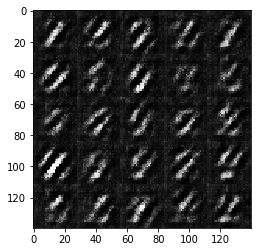

Epoch: 1/2 Discriminator Loss: 1.308555245399475 Generator Loss: 0.8345716595649719
Epoch: 1/2 Discriminator Loss: 1.1789580583572388 Generator Loss: 2.203615188598633
Epoch: 1/2 Discriminator Loss: 1.2146971225738525 Generator Loss: 1.1539051532745361
Epoch: 1/2 Discriminator Loss: 1.3455545902252197 Generator Loss: 1.2768938541412354
Epoch: 1/2 Discriminator Loss: 1.1189956665039062 Generator Loss: 0.910425066947937
Epoch: 1/2 Discriminator Loss: 1.4037013053894043 Generator Loss: 1.6171860694885254
Epoch: 1/2 Discriminator Loss: 1.2356094121932983 Generator Loss: 1.3518630266189575
Epoch: 1/2 Discriminator Loss: 1.4548767805099487 Generator Loss: 1.1609796285629272
Epoch: 1/2 Discriminator Loss: 1.3045574426651 Generator Loss: 0.8996471166610718
Epoch: 1/2 Discriminator Loss: 1.459968090057373 Generator Loss: 1.3977376222610474


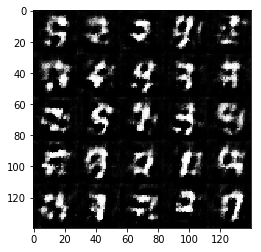

Epoch: 1/2 Discriminator Loss: 1.1112635135650635 Generator Loss: 1.03603196144104
Epoch: 1/2 Discriminator Loss: 1.6211521625518799 Generator Loss: 1.6247860193252563
Epoch: 1/2 Discriminator Loss: 1.109370231628418 Generator Loss: 1.083580493927002
Epoch: 1/2 Discriminator Loss: 1.132751703262329 Generator Loss: 1.0390846729278564
Epoch: 1/2 Discriminator Loss: 1.106766700744629 Generator Loss: 1.2393428087234497
Epoch: 1/2 Discriminator Loss: 1.1471589803695679 Generator Loss: 1.3624367713928223
Epoch: 1/2 Discriminator Loss: 1.6329143047332764 Generator Loss: 1.256222128868103
Epoch: 1/2 Discriminator Loss: 1.2894452810287476 Generator Loss: 0.9949078559875488
Epoch: 1/2 Discriminator Loss: 1.2306602001190186 Generator Loss: 1.1251435279846191
Epoch: 1/2 Discriminator Loss: 1.6354260444641113 Generator Loss: 0.8505319952964783


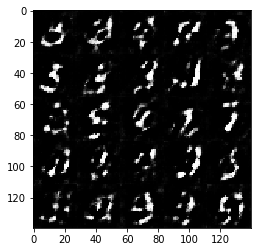

Epoch: 1/2 Discriminator Loss: 1.4078552722930908 Generator Loss: 1.0221937894821167
Epoch: 1/2 Discriminator Loss: 1.3475160598754883 Generator Loss: 0.9486749172210693
Epoch: 1/2 Discriminator Loss: 1.3329014778137207 Generator Loss: 1.4034740924835205
Epoch: 1/2 Discriminator Loss: 1.5971953868865967 Generator Loss: 0.6669455766677856
Epoch: 1/2 Discriminator Loss: 1.398836374282837 Generator Loss: 1.0489248037338257
Epoch: 1/2 Discriminator Loss: 1.1346021890640259 Generator Loss: 1.0502835512161255
Epoch: 1/2 Discriminator Loss: 1.3143945932388306 Generator Loss: 1.4823298454284668
Epoch: 1/2 Discriminator Loss: 1.0013223886489868 Generator Loss: 1.2283563613891602
Epoch: 1/2 Discriminator Loss: 1.1027240753173828 Generator Loss: 1.5784602165222168
Epoch: 1/2 Discriminator Loss: 1.2998895645141602 Generator Loss: 1.007387638092041


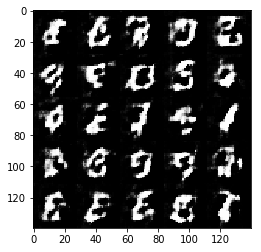

Epoch: 1/2 Discriminator Loss: 1.2740837335586548 Generator Loss: 1.1959657669067383
Epoch: 1/2 Discriminator Loss: 1.5901362895965576 Generator Loss: 0.7763429284095764
Epoch: 1/2 Discriminator Loss: 1.3150464296340942 Generator Loss: 1.2196695804595947
Epoch: 1/2 Discriminator Loss: 1.2648612260818481 Generator Loss: 1.110962152481079
Epoch: 1/2 Discriminator Loss: 1.474158525466919 Generator Loss: 1.0213613510131836
Epoch: 1/2 Discriminator Loss: 1.3482552766799927 Generator Loss: 1.156524419784546
Epoch: 1/2 Discriminator Loss: 1.1579313278198242 Generator Loss: 1.1567704677581787
Epoch: 1/2 Discriminator Loss: 1.235907793045044 Generator Loss: 0.9428659081459045
Epoch: 1/2 Discriminator Loss: 1.297568678855896 Generator Loss: 1.0123796463012695
Epoch: 1/2 Discriminator Loss: 1.137377381324768 Generator Loss: 1.2816498279571533


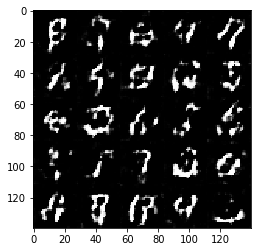

Epoch: 1/2 Discriminator Loss: 1.1336545944213867 Generator Loss: 1.0090501308441162
Epoch: 1/2 Discriminator Loss: 1.4417959451675415 Generator Loss: 0.6533852219581604
Epoch: 1/2 Discriminator Loss: 1.2280454635620117 Generator Loss: 0.9757595062255859
Epoch: 1/2 Discriminator Loss: 1.413022518157959 Generator Loss: 0.700104296207428
Epoch: 1/2 Discriminator Loss: 1.1793532371520996 Generator Loss: 1.06399405002594
Epoch: 1/2 Discriminator Loss: 1.4496479034423828 Generator Loss: 0.757703423500061
Epoch: 1/2 Discriminator Loss: 1.292140245437622 Generator Loss: 0.7694442272186279
Epoch: 1/2 Discriminator Loss: 1.2490720748901367 Generator Loss: 1.2063710689544678
Epoch: 1/2 Discriminator Loss: 1.2464280128479004 Generator Loss: 1.0410714149475098
Epoch: 1/2 Discriminator Loss: 1.390529990196228 Generator Loss: 0.9119998216629028


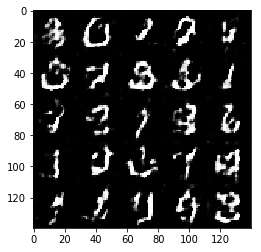

Epoch: 1/2 Discriminator Loss: 1.1466888189315796 Generator Loss: 1.2078073024749756
Epoch: 1/2 Discriminator Loss: 1.2851274013519287 Generator Loss: 1.2086377143859863
Epoch: 1/2 Discriminator Loss: 1.0988261699676514 Generator Loss: 0.8627527952194214
Epoch: 1/2 Discriminator Loss: 1.409559965133667 Generator Loss: 1.1244595050811768
Epoch: 1/2 Discriminator Loss: 1.2057937383651733 Generator Loss: 1.4305095672607422
Epoch: 1/2 Discriminator Loss: 1.1865124702453613 Generator Loss: 1.1009654998779297
Epoch: 1/2 Discriminator Loss: 1.353835105895996 Generator Loss: 0.8939172625541687
Epoch: 1/2 Discriminator Loss: 1.308343529701233 Generator Loss: 0.9628197550773621
Epoch: 1/2 Discriminator Loss: 1.1671063899993896 Generator Loss: 1.0879573822021484
Epoch: 1/2 Discriminator Loss: 1.374017596244812 Generator Loss: 0.7480915784835815


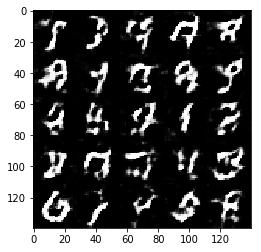

Epoch: 1/2 Discriminator Loss: 1.0009441375732422 Generator Loss: 1.278185486793518
Epoch: 1/2 Discriminator Loss: 1.5870771408081055 Generator Loss: 0.8387119770050049
Epoch: 1/2 Discriminator Loss: 1.472141146659851 Generator Loss: 0.6537468433380127
Epoch: 1/2 Discriminator Loss: 1.1293425559997559 Generator Loss: 1.0387237071990967
Epoch: 1/2 Discriminator Loss: 1.180687427520752 Generator Loss: 1.3350435495376587
Epoch: 1/2 Discriminator Loss: 1.3069305419921875 Generator Loss: 0.9833154678344727
Epoch: 1/2 Discriminator Loss: 1.2213572263717651 Generator Loss: 1.1664923429489136
Epoch: 1/2 Discriminator Loss: 1.0792546272277832 Generator Loss: 1.0452792644500732
Epoch: 1/2 Discriminator Loss: 1.204624891281128 Generator Loss: 1.7370154857635498
Epoch: 1/2 Discriminator Loss: 1.082620620727539 Generator Loss: 1.0996774435043335


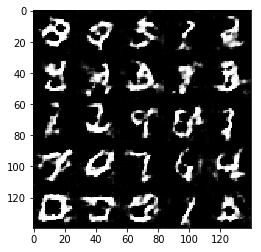

Epoch: 1/2 Discriminator Loss: 1.126760482788086 Generator Loss: 1.3159866333007812
Epoch: 1/2 Discriminator Loss: 1.168605089187622 Generator Loss: 1.2606281042099
Epoch: 1/2 Discriminator Loss: 1.317440390586853 Generator Loss: 1.115447759628296
Epoch: 1/2 Discriminator Loss: 1.3021074533462524 Generator Loss: 1.0721776485443115
Epoch: 1/2 Discriminator Loss: 1.2282991409301758 Generator Loss: 0.8763377666473389
Epoch: 1/2 Discriminator Loss: 1.1267790794372559 Generator Loss: 0.994697093963623
Epoch: 1/2 Discriminator Loss: 1.1833958625793457 Generator Loss: 1.3274922370910645
Epoch: 1/2 Discriminator Loss: 1.248644471168518 Generator Loss: 0.6468905210494995
Epoch: 1/2 Discriminator Loss: 1.1816861629486084 Generator Loss: 1.335179328918457
Epoch: 1/2 Discriminator Loss: 1.44919753074646 Generator Loss: 1.1259610652923584


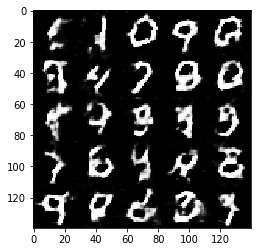

Epoch: 1/2 Discriminator Loss: 1.0399374961853027 Generator Loss: 1.3086856603622437
Epoch: 1/2 Discriminator Loss: 1.16526198387146 Generator Loss: 1.3443944454193115
Epoch: 1/2 Discriminator Loss: 1.3787517547607422 Generator Loss: 1.2981038093566895
Epoch: 1/2 Discriminator Loss: 1.2814295291900635 Generator Loss: 0.9720869660377502
Epoch: 1/2 Discriminator Loss: 1.0493900775909424 Generator Loss: 1.471893072128296
Epoch: 1/2 Discriminator Loss: 1.1487629413604736 Generator Loss: 1.031337857246399
Epoch: 1/2 Discriminator Loss: 1.2438476085662842 Generator Loss: 1.3216118812561035
Epoch: 1/2 Discriminator Loss: 1.117708683013916 Generator Loss: 0.9196362495422363
Epoch: 1/2 Discriminator Loss: 1.2339682579040527 Generator Loss: 1.4471869468688965
Epoch: 1/2 Discriminator Loss: 1.1299030780792236 Generator Loss: 1.2027761936187744


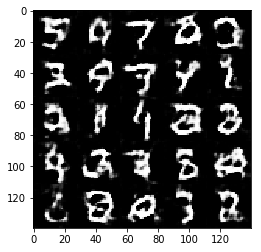

Epoch: 1/2 Discriminator Loss: 1.399404525756836 Generator Loss: 0.8949453234672546
Epoch: 1/2 Discriminator Loss: 1.3056482076644897 Generator Loss: 0.5859071016311646
Epoch: 1/2 Discriminator Loss: 1.1351666450500488 Generator Loss: 1.1892098188400269
Epoch: 1/2 Discriminator Loss: 1.3013710975646973 Generator Loss: 1.1019787788391113
Epoch: 1/2 Discriminator Loss: 1.4377151727676392 Generator Loss: 0.8839354515075684
Epoch: 1/2 Discriminator Loss: 1.3114891052246094 Generator Loss: 1.3160099983215332
Epoch: 1/2 Discriminator Loss: 1.1751949787139893 Generator Loss: 1.0012661218643188
Epoch: 1/2 Discriminator Loss: 1.1926840543746948 Generator Loss: 1.0125885009765625
Epoch: 1/2 Discriminator Loss: 1.2569575309753418 Generator Loss: 0.8828661441802979
Epoch: 1/2 Discriminator Loss: 1.1148512363433838 Generator Loss: 0.9178200960159302


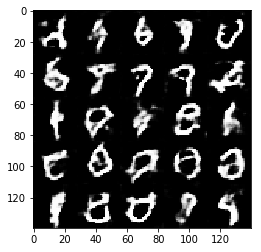

Epoch: 1/2 Discriminator Loss: 0.9334709644317627 Generator Loss: 1.0705320835113525
Epoch: 1/2 Discriminator Loss: 1.432934045791626 Generator Loss: 0.8396341800689697
Epoch: 1/2 Discriminator Loss: 1.3896236419677734 Generator Loss: 1.7144358158111572
Epoch: 1/2 Discriminator Loss: 1.212444543838501 Generator Loss: 1.18070387840271
Epoch: 1/2 Discriminator Loss: 1.163008451461792 Generator Loss: 1.101567029953003
Epoch: 1/2 Discriminator Loss: 1.1064893007278442 Generator Loss: 1.2123148441314697
Epoch: 1/2 Discriminator Loss: 1.4561536312103271 Generator Loss: 0.7389357686042786
Epoch: 1/2 Discriminator Loss: 1.2116096019744873 Generator Loss: 1.0653167963027954
Epoch: 1/2 Discriminator Loss: 1.1276626586914062 Generator Loss: 1.1985139846801758
Epoch: 1/2 Discriminator Loss: 1.5022742748260498 Generator Loss: 1.7658888101577759


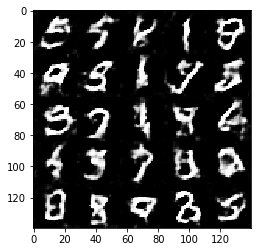

Epoch: 1/2 Discriminator Loss: 1.1481916904449463 Generator Loss: 0.9990717172622681
Epoch: 1/2 Discriminator Loss: 1.2250076532363892 Generator Loss: 1.0689096450805664
Epoch: 1/2 Discriminator Loss: 1.3294901847839355 Generator Loss: 0.8841372132301331
Epoch: 1/2 Discriminator Loss: 1.2176966667175293 Generator Loss: 1.2119934558868408
Epoch: 1/2 Discriminator Loss: 1.3654119968414307 Generator Loss: 1.4354441165924072
Epoch: 1/2 Discriminator Loss: 1.4482855796813965 Generator Loss: 0.9573966860771179
Epoch: 1/2 Discriminator Loss: 1.4514312744140625 Generator Loss: 1.5540990829467773
Epoch: 1/2 Discriminator Loss: 1.1890789270401 Generator Loss: 1.2314519882202148
Epoch: 1/2 Discriminator Loss: 1.0984282493591309 Generator Loss: 0.9875925779342651
Epoch: 1/2 Discriminator Loss: 1.2267259359359741 Generator Loss: 1.214693307876587


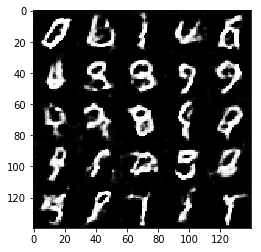

Epoch: 1/2 Discriminator Loss: 1.2386795282363892 Generator Loss: 1.397533655166626
Epoch: 1/2 Discriminator Loss: 1.2220457792282104 Generator Loss: 0.9814472198486328
Epoch: 1/2 Discriminator Loss: 1.0685631036758423 Generator Loss: 1.018230676651001
Epoch: 1/2 Discriminator Loss: 1.1135222911834717 Generator Loss: 1.3184887170791626
Epoch: 1/2 Discriminator Loss: 1.1355496644973755 Generator Loss: 1.4635666608810425
Epoch: 1/2 Discriminator Loss: 1.0740199089050293 Generator Loss: 1.0698343515396118
Epoch: 1/2 Discriminator Loss: 1.048079252243042 Generator Loss: 1.2973418235778809
Epoch: 1/2 Discriminator Loss: 1.358707070350647 Generator Loss: 1.1519571542739868
Epoch: 1/2 Discriminator Loss: 1.0557632446289062 Generator Loss: 1.3518574237823486
Epoch: 1/2 Discriminator Loss: 1.1009712219238281 Generator Loss: 1.3149049282073975


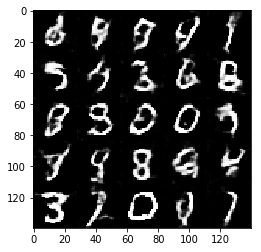

Epoch: 1/2 Discriminator Loss: 1.2638564109802246 Generator Loss: 1.0900341272354126
Epoch: 1/2 Discriminator Loss: 1.1838397979736328 Generator Loss: 1.148402452468872
Epoch: 1/2 Discriminator Loss: 1.256894826889038 Generator Loss: 0.7871446013450623
Epoch: 1/2 Discriminator Loss: 1.2684504985809326 Generator Loss: 0.7168112993240356
Epoch: 1/2 Discriminator Loss: 1.124053955078125 Generator Loss: 1.1974202394485474
Epoch: 1/2 Discriminator Loss: 1.2495911121368408 Generator Loss: 1.2585062980651855
Epoch: 1/2 Discriminator Loss: 1.0534827709197998 Generator Loss: 0.9927443265914917
Epoch: 1/2 Discriminator Loss: 1.0887882709503174 Generator Loss: 1.3495850563049316
Epoch: 1/2 Discriminator Loss: 0.9596205949783325 Generator Loss: 1.4893505573272705
Epoch: 1/2 Discriminator Loss: 1.1810648441314697 Generator Loss: 1.4221501350402832


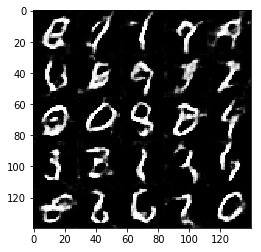

Epoch: 1/2 Discriminator Loss: 1.1394331455230713 Generator Loss: 1.3738819360733032
Epoch: 1/2 Discriminator Loss: 1.0530295372009277 Generator Loss: 1.2723021507263184
Epoch: 1/2 Discriminator Loss: 1.0884686708450317 Generator Loss: 1.650191307067871
Epoch: 1/2 Discriminator Loss: 0.9545329213142395 Generator Loss: 1.1199607849121094
Epoch: 1/2 Discriminator Loss: 1.1950513124465942 Generator Loss: 1.9139115810394287
Epoch: 1/2 Discriminator Loss: 1.1016855239868164 Generator Loss: 1.655639886856079
Epoch: 1/2 Discriminator Loss: 1.3189563751220703 Generator Loss: 1.3094680309295654
Epoch: 1/2 Discriminator Loss: 1.1292519569396973 Generator Loss: 0.7974381446838379
Epoch: 1/2 Discriminator Loss: 1.0877313613891602 Generator Loss: 1.1037659645080566
Epoch: 1/2 Discriminator Loss: 1.3546265363693237 Generator Loss: 1.7438404560089111


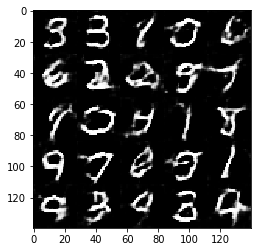

Epoch: 1/2 Discriminator Loss: 1.081963062286377 Generator Loss: 1.324084758758545
Epoch: 1/2 Discriminator Loss: 1.0836187601089478 Generator Loss: 1.2613961696624756
Epoch: 1/2 Discriminator Loss: 1.0783483982086182 Generator Loss: 0.9268340468406677
Epoch: 1/2 Discriminator Loss: 0.9226011037826538 Generator Loss: 1.1390470266342163
Epoch: 1/2 Discriminator Loss: 1.1605087518692017 Generator Loss: 1.0537421703338623
Epoch: 1/2 Discriminator Loss: 1.0893257856369019 Generator Loss: 0.9638296365737915
Epoch: 1/2 Discriminator Loss: 1.3581111431121826 Generator Loss: 2.095761299133301
Epoch: 1/2 Discriminator Loss: 1.1131395101547241 Generator Loss: 1.0084717273712158
Epoch: 1/2 Discriminator Loss: 1.039311170578003 Generator Loss: 1.3909586668014526
Epoch: 1/2 Discriminator Loss: 1.213882327079773 Generator Loss: 0.8240856528282166


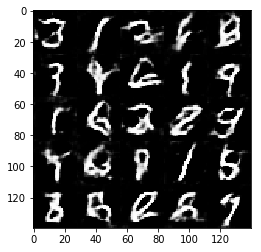

Epoch: 1/2 Discriminator Loss: 1.133164405822754 Generator Loss: 1.368456482887268
Epoch: 1/2 Discriminator Loss: 0.9166227579116821 Generator Loss: 0.9479632377624512
Epoch: 1/2 Discriminator Loss: 1.479536771774292 Generator Loss: 1.2758336067199707
Epoch: 1/2 Discriminator Loss: 0.747406005859375 Generator Loss: 1.5090171098709106
Epoch: 1/2 Discriminator Loss: 1.182655930519104 Generator Loss: 1.7614400386810303
Epoch: 1/2 Discriminator Loss: 1.3996317386627197 Generator Loss: 0.7380983829498291
Epoch: 1/2 Discriminator Loss: 0.9942880868911743 Generator Loss: 0.7879887819290161
Epoch: 1/2 Discriminator Loss: 1.0224372148513794 Generator Loss: 1.071721076965332
Epoch: 1/2 Discriminator Loss: 1.1090891361236572 Generator Loss: 1.0809178352355957
Epoch: 1/2 Discriminator Loss: 1.2110683917999268 Generator Loss: 0.7574964165687561


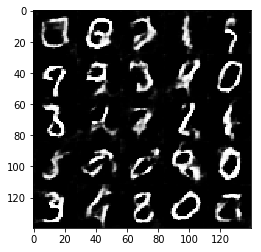

Epoch: 1/2 Discriminator Loss: 1.0855889320373535 Generator Loss: 1.327422857284546
Epoch: 1/2 Discriminator Loss: 1.0659276247024536 Generator Loss: 1.7871447801589966
Epoch: 1/2 Discriminator Loss: 1.2589133977890015 Generator Loss: 0.875362753868103
Epoch: 1/2 Discriminator Loss: 1.145652174949646 Generator Loss: 1.3361930847167969
Epoch: 1/2 Discriminator Loss: 1.218401312828064 Generator Loss: 1.0810387134552002
Epoch: 1/2 Discriminator Loss: 1.3467642068862915 Generator Loss: 1.5166780948638916
Epoch: 1/2 Discriminator Loss: 0.9976348876953125 Generator Loss: 1.0133874416351318
Epoch: 2/2 Discriminator Loss: 1.0817227363586426 Generator Loss: 0.8367280960083008
Epoch: 2/2 Discriminator Loss: 1.096946120262146 Generator Loss: 1.1162545680999756
Epoch: 2/2 Discriminator Loss: 0.911024272441864 Generator Loss: 1.432323694229126


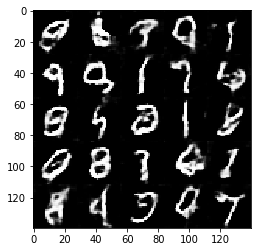

Epoch: 2/2 Discriminator Loss: 1.0448989868164062 Generator Loss: 1.165837049484253
Epoch: 2/2 Discriminator Loss: 1.1333141326904297 Generator Loss: 1.5517579317092896
Epoch: 2/2 Discriminator Loss: 1.1141562461853027 Generator Loss: 1.1276695728302002
Epoch: 2/2 Discriminator Loss: 1.177402377128601 Generator Loss: 1.1498620510101318
Epoch: 2/2 Discriminator Loss: 1.4763809442520142 Generator Loss: 0.49845486879348755
Epoch: 2/2 Discriminator Loss: 1.4015809297561646 Generator Loss: 0.8318254351615906
Epoch: 2/2 Discriminator Loss: 1.0572502613067627 Generator Loss: 1.7981395721435547
Epoch: 2/2 Discriminator Loss: 1.16837477684021 Generator Loss: 0.9355573058128357
Epoch: 2/2 Discriminator Loss: 1.0299110412597656 Generator Loss: 1.2807629108428955
Epoch: 2/2 Discriminator Loss: 1.1510385274887085 Generator Loss: 0.970697283744812


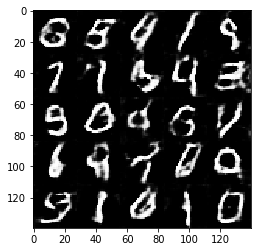

Epoch: 2/2 Discriminator Loss: 1.0027039051055908 Generator Loss: 0.9531636834144592
Epoch: 2/2 Discriminator Loss: 1.228341817855835 Generator Loss: 1.2933900356292725
Epoch: 2/2 Discriminator Loss: 1.1932146549224854 Generator Loss: 1.1159734725952148
Epoch: 2/2 Discriminator Loss: 0.989067554473877 Generator Loss: 1.4976645708084106
Epoch: 2/2 Discriminator Loss: 1.0631743669509888 Generator Loss: 1.7544474601745605
Epoch: 2/2 Discriminator Loss: 0.8818106651306152 Generator Loss: 1.1849725246429443
Epoch: 2/2 Discriminator Loss: 1.3778247833251953 Generator Loss: 0.7487865090370178
Epoch: 2/2 Discriminator Loss: 0.9775336384773254 Generator Loss: 0.9510496854782104
Epoch: 2/2 Discriminator Loss: 1.0340144634246826 Generator Loss: 0.6351576447486877
Epoch: 2/2 Discriminator Loss: 1.1436189413070679 Generator Loss: 1.5598626136779785


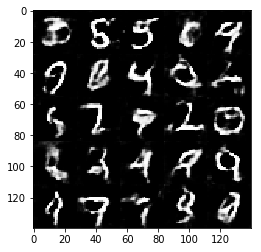

Epoch: 2/2 Discriminator Loss: 1.1044611930847168 Generator Loss: 1.8304206132888794
Epoch: 2/2 Discriminator Loss: 0.915461540222168 Generator Loss: 1.4070749282836914
Epoch: 2/2 Discriminator Loss: 0.9633147716522217 Generator Loss: 1.5492007732391357
Epoch: 2/2 Discriminator Loss: 1.1786412000656128 Generator Loss: 1.109366774559021
Epoch: 2/2 Discriminator Loss: 0.9811038970947266 Generator Loss: 1.1699483394622803
Epoch: 2/2 Discriminator Loss: 1.157719612121582 Generator Loss: 1.3325965404510498
Epoch: 2/2 Discriminator Loss: 0.913429856300354 Generator Loss: 1.35017728805542
Epoch: 2/2 Discriminator Loss: 0.9529722332954407 Generator Loss: 1.747124433517456
Epoch: 2/2 Discriminator Loss: 1.1237770318984985 Generator Loss: 1.02347731590271
Epoch: 2/2 Discriminator Loss: 1.0590453147888184 Generator Loss: 1.6429650783538818


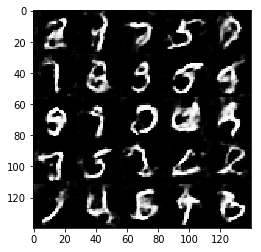

Epoch: 2/2 Discriminator Loss: 1.0245344638824463 Generator Loss: 1.218245029449463
Epoch: 2/2 Discriminator Loss: 0.945282518863678 Generator Loss: 1.314553141593933
Epoch: 2/2 Discriminator Loss: 0.856252133846283 Generator Loss: 1.438399314880371
Epoch: 2/2 Discriminator Loss: 0.7785934805870056 Generator Loss: 1.3286776542663574
Epoch: 2/2 Discriminator Loss: 0.9134407043457031 Generator Loss: 1.0323219299316406
Epoch: 2/2 Discriminator Loss: 1.1244341135025024 Generator Loss: 0.8589941263198853
Epoch: 2/2 Discriminator Loss: 1.2232087850570679 Generator Loss: 0.4768226742744446
Epoch: 2/2 Discriminator Loss: 0.9442929625511169 Generator Loss: 1.763972282409668
Epoch: 2/2 Discriminator Loss: 1.0621272325515747 Generator Loss: 0.8621070384979248
Epoch: 2/2 Discriminator Loss: 0.9419582486152649 Generator Loss: 1.8809669017791748


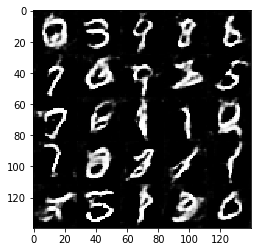

Epoch: 2/2 Discriminator Loss: 0.9726874828338623 Generator Loss: 1.5328543186187744
Epoch: 2/2 Discriminator Loss: 1.0280349254608154 Generator Loss: 1.5105689764022827
Epoch: 2/2 Discriminator Loss: 1.0836236476898193 Generator Loss: 0.9351685047149658
Epoch: 2/2 Discriminator Loss: 1.3286906480789185 Generator Loss: 1.2647478580474854
Epoch: 2/2 Discriminator Loss: 1.1976714134216309 Generator Loss: 1.8592619895935059
Epoch: 2/2 Discriminator Loss: 0.9673294425010681 Generator Loss: 1.1912117004394531
Epoch: 2/2 Discriminator Loss: 0.9830613732337952 Generator Loss: 1.2877626419067383
Epoch: 2/2 Discriminator Loss: 0.9345479011535645 Generator Loss: 2.080838203430176
Epoch: 2/2 Discriminator Loss: 0.9175620079040527 Generator Loss: 1.323714017868042
Epoch: 2/2 Discriminator Loss: 1.32429838180542 Generator Loss: 1.020681381225586


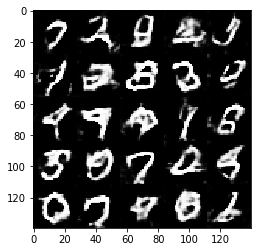

Epoch: 2/2 Discriminator Loss: 0.8519745469093323 Generator Loss: 1.4220352172851562
Epoch: 2/2 Discriminator Loss: 1.0717898607254028 Generator Loss: 1.1755690574645996
Epoch: 2/2 Discriminator Loss: 1.1074187755584717 Generator Loss: 2.304825782775879
Epoch: 2/2 Discriminator Loss: 0.8578252196311951 Generator Loss: 1.778916835784912
Epoch: 2/2 Discriminator Loss: 0.9305841326713562 Generator Loss: 1.911729097366333
Epoch: 2/2 Discriminator Loss: 1.1071161031723022 Generator Loss: 1.5512233972549438
Epoch: 2/2 Discriminator Loss: 1.1719095706939697 Generator Loss: 1.4686553478240967
Epoch: 2/2 Discriminator Loss: 0.852038562297821 Generator Loss: 1.7372030019760132
Epoch: 2/2 Discriminator Loss: 0.9956861138343811 Generator Loss: 1.2595055103302002
Epoch: 2/2 Discriminator Loss: 0.894679844379425 Generator Loss: 1.1511629819869995


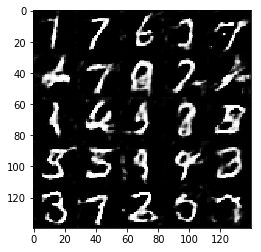

Epoch: 2/2 Discriminator Loss: 0.8127503991127014 Generator Loss: 2.0957324504852295
Epoch: 2/2 Discriminator Loss: 1.2522801160812378 Generator Loss: 1.0973045825958252
Epoch: 2/2 Discriminator Loss: 1.5825248956680298 Generator Loss: 0.5570352077484131
Epoch: 2/2 Discriminator Loss: 0.8593370318412781 Generator Loss: 1.5824148654937744
Epoch: 2/2 Discriminator Loss: 0.745855987071991 Generator Loss: 2.1448378562927246
Epoch: 2/2 Discriminator Loss: 1.1015874147415161 Generator Loss: 0.8166424036026001
Epoch: 2/2 Discriminator Loss: 0.9649146199226379 Generator Loss: 1.3262159824371338
Epoch: 2/2 Discriminator Loss: 0.9299788475036621 Generator Loss: 1.3389379978179932
Epoch: 2/2 Discriminator Loss: 1.357473373413086 Generator Loss: 0.722903847694397
Epoch: 2/2 Discriminator Loss: 0.7858001589775085 Generator Loss: 1.1759088039398193


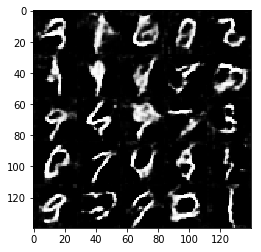

Epoch: 2/2 Discriminator Loss: 0.9296320676803589 Generator Loss: 2.617542266845703
Epoch: 2/2 Discriminator Loss: 0.9147844314575195 Generator Loss: 1.0210820436477661
Epoch: 2/2 Discriminator Loss: 1.0307708978652954 Generator Loss: 1.1390583515167236
Epoch: 2/2 Discriminator Loss: 0.9473016262054443 Generator Loss: 1.5201002359390259
Epoch: 2/2 Discriminator Loss: 1.4212315082550049 Generator Loss: 1.7035081386566162
Epoch: 2/2 Discriminator Loss: 0.8238481283187866 Generator Loss: 2.1855363845825195
Epoch: 2/2 Discriminator Loss: 0.965435266494751 Generator Loss: 2.1326379776000977
Epoch: 2/2 Discriminator Loss: 1.2298692464828491 Generator Loss: 1.2869641780853271
Epoch: 2/2 Discriminator Loss: 0.7523684501647949 Generator Loss: 1.3251237869262695
Epoch: 2/2 Discriminator Loss: 0.7990216016769409 Generator Loss: 1.3650007247924805


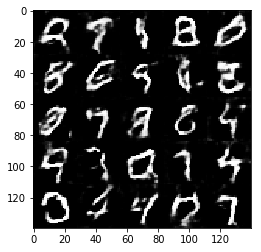

Epoch: 2/2 Discriminator Loss: 0.6488020420074463 Generator Loss: 1.6194789409637451
Epoch: 2/2 Discriminator Loss: 0.8407125473022461 Generator Loss: 2.071493148803711
Epoch: 2/2 Discriminator Loss: 0.9852182269096375 Generator Loss: 1.0309056043624878
Epoch: 2/2 Discriminator Loss: 0.9044151902198792 Generator Loss: 1.377791166305542
Epoch: 2/2 Discriminator Loss: 1.0689764022827148 Generator Loss: 2.160505771636963
Epoch: 2/2 Discriminator Loss: 0.7981671690940857 Generator Loss: 1.3023083209991455
Epoch: 2/2 Discriminator Loss: 0.7947724461555481 Generator Loss: 1.638000249862671
Epoch: 2/2 Discriminator Loss: 0.5257552266120911 Generator Loss: 2.667067527770996
Epoch: 2/2 Discriminator Loss: 0.7025608420372009 Generator Loss: 1.462137222290039
Epoch: 2/2 Discriminator Loss: 1.0230754613876343 Generator Loss: 2.4884471893310547


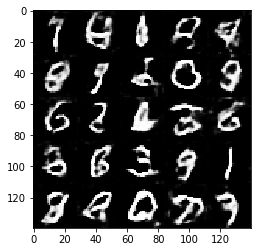

Epoch: 2/2 Discriminator Loss: 0.8738077282905579 Generator Loss: 1.5422358512878418
Epoch: 2/2 Discriminator Loss: 1.2488574981689453 Generator Loss: 0.6864193081855774
Epoch: 2/2 Discriminator Loss: 0.7192559838294983 Generator Loss: 1.6758222579956055
Epoch: 2/2 Discriminator Loss: 1.2610247135162354 Generator Loss: 0.589082658290863
Epoch: 2/2 Discriminator Loss: 0.7805662751197815 Generator Loss: 2.4372661113739014
Epoch: 2/2 Discriminator Loss: 0.7483392357826233 Generator Loss: 1.7325944900512695
Epoch: 2/2 Discriminator Loss: 0.6314796209335327 Generator Loss: 1.8614529371261597
Epoch: 2/2 Discriminator Loss: 0.7270098924636841 Generator Loss: 1.6753249168395996
Epoch: 2/2 Discriminator Loss: 0.8285163044929504 Generator Loss: 1.1323883533477783
Epoch: 2/2 Discriminator Loss: 0.889690637588501 Generator Loss: 1.9617996215820312


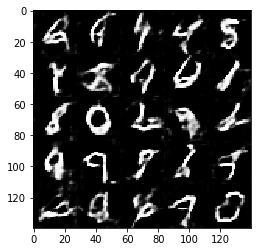

Epoch: 2/2 Discriminator Loss: 1.1925640106201172 Generator Loss: 1.9513505697250366
Epoch: 2/2 Discriminator Loss: 0.7899672985076904 Generator Loss: 1.6889195442199707
Epoch: 2/2 Discriminator Loss: 1.2185649871826172 Generator Loss: 3.286855936050415
Epoch: 2/2 Discriminator Loss: 0.9384691119194031 Generator Loss: 1.5196378231048584
Epoch: 2/2 Discriminator Loss: 1.1548118591308594 Generator Loss: 2.235963821411133
Epoch: 2/2 Discriminator Loss: 0.74953293800354 Generator Loss: 1.630568504333496
Epoch: 2/2 Discriminator Loss: 1.0776784420013428 Generator Loss: 1.8634240627288818
Epoch: 2/2 Discriminator Loss: 1.0597248077392578 Generator Loss: 0.9672386050224304
Epoch: 2/2 Discriminator Loss: 1.2514581680297852 Generator Loss: 1.0814259052276611
Epoch: 2/2 Discriminator Loss: 0.9777247309684753 Generator Loss: 2.283691883087158


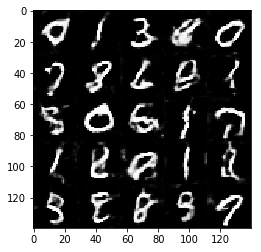

Epoch: 2/2 Discriminator Loss: 0.6918715238571167 Generator Loss: 1.581527590751648
Epoch: 2/2 Discriminator Loss: 1.083388328552246 Generator Loss: 1.3532477617263794
Epoch: 2/2 Discriminator Loss: 0.9023991823196411 Generator Loss: 1.4894988536834717
Epoch: 2/2 Discriminator Loss: 0.7836806178092957 Generator Loss: 0.8270301818847656
Epoch: 2/2 Discriminator Loss: 0.8576411008834839 Generator Loss: 2.0532732009887695
Epoch: 2/2 Discriminator Loss: 0.9891306757926941 Generator Loss: 2.6731672286987305
Epoch: 2/2 Discriminator Loss: 0.8382411003112793 Generator Loss: 1.2901036739349365
Epoch: 2/2 Discriminator Loss: 0.6373604536056519 Generator Loss: 2.6889190673828125
Epoch: 2/2 Discriminator Loss: 0.8564766049385071 Generator Loss: 1.4774363040924072
Epoch: 2/2 Discriminator Loss: 0.784866452217102 Generator Loss: 1.4869647026062012


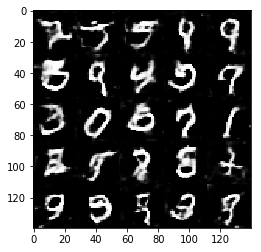

Epoch: 2/2 Discriminator Loss: 0.9451801180839539 Generator Loss: 1.9308229684829712
Epoch: 2/2 Discriminator Loss: 0.9585938453674316 Generator Loss: 2.444899797439575
Epoch: 2/2 Discriminator Loss: 0.5909255743026733 Generator Loss: 1.3939796686172485
Epoch: 2/2 Discriminator Loss: 0.7985708117485046 Generator Loss: 1.8896554708480835
Epoch: 2/2 Discriminator Loss: 0.9579309225082397 Generator Loss: 1.1075886487960815
Epoch: 2/2 Discriminator Loss: 0.7880004644393921 Generator Loss: 1.4694223403930664
Epoch: 2/2 Discriminator Loss: 1.0271155834197998 Generator Loss: 2.5512852668762207
Epoch: 2/2 Discriminator Loss: 0.7739197015762329 Generator Loss: 2.2011005878448486
Epoch: 2/2 Discriminator Loss: 1.2489590644836426 Generator Loss: 3.191039562225342
Epoch: 2/2 Discriminator Loss: 0.947494626045227 Generator Loss: 3.311553955078125


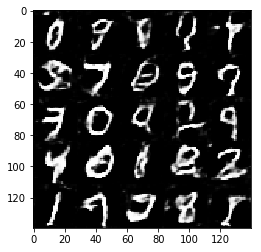

Epoch: 2/2 Discriminator Loss: 0.8377787470817566 Generator Loss: 1.3480839729309082
Epoch: 2/2 Discriminator Loss: 0.8425758481025696 Generator Loss: 1.9736268520355225
Epoch: 2/2 Discriminator Loss: 1.1028096675872803 Generator Loss: 0.7136358022689819
Epoch: 2/2 Discriminator Loss: 0.8582870960235596 Generator Loss: 1.4139931201934814
Epoch: 2/2 Discriminator Loss: 0.788583517074585 Generator Loss: 1.5178968906402588
Epoch: 2/2 Discriminator Loss: 0.783743679523468 Generator Loss: 2.431349277496338
Epoch: 2/2 Discriminator Loss: 0.81121826171875 Generator Loss: 1.6705001592636108
Epoch: 2/2 Discriminator Loss: 0.6720565557479858 Generator Loss: 2.2503437995910645
Epoch: 2/2 Discriminator Loss: 0.7572758197784424 Generator Loss: 2.012676239013672
Epoch: 2/2 Discriminator Loss: 0.883647620677948 Generator Loss: 1.6828514337539673


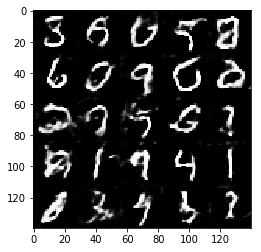

Epoch: 2/2 Discriminator Loss: 0.5483114719390869 Generator Loss: 1.6281704902648926
Epoch: 2/2 Discriminator Loss: 0.8644695281982422 Generator Loss: 1.692284107208252
Epoch: 2/2 Discriminator Loss: 0.7278867959976196 Generator Loss: 2.2129361629486084
Epoch: 2/2 Discriminator Loss: 1.0064194202423096 Generator Loss: 3.955076217651367
Epoch: 2/2 Discriminator Loss: 0.8935244679450989 Generator Loss: 2.5271406173706055
Epoch: 2/2 Discriminator Loss: 0.9220759868621826 Generator Loss: 2.4074525833129883
Epoch: 2/2 Discriminator Loss: 0.6642618179321289 Generator Loss: 2.2302913665771484
Epoch: 2/2 Discriminator Loss: 0.6120020151138306 Generator Loss: 3.023615837097168
Epoch: 2/2 Discriminator Loss: 1.1063578128814697 Generator Loss: 4.113717079162598
Epoch: 2/2 Discriminator Loss: 0.8838309049606323 Generator Loss: 1.7657208442687988


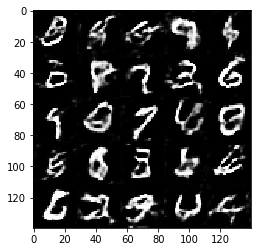

Epoch: 2/2 Discriminator Loss: 0.7540544271469116 Generator Loss: 1.2204591035842896
Epoch: 2/2 Discriminator Loss: 0.7758454084396362 Generator Loss: 1.4562702178955078
Epoch: 2/2 Discriminator Loss: 0.7820607423782349 Generator Loss: 0.6510168313980103
Epoch: 2/2 Discriminator Loss: 0.6950211524963379 Generator Loss: 2.8069887161254883
Epoch: 2/2 Discriminator Loss: 0.8297538161277771 Generator Loss: 2.4072508811950684
Epoch: 2/2 Discriminator Loss: 1.1292674541473389 Generator Loss: 2.133821964263916
Epoch: 2/2 Discriminator Loss: 0.489338755607605 Generator Loss: 2.3362317085266113
Epoch: 2/2 Discriminator Loss: 0.7043309211730957 Generator Loss: 1.3951616287231445
Epoch: 2/2 Discriminator Loss: 0.6999660730361938 Generator Loss: 1.821244716644287
Epoch: 2/2 Discriminator Loss: 0.840524435043335 Generator Loss: 2.9619011878967285


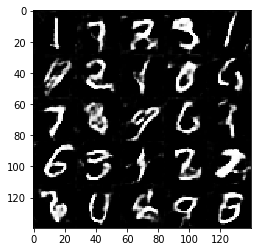

Epoch: 2/2 Discriminator Loss: 0.6147547960281372 Generator Loss: 1.7591452598571777
Epoch: 2/2 Discriminator Loss: 0.9578061103820801 Generator Loss: 2.594334125518799
Epoch: 2/2 Discriminator Loss: 1.2533113956451416 Generator Loss: 0.9516624212265015
Epoch: 2/2 Discriminator Loss: 0.856221616268158 Generator Loss: 2.3140761852264404
Epoch: 2/2 Discriminator Loss: 0.8307990431785583 Generator Loss: 1.3434001207351685
Epoch: 2/2 Discriminator Loss: 0.699971079826355 Generator Loss: 2.4783873558044434
Epoch: 2/2 Discriminator Loss: 0.8745051622390747 Generator Loss: 1.5286009311676025
Epoch: 2/2 Discriminator Loss: 0.8130344152450562 Generator Loss: 1.5763938426971436
Epoch: 2/2 Discriminator Loss: 0.6446374654769897 Generator Loss: 1.3100457191467285
Epoch: 2/2 Discriminator Loss: 0.7289559841156006 Generator Loss: 1.5880415439605713


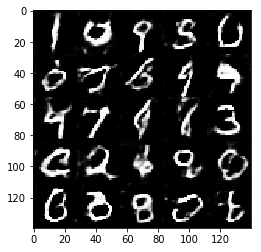

Epoch: 2/2 Discriminator Loss: 0.647027313709259 Generator Loss: 1.788766860961914
Epoch: 2/2 Discriminator Loss: 0.6782928705215454 Generator Loss: 2.503894805908203
Epoch: 2/2 Discriminator Loss: 0.6243245005607605 Generator Loss: 1.9995564222335815
Epoch: 2/2 Discriminator Loss: 0.7725750803947449 Generator Loss: 1.433309555053711
Epoch: 2/2 Discriminator Loss: 0.9498947262763977 Generator Loss: 1.242931604385376
Epoch: 2/2 Discriminator Loss: 0.8433428406715393 Generator Loss: 3.843461275100708
Epoch: 2/2 Discriminator Loss: 0.8806921243667603 Generator Loss: 2.2473955154418945
Epoch: 2/2 Discriminator Loss: 0.6923796534538269 Generator Loss: 2.5209412574768066
Epoch: 2/2 Discriminator Loss: 0.6532378196716309 Generator Loss: 1.6693115234375
Epoch: 2/2 Discriminator Loss: 0.5517781376838684 Generator Loss: 1.675728678703308


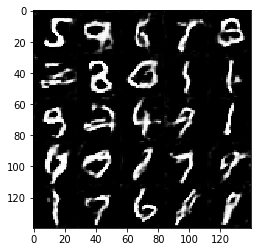

Epoch: 2/2 Discriminator Loss: 0.9178730845451355 Generator Loss: 1.3024933338165283
Epoch: 2/2 Discriminator Loss: 0.9733501672744751 Generator Loss: 1.2920656204223633
Epoch: 2/2 Discriminator Loss: 0.7011814713478088 Generator Loss: 1.6587154865264893
Epoch: 2/2 Discriminator Loss: 0.8029097318649292 Generator Loss: 1.2198753356933594
Epoch: 2/2 Discriminator Loss: 0.6268784999847412 Generator Loss: 3.156282424926758


In [12]:
batch_size = 32
z_dim = 100
learning_rate = 0.0005
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch: 1/2 Discriminator Loss: 0.9460440874099731 Generator Loss: 2.3042988777160645
Epoch: 1/2 Discriminator Loss: 1.8139829635620117 Generator Loss: 2.1162109375
Epoch: 1/2 Discriminator Loss: 1.9752377271652222 Generator Loss: 0.9932956695556641
Epoch: 1/2 Discriminator Loss: 1.9784797430038452 Generator Loss: 0.5090080499649048
Epoch: 1/2 Discriminator Loss: 1.3638492822647095 Generator Loss: 2.0168697834014893
Epoch: 1/2 Discriminator Loss: 0.823479413986206 Generator Loss: 2.1556930541992188
Epoch: 1/2 Discriminator Loss: 0.8851373195648193 Generator Loss: 1.756004810333252
Epoch: 1/2 Discriminator Loss: 1.115199327468872 Generator Loss: 0.9934808015823364
Epoch: 1/2 Discriminator Loss: 0.6028454303741455 Generator Loss: 4.018949508666992
Epoch: 1/2 Discriminator Loss: 1.726462721824646 Generator Loss: 0.5380561947822571


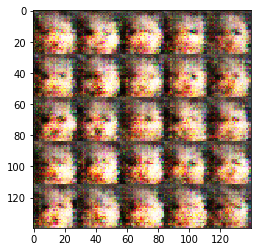

Epoch: 1/2 Discriminator Loss: 1.021604061126709 Generator Loss: 1.2969255447387695
Epoch: 1/2 Discriminator Loss: 1.1293892860412598 Generator Loss: 2.829901695251465
Epoch: 1/2 Discriminator Loss: 1.1679208278656006 Generator Loss: 2.61077880859375
Epoch: 1/2 Discriminator Loss: 0.9795941710472107 Generator Loss: 1.1757328510284424
Epoch: 1/2 Discriminator Loss: 0.7134943008422852 Generator Loss: 1.8702976703643799
Epoch: 1/2 Discriminator Loss: 1.1943917274475098 Generator Loss: 0.9743534326553345
Epoch: 1/2 Discriminator Loss: 1.5739128589630127 Generator Loss: 0.87705397605896
Epoch: 1/2 Discriminator Loss: 1.7001581192016602 Generator Loss: 0.5748404860496521
Epoch: 1/2 Discriminator Loss: 1.0900226831436157 Generator Loss: 1.9057176113128662
Epoch: 1/2 Discriminator Loss: 1.9547927379608154 Generator Loss: 0.817375898361206


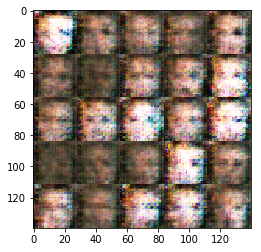

Epoch: 1/2 Discriminator Loss: 0.8346681594848633 Generator Loss: 1.6680963039398193
Epoch: 1/2 Discriminator Loss: 1.837680459022522 Generator Loss: 0.7112544775009155
Epoch: 1/2 Discriminator Loss: 2.0007290840148926 Generator Loss: 0.8403967022895813
Epoch: 1/2 Discriminator Loss: 0.8146247863769531 Generator Loss: 1.2387104034423828
Epoch: 1/2 Discriminator Loss: 2.187096118927002 Generator Loss: 0.5653785467147827
Epoch: 1/2 Discriminator Loss: 1.575423002243042 Generator Loss: 0.44610536098480225
Epoch: 1/2 Discriminator Loss: 0.8061478137969971 Generator Loss: 1.4025094509124756
Epoch: 1/2 Discriminator Loss: 0.765648365020752 Generator Loss: 1.8694474697113037
Epoch: 1/2 Discriminator Loss: 1.04823637008667 Generator Loss: 1.1857610940933228
Epoch: 1/2 Discriminator Loss: 1.398970365524292 Generator Loss: 0.7853888273239136


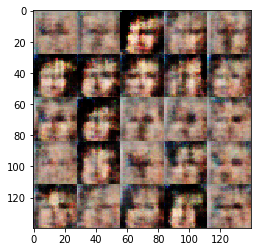

Epoch: 1/2 Discriminator Loss: 1.2837954759597778 Generator Loss: 0.9661429524421692
Epoch: 1/2 Discriminator Loss: 0.7778340578079224 Generator Loss: 1.7270488739013672
Epoch: 1/2 Discriminator Loss: 0.7462895512580872 Generator Loss: 1.6926603317260742
Epoch: 1/2 Discriminator Loss: 1.1977694034576416 Generator Loss: 1.0718095302581787
Epoch: 1/2 Discriminator Loss: 1.5074795484542847 Generator Loss: 1.3708423376083374
Epoch: 1/2 Discriminator Loss: 0.6674611568450928 Generator Loss: 1.9379234313964844
Epoch: 1/2 Discriminator Loss: 1.422972559928894 Generator Loss: 0.8688852787017822
Epoch: 1/2 Discriminator Loss: 1.0767854452133179 Generator Loss: 1.0928012132644653
Epoch: 1/2 Discriminator Loss: 1.1278109550476074 Generator Loss: 1.2925935983657837
Epoch: 1/2 Discriminator Loss: 1.304538607597351 Generator Loss: 1.2598921060562134


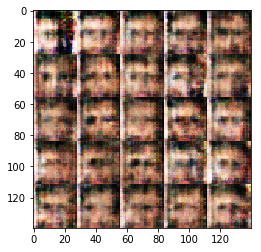

Epoch: 1/2 Discriminator Loss: 1.2015902996063232 Generator Loss: 1.2434625625610352
Epoch: 1/2 Discriminator Loss: 1.2733347415924072 Generator Loss: 0.8091722726821899
Epoch: 1/2 Discriminator Loss: 1.5423483848571777 Generator Loss: 0.8629216551780701
Epoch: 1/2 Discriminator Loss: 1.0935983657836914 Generator Loss: 1.2402387857437134
Epoch: 1/2 Discriminator Loss: 1.146706223487854 Generator Loss: 1.0306907892227173
Epoch: 1/2 Discriminator Loss: 1.6483482122421265 Generator Loss: 0.6367099285125732
Epoch: 1/2 Discriminator Loss: 1.2371313571929932 Generator Loss: 0.8913639783859253
Epoch: 1/2 Discriminator Loss: 1.3202030658721924 Generator Loss: 0.8428338766098022
Epoch: 1/2 Discriminator Loss: 1.3996760845184326 Generator Loss: 0.9476930499076843
Epoch: 1/2 Discriminator Loss: 1.4043625593185425 Generator Loss: 1.2610790729522705


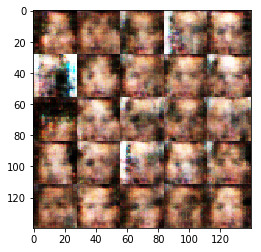

Epoch: 1/2 Discriminator Loss: 1.5076112747192383 Generator Loss: 0.6782893538475037
Epoch: 1/2 Discriminator Loss: 1.4219262599945068 Generator Loss: 0.8581255674362183
Epoch: 1/2 Discriminator Loss: 1.499443769454956 Generator Loss: 1.1349008083343506
Epoch: 1/2 Discriminator Loss: 1.3587349653244019 Generator Loss: 0.7833026647567749
Epoch: 1/2 Discriminator Loss: 1.2603530883789062 Generator Loss: 0.9133014678955078
Epoch: 1/2 Discriminator Loss: 1.1181938648223877 Generator Loss: 1.1688023805618286
Epoch: 1/2 Discriminator Loss: 1.6563878059387207 Generator Loss: 0.9244906306266785
Epoch: 1/2 Discriminator Loss: 1.343045949935913 Generator Loss: 0.7209442853927612
Epoch: 1/2 Discriminator Loss: 1.8129185438156128 Generator Loss: 0.6665418148040771
Epoch: 1/2 Discriminator Loss: 1.2584270238876343 Generator Loss: 1.1083221435546875


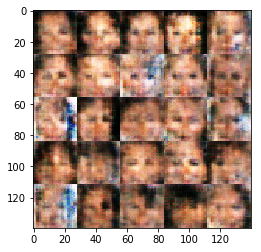

Epoch: 1/2 Discriminator Loss: 1.616091251373291 Generator Loss: 0.48106738924980164
Epoch: 1/2 Discriminator Loss: 1.0145965814590454 Generator Loss: 0.9045995473861694
Epoch: 1/2 Discriminator Loss: 1.2348321676254272 Generator Loss: 1.0825773477554321
Epoch: 1/2 Discriminator Loss: 1.3059483766555786 Generator Loss: 1.0672595500946045
Epoch: 1/2 Discriminator Loss: 1.267271637916565 Generator Loss: 0.9131679534912109
Epoch: 1/2 Discriminator Loss: 1.6104227304458618 Generator Loss: 0.6948156356811523
Epoch: 1/2 Discriminator Loss: 1.3387954235076904 Generator Loss: 0.9359984993934631
Epoch: 1/2 Discriminator Loss: 1.3759686946868896 Generator Loss: 0.7382140755653381
Epoch: 1/2 Discriminator Loss: 1.3137801885604858 Generator Loss: 1.3530038595199585
Epoch: 1/2 Discriminator Loss: 1.028510332107544 Generator Loss: 0.6973156929016113


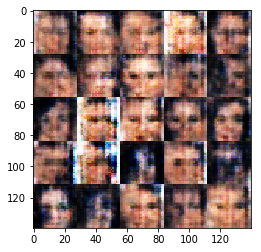

Epoch: 1/2 Discriminator Loss: 1.5780223608016968 Generator Loss: 0.6177055835723877
Epoch: 1/2 Discriminator Loss: 1.2864089012145996 Generator Loss: 1.09827721118927
Epoch: 1/2 Discriminator Loss: 1.576740026473999 Generator Loss: 1.1169390678405762
Epoch: 1/2 Discriminator Loss: 1.3174068927764893 Generator Loss: 0.6902238726615906
Epoch: 1/2 Discriminator Loss: 1.3484218120574951 Generator Loss: 0.7085843086242676
Epoch: 1/2 Discriminator Loss: 1.3829751014709473 Generator Loss: 0.909600019454956
Epoch: 1/2 Discriminator Loss: 1.5980522632598877 Generator Loss: 0.6297208070755005
Epoch: 1/2 Discriminator Loss: 1.5239379405975342 Generator Loss: 0.9249875545501709
Epoch: 1/2 Discriminator Loss: 1.3442400693893433 Generator Loss: 1.1330007314682007
Epoch: 1/2 Discriminator Loss: 1.5055657625198364 Generator Loss: 0.8777049779891968


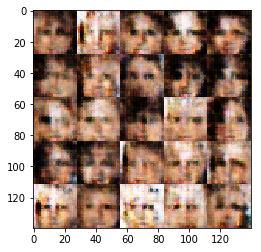

Epoch: 1/2 Discriminator Loss: 1.0790178775787354 Generator Loss: 0.849831223487854
Epoch: 1/2 Discriminator Loss: 1.223854660987854 Generator Loss: 0.9558955430984497
Epoch: 1/2 Discriminator Loss: 1.4136152267456055 Generator Loss: 1.1239821910858154
Epoch: 1/2 Discriminator Loss: 1.3193557262420654 Generator Loss: 0.9085462093353271
Epoch: 1/2 Discriminator Loss: 1.6086974143981934 Generator Loss: 0.8205769062042236
Epoch: 1/2 Discriminator Loss: 1.386099100112915 Generator Loss: 0.7442167401313782
Epoch: 1/2 Discriminator Loss: 1.3620967864990234 Generator Loss: 1.1319471597671509
Epoch: 1/2 Discriminator Loss: 1.2231606245040894 Generator Loss: 1.0747675895690918
Epoch: 1/2 Discriminator Loss: 1.4668428897857666 Generator Loss: 1.063456416130066
Epoch: 1/2 Discriminator Loss: 1.4952378273010254 Generator Loss: 0.774412989616394


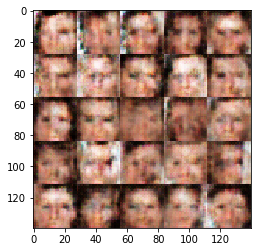

Epoch: 1/2 Discriminator Loss: 1.3519127368927002 Generator Loss: 1.0575535297393799
Epoch: 1/2 Discriminator Loss: 1.673980951309204 Generator Loss: 0.5915200114250183
Epoch: 1/2 Discriminator Loss: 1.8668498992919922 Generator Loss: 0.6379939317703247
Epoch: 1/2 Discriminator Loss: 1.6343069076538086 Generator Loss: 0.7609826922416687
Epoch: 1/2 Discriminator Loss: 1.450516939163208 Generator Loss: 0.6903630495071411
Epoch: 1/2 Discriminator Loss: 1.270506501197815 Generator Loss: 0.8524201512336731
Epoch: 1/2 Discriminator Loss: 1.376383900642395 Generator Loss: 0.8131948113441467
Epoch: 1/2 Discriminator Loss: 1.3307578563690186 Generator Loss: 0.922895610332489
Epoch: 1/2 Discriminator Loss: 1.3416081666946411 Generator Loss: 0.9338025450706482
Epoch: 1/2 Discriminator Loss: 1.4311391115188599 Generator Loss: 0.8391862511634827


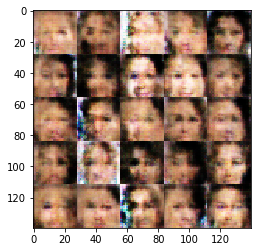

Epoch: 1/2 Discriminator Loss: 1.4033623933792114 Generator Loss: 0.8623074889183044
Epoch: 1/2 Discriminator Loss: 1.3481285572052002 Generator Loss: 0.843199610710144
Epoch: 1/2 Discriminator Loss: 1.4401177167892456 Generator Loss: 1.0166590213775635
Epoch: 1/2 Discriminator Loss: 1.4396412372589111 Generator Loss: 0.9266729950904846
Epoch: 1/2 Discriminator Loss: 1.4028027057647705 Generator Loss: 0.9032654762268066
Epoch: 1/2 Discriminator Loss: 1.2002454996109009 Generator Loss: 0.7499434947967529
Epoch: 1/2 Discriminator Loss: 1.4096349477767944 Generator Loss: 0.9783962965011597
Epoch: 1/2 Discriminator Loss: 1.2763419151306152 Generator Loss: 1.296555519104004
Epoch: 1/2 Discriminator Loss: 1.281057596206665 Generator Loss: 1.117720365524292
Epoch: 1/2 Discriminator Loss: 1.282268762588501 Generator Loss: 0.774075448513031


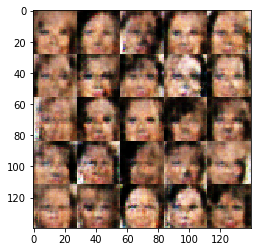

Epoch: 1/2 Discriminator Loss: 1.3139992952346802 Generator Loss: 0.7399762868881226
Epoch: 1/2 Discriminator Loss: 1.107629418373108 Generator Loss: 1.0480787754058838
Epoch: 1/2 Discriminator Loss: 1.481751799583435 Generator Loss: 1.1397497653961182
Epoch: 1/2 Discriminator Loss: 1.2556259632110596 Generator Loss: 1.0872392654418945
Epoch: 1/2 Discriminator Loss: 1.430656909942627 Generator Loss: 0.6326714754104614
Epoch: 1/2 Discriminator Loss: 1.3526043891906738 Generator Loss: 0.8129152059555054
Epoch: 1/2 Discriminator Loss: 1.3387885093688965 Generator Loss: 1.1165201663970947
Epoch: 1/2 Discriminator Loss: 1.2196639776229858 Generator Loss: 0.839518129825592
Epoch: 1/2 Discriminator Loss: 1.4494894742965698 Generator Loss: 0.8445689678192139
Epoch: 1/2 Discriminator Loss: 1.4712014198303223 Generator Loss: 0.9427091479301453


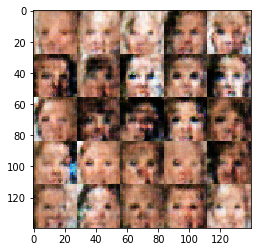

Epoch: 1/2 Discriminator Loss: 1.2462213039398193 Generator Loss: 0.8760762214660645
Epoch: 1/2 Discriminator Loss: 1.6883313655853271 Generator Loss: 0.7208681106567383
Epoch: 1/2 Discriminator Loss: 1.4363932609558105 Generator Loss: 0.7323633432388306
Epoch: 1/2 Discriminator Loss: 1.3262286186218262 Generator Loss: 0.8206241130828857
Epoch: 1/2 Discriminator Loss: 1.362768530845642 Generator Loss: 1.096254825592041
Epoch: 1/2 Discriminator Loss: 1.1465965509414673 Generator Loss: 1.0845037698745728
Epoch: 1/2 Discriminator Loss: 1.3107554912567139 Generator Loss: 1.0915982723236084
Epoch: 1/2 Discriminator Loss: 1.1580300331115723 Generator Loss: 0.7671564817428589
Epoch: 1/2 Discriminator Loss: 1.2664227485656738 Generator Loss: 0.9617257118225098
Epoch: 1/2 Discriminator Loss: 1.385901689529419 Generator Loss: 0.6728202104568481


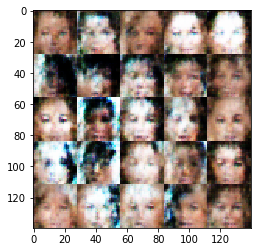

Epoch: 1/2 Discriminator Loss: 1.2857394218444824 Generator Loss: 0.9130071401596069
Epoch: 1/2 Discriminator Loss: 1.1803619861602783 Generator Loss: 0.9319807291030884
Epoch: 1/2 Discriminator Loss: 1.4785947799682617 Generator Loss: 0.7562904357910156
Epoch: 1/2 Discriminator Loss: 1.4558361768722534 Generator Loss: 0.7571411728858948
Epoch: 1/2 Discriminator Loss: 1.625942349433899 Generator Loss: 0.7515193223953247
Epoch: 1/2 Discriminator Loss: 1.5237236022949219 Generator Loss: 0.8114550113677979
Epoch: 1/2 Discriminator Loss: 1.2868101596832275 Generator Loss: 0.8416128158569336
Epoch: 1/2 Discriminator Loss: 1.6288481950759888 Generator Loss: 0.5180025100708008
Epoch: 1/2 Discriminator Loss: 1.4089229106903076 Generator Loss: 0.6598019599914551
Epoch: 1/2 Discriminator Loss: 1.065114140510559 Generator Loss: 1.2677431106567383


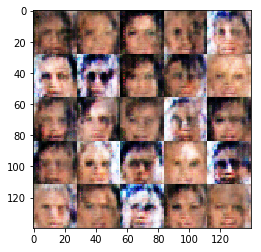

Epoch: 1/2 Discriminator Loss: 1.3035285472869873 Generator Loss: 0.7937170267105103
Epoch: 1/2 Discriminator Loss: 1.2850910425186157 Generator Loss: 0.8014174103736877
Epoch: 1/2 Discriminator Loss: 1.3807281255722046 Generator Loss: 0.7045239210128784
Epoch: 1/2 Discriminator Loss: 1.4228837490081787 Generator Loss: 0.7888091802597046
Epoch: 1/2 Discriminator Loss: 1.3965680599212646 Generator Loss: 0.9665177464485168
Epoch: 1/2 Discriminator Loss: 1.3594202995300293 Generator Loss: 0.5827234983444214
Epoch: 1/2 Discriminator Loss: 1.3896204233169556 Generator Loss: 0.7489298582077026
Epoch: 1/2 Discriminator Loss: 1.1622703075408936 Generator Loss: 0.9696640968322754
Epoch: 1/2 Discriminator Loss: 1.3938289880752563 Generator Loss: 1.150399923324585
Epoch: 1/2 Discriminator Loss: 1.2618217468261719 Generator Loss: 0.7352368831634521


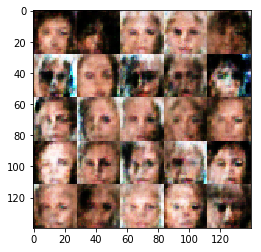

Epoch: 1/2 Discriminator Loss: 1.5626391172409058 Generator Loss: 0.6726639270782471
Epoch: 1/2 Discriminator Loss: 1.3174636363983154 Generator Loss: 0.8617898225784302
Epoch: 1/2 Discriminator Loss: 1.292565941810608 Generator Loss: 0.743299663066864
Epoch: 1/2 Discriminator Loss: 1.483088731765747 Generator Loss: 0.957700252532959
Epoch: 1/2 Discriminator Loss: 1.4940255880355835 Generator Loss: 0.7798281311988831
Epoch: 1/2 Discriminator Loss: 1.3191208839416504 Generator Loss: 0.9046182036399841
Epoch: 1/2 Discriminator Loss: 1.1470630168914795 Generator Loss: 0.976440966129303
Epoch: 1/2 Discriminator Loss: 1.6468498706817627 Generator Loss: 0.9346827268600464
Epoch: 1/2 Discriminator Loss: 1.2695239782333374 Generator Loss: 1.0254614353179932
Epoch: 1/2 Discriminator Loss: 1.6891026496887207 Generator Loss: 1.1692143678665161


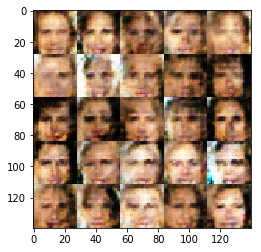

Epoch: 1/2 Discriminator Loss: 1.0576863288879395 Generator Loss: 1.079672932624817
Epoch: 1/2 Discriminator Loss: 1.05352783203125 Generator Loss: 1.192763090133667
Epoch: 1/2 Discriminator Loss: 1.4528142213821411 Generator Loss: 1.1802685260772705
Epoch: 1/2 Discriminator Loss: 1.2454148530960083 Generator Loss: 0.8252496123313904
Epoch: 1/2 Discriminator Loss: 1.3474812507629395 Generator Loss: 1.1941101551055908
Epoch: 1/2 Discriminator Loss: 1.2533365488052368 Generator Loss: 1.0107192993164062
Epoch: 1/2 Discriminator Loss: 1.2915531396865845 Generator Loss: 0.8335896730422974
Epoch: 1/2 Discriminator Loss: 1.2540607452392578 Generator Loss: 1.089436650276184
Epoch: 1/2 Discriminator Loss: 1.2603302001953125 Generator Loss: 1.2426280975341797
Epoch: 1/2 Discriminator Loss: 1.3622558116912842 Generator Loss: 0.8799494504928589


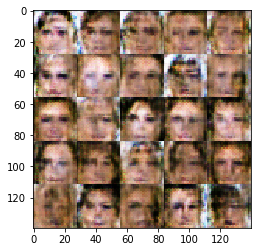

Epoch: 1/2 Discriminator Loss: 1.3614871501922607 Generator Loss: 0.7358623743057251
Epoch: 1/2 Discriminator Loss: 1.6149654388427734 Generator Loss: 0.8234012722969055
Epoch: 1/2 Discriminator Loss: 1.2230862379074097 Generator Loss: 0.8128147721290588
Epoch: 1/2 Discriminator Loss: 1.187126636505127 Generator Loss: 1.0039938688278198
Epoch: 1/2 Discriminator Loss: 1.2278201580047607 Generator Loss: 1.2653203010559082
Epoch: 1/2 Discriminator Loss: 1.2713441848754883 Generator Loss: 1.0377516746520996
Epoch: 1/2 Discriminator Loss: 1.5968296527862549 Generator Loss: 0.8535100221633911
Epoch: 1/2 Discriminator Loss: 1.6864652633666992 Generator Loss: 0.4794943928718567
Epoch: 1/2 Discriminator Loss: 1.5564250946044922 Generator Loss: 1.107617974281311
Epoch: 1/2 Discriminator Loss: 1.2872037887573242 Generator Loss: 1.0621628761291504


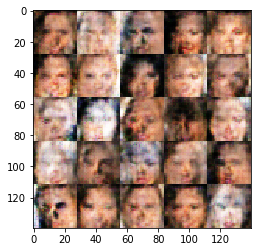

Epoch: 1/2 Discriminator Loss: 1.3858697414398193 Generator Loss: 0.823928952217102
Epoch: 1/2 Discriminator Loss: 1.0648131370544434 Generator Loss: 1.0209985971450806
Epoch: 1/2 Discriminator Loss: 1.738114595413208 Generator Loss: 0.6012428998947144
Epoch: 1/2 Discriminator Loss: 1.2246757745742798 Generator Loss: 0.9923596978187561
Epoch: 1/2 Discriminator Loss: 1.2024221420288086 Generator Loss: 0.9579262733459473
Epoch: 1/2 Discriminator Loss: 1.4542272090911865 Generator Loss: 0.5589021444320679
Epoch: 1/2 Discriminator Loss: 1.2886886596679688 Generator Loss: 0.8873196840286255
Epoch: 1/2 Discriminator Loss: 1.516134262084961 Generator Loss: 0.9750811457633972
Epoch: 1/2 Discriminator Loss: 1.4403798580169678 Generator Loss: 0.7293376326560974
Epoch: 1/2 Discriminator Loss: 1.481022834777832 Generator Loss: 0.8120428323745728


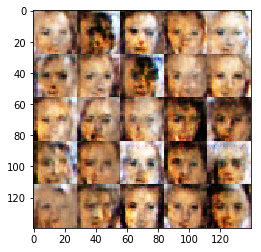

Epoch: 1/2 Discriminator Loss: 1.2106770277023315 Generator Loss: 1.1383360624313354
Epoch: 1/2 Discriminator Loss: 1.7115119695663452 Generator Loss: 0.6881746053695679
Epoch: 1/2 Discriminator Loss: 1.4183067083358765 Generator Loss: 0.6604008078575134
Epoch: 1/2 Discriminator Loss: 1.1405205726623535 Generator Loss: 1.0644346475601196
Epoch: 1/2 Discriminator Loss: 1.449920654296875 Generator Loss: 0.798737645149231
Epoch: 1/2 Discriminator Loss: 1.1690738201141357 Generator Loss: 0.9993056058883667
Epoch: 1/2 Discriminator Loss: 1.2789043188095093 Generator Loss: 0.7956112027168274
Epoch: 1/2 Discriminator Loss: 1.0718542337417603 Generator Loss: 1.010850429534912
Epoch: 1/2 Discriminator Loss: 1.2078728675842285 Generator Loss: 1.1879446506500244
Epoch: 1/2 Discriminator Loss: 1.5078470706939697 Generator Loss: 0.7592393159866333


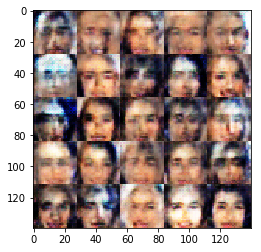

Epoch: 1/2 Discriminator Loss: 1.4593534469604492 Generator Loss: 0.5997689962387085
Epoch: 1/2 Discriminator Loss: 1.3311853408813477 Generator Loss: 0.7111431360244751
Epoch: 1/2 Discriminator Loss: 1.2035988569259644 Generator Loss: 1.0342233180999756
Epoch: 1/2 Discriminator Loss: 1.2492690086364746 Generator Loss: 0.8226855993270874
Epoch: 1/2 Discriminator Loss: 1.561964750289917 Generator Loss: 0.9001651406288147
Epoch: 1/2 Discriminator Loss: 1.1317572593688965 Generator Loss: 1.0112680196762085
Epoch: 1/2 Discriminator Loss: 1.286323070526123 Generator Loss: 0.9022700786590576
Epoch: 1/2 Discriminator Loss: 1.402864694595337 Generator Loss: 1.0513465404510498
Epoch: 1/2 Discriminator Loss: 1.358886480331421 Generator Loss: 0.9443038702011108
Epoch: 1/2 Discriminator Loss: 1.3338651657104492 Generator Loss: 0.8611920475959778


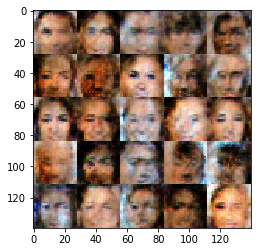

Epoch: 1/2 Discriminator Loss: 1.3299906253814697 Generator Loss: 0.7581961154937744
Epoch: 1/2 Discriminator Loss: 1.2802153825759888 Generator Loss: 0.881422758102417
Epoch: 1/2 Discriminator Loss: 1.3458459377288818 Generator Loss: 0.6879413723945618
Epoch: 1/2 Discriminator Loss: 1.4756906032562256 Generator Loss: 0.8545646667480469
Epoch: 1/2 Discriminator Loss: 1.49760901927948 Generator Loss: 0.8639869093894958
Epoch: 1/2 Discriminator Loss: 1.3212649822235107 Generator Loss: 0.7636415362358093
Epoch: 1/2 Discriminator Loss: 1.3832045793533325 Generator Loss: 1.0217840671539307
Epoch: 1/2 Discriminator Loss: 1.2918192148208618 Generator Loss: 1.1823657751083374
Epoch: 1/2 Discriminator Loss: 1.5114150047302246 Generator Loss: 1.0192018747329712
Epoch: 1/2 Discriminator Loss: 1.26291823387146 Generator Loss: 0.6401149034500122


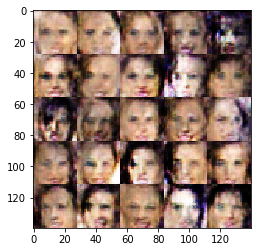

Epoch: 1/2 Discriminator Loss: 1.1132409572601318 Generator Loss: 0.7488688230514526
Epoch: 1/2 Discriminator Loss: 1.2471840381622314 Generator Loss: 0.9442753791809082
Epoch: 1/2 Discriminator Loss: 1.3296566009521484 Generator Loss: 0.7555569410324097
Epoch: 1/2 Discriminator Loss: 1.2329564094543457 Generator Loss: 0.9551413059234619
Epoch: 1/2 Discriminator Loss: 1.3131589889526367 Generator Loss: 0.9720335006713867
Epoch: 1/2 Discriminator Loss: 1.381415843963623 Generator Loss: 1.1802678108215332
Epoch: 1/2 Discriminator Loss: 1.3330388069152832 Generator Loss: 0.8977663516998291
Epoch: 1/2 Discriminator Loss: 1.3082797527313232 Generator Loss: 0.7399717569351196
Epoch: 1/2 Discriminator Loss: 1.5023764371871948 Generator Loss: 1.032603144645691
Epoch: 1/2 Discriminator Loss: 1.1772046089172363 Generator Loss: 0.8414643406867981


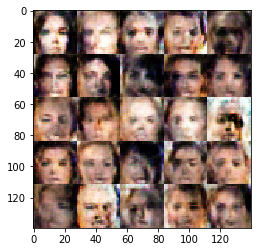

Epoch: 1/2 Discriminator Loss: 1.477839469909668 Generator Loss: 0.8635866641998291
Epoch: 1/2 Discriminator Loss: 1.2829346656799316 Generator Loss: 0.9005627632141113
Epoch: 1/2 Discriminator Loss: 1.481879472732544 Generator Loss: 0.7761977314949036
Epoch: 1/2 Discriminator Loss: 1.3610965013504028 Generator Loss: 0.7026820182800293
Epoch: 1/2 Discriminator Loss: 1.3469431400299072 Generator Loss: 0.7993638515472412
Epoch: 1/2 Discriminator Loss: 1.3766870498657227 Generator Loss: 0.9576511383056641
Epoch: 1/2 Discriminator Loss: 1.2670350074768066 Generator Loss: 0.9834662079811096
Epoch: 1/2 Discriminator Loss: 1.472360372543335 Generator Loss: 0.9920307397842407
Epoch: 1/2 Discriminator Loss: 1.3815834522247314 Generator Loss: 0.7170466780662537
Epoch: 1/2 Discriminator Loss: 1.2817285060882568 Generator Loss: 1.0818666219711304


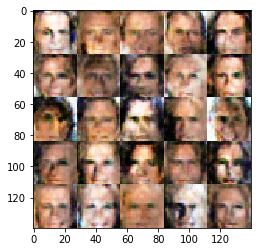

Epoch: 1/2 Discriminator Loss: 1.3964285850524902 Generator Loss: 0.7931333780288696
Epoch: 1/2 Discriminator Loss: 1.3743040561676025 Generator Loss: 0.8889565467834473
Epoch: 1/2 Discriminator Loss: 1.4427109956741333 Generator Loss: 1.1031125783920288
Epoch: 1/2 Discriminator Loss: 1.2283556461334229 Generator Loss: 0.8325729370117188
Epoch: 1/2 Discriminator Loss: 1.1941012144088745 Generator Loss: 0.9463627338409424
Epoch: 1/2 Discriminator Loss: 1.2129970788955688 Generator Loss: 0.8408701419830322
Epoch: 1/2 Discriminator Loss: 1.5501055717468262 Generator Loss: 1.0213699340820312
Epoch: 1/2 Discriminator Loss: 1.529651165008545 Generator Loss: 0.7880129814147949
Epoch: 1/2 Discriminator Loss: 1.3321056365966797 Generator Loss: 0.9950286746025085
Epoch: 1/2 Discriminator Loss: 1.4218100309371948 Generator Loss: 0.7370022535324097


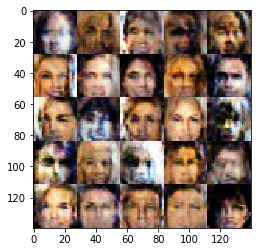

Epoch: 1/2 Discriminator Loss: 1.404026985168457 Generator Loss: 0.9715268015861511
Epoch: 1/2 Discriminator Loss: 1.2830660343170166 Generator Loss: 0.9354379177093506
Epoch: 1/2 Discriminator Loss: 1.3073532581329346 Generator Loss: 1.0139065980911255
Epoch: 1/2 Discriminator Loss: 1.343269944190979 Generator Loss: 0.6748307943344116
Epoch: 1/2 Discriminator Loss: 1.4485912322998047 Generator Loss: 0.8606469631195068
Epoch: 1/2 Discriminator Loss: 1.3659782409667969 Generator Loss: 0.8077821731567383
Epoch: 1/2 Discriminator Loss: 1.22230064868927 Generator Loss: 0.9750751256942749
Epoch: 1/2 Discriminator Loss: 1.4353444576263428 Generator Loss: 0.7802197337150574
Epoch: 1/2 Discriminator Loss: 1.5997040271759033 Generator Loss: 0.7179229259490967
Epoch: 1/2 Discriminator Loss: 1.3830524682998657 Generator Loss: 0.7757843732833862


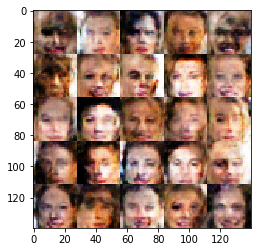

Epoch: 1/2 Discriminator Loss: 1.1896072626113892 Generator Loss: 1.2713890075683594
Epoch: 1/2 Discriminator Loss: 1.2376351356506348 Generator Loss: 0.8632042407989502
Epoch: 1/2 Discriminator Loss: 1.3746123313903809 Generator Loss: 0.8698325157165527
Epoch: 1/2 Discriminator Loss: 1.3565831184387207 Generator Loss: 0.8646703958511353
Epoch: 1/2 Discriminator Loss: 1.2287570238113403 Generator Loss: 1.239655613899231
Epoch: 1/2 Discriminator Loss: 1.4015593528747559 Generator Loss: 0.8997588157653809
Epoch: 1/2 Discriminator Loss: 1.1670093536376953 Generator Loss: 0.8209477066993713
Epoch: 1/2 Discriminator Loss: 1.3366658687591553 Generator Loss: 0.8767275214195251
Epoch: 1/2 Discriminator Loss: 1.342139720916748 Generator Loss: 1.1089599132537842
Epoch: 1/2 Discriminator Loss: 1.3429715633392334 Generator Loss: 0.6983681917190552


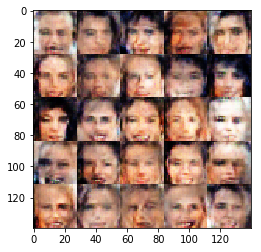

Epoch: 1/2 Discriminator Loss: 1.3346846103668213 Generator Loss: 0.783494770526886
Epoch: 1/2 Discriminator Loss: 1.3687355518341064 Generator Loss: 0.9296791553497314
Epoch: 1/2 Discriminator Loss: 1.2380428314208984 Generator Loss: 0.8943701982498169
Epoch: 1/2 Discriminator Loss: 1.2112534046173096 Generator Loss: 1.2499558925628662
Epoch: 1/2 Discriminator Loss: 1.1887626647949219 Generator Loss: 1.1336175203323364
Epoch: 1/2 Discriminator Loss: 1.2091219425201416 Generator Loss: 0.8620367050170898
Epoch: 1/2 Discriminator Loss: 1.3355618715286255 Generator Loss: 0.9035161137580872
Epoch: 1/2 Discriminator Loss: 1.3137292861938477 Generator Loss: 0.7335237264633179
Epoch: 1/2 Discriminator Loss: 1.4044101238250732 Generator Loss: 1.0254523754119873
Epoch: 1/2 Discriminator Loss: 1.295403003692627 Generator Loss: 1.0870716571807861


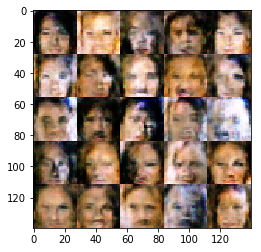

Epoch: 1/2 Discriminator Loss: 1.2938247919082642 Generator Loss: 0.7475557327270508
Epoch: 1/2 Discriminator Loss: 1.3326904773712158 Generator Loss: 0.7664345502853394
Epoch: 1/2 Discriminator Loss: 1.3369181156158447 Generator Loss: 0.8126577734947205
Epoch: 1/2 Discriminator Loss: 1.2603719234466553 Generator Loss: 0.9424588084220886
Epoch: 1/2 Discriminator Loss: 1.327678918838501 Generator Loss: 0.9032585024833679
Epoch: 1/2 Discriminator Loss: 1.2839202880859375 Generator Loss: 0.8766550421714783
Epoch: 1/2 Discriminator Loss: 1.4431838989257812 Generator Loss: 0.5999148488044739
Epoch: 1/2 Discriminator Loss: 1.4739665985107422 Generator Loss: 0.659990668296814
Epoch: 1/2 Discriminator Loss: 1.3629405498504639 Generator Loss: 0.9101022481918335
Epoch: 1/2 Discriminator Loss: 1.1328275203704834 Generator Loss: 1.0187593698501587


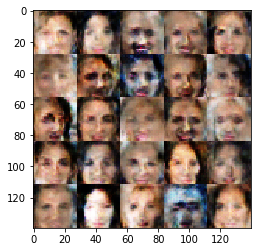

Epoch: 1/2 Discriminator Loss: 1.2303173542022705 Generator Loss: 0.9999219179153442
Epoch: 1/2 Discriminator Loss: 1.2128208875656128 Generator Loss: 0.9689669013023376
Epoch: 1/2 Discriminator Loss: 1.2726144790649414 Generator Loss: 1.2992212772369385
Epoch: 1/2 Discriminator Loss: 1.3647258281707764 Generator Loss: 0.8987745046615601
Epoch: 1/2 Discriminator Loss: 1.3575388193130493 Generator Loss: 1.021196961402893
Epoch: 1/2 Discriminator Loss: 1.4145894050598145 Generator Loss: 1.0160276889801025
Epoch: 1/2 Discriminator Loss: 1.3654296398162842 Generator Loss: 1.2054892778396606
Epoch: 1/2 Discriminator Loss: 1.3573660850524902 Generator Loss: 1.1376844644546509
Epoch: 1/2 Discriminator Loss: 1.1180033683776855 Generator Loss: 1.18935227394104
Epoch: 1/2 Discriminator Loss: 1.3462646007537842 Generator Loss: 0.8200106620788574


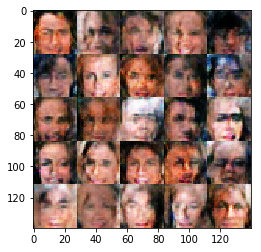

Epoch: 1/2 Discriminator Loss: 1.2686593532562256 Generator Loss: 1.1516554355621338
Epoch: 1/2 Discriminator Loss: 1.304328203201294 Generator Loss: 1.141087293624878
Epoch: 1/2 Discriminator Loss: 1.4289014339447021 Generator Loss: 0.9822062849998474
Epoch: 1/2 Discriminator Loss: 1.3662610054016113 Generator Loss: 0.8800932168960571
Epoch: 1/2 Discriminator Loss: 1.0757865905761719 Generator Loss: 1.1227405071258545
Epoch: 1/2 Discriminator Loss: 1.2313069105148315 Generator Loss: 1.099247694015503
Epoch: 1/2 Discriminator Loss: 1.11600923538208 Generator Loss: 1.0773446559906006
Epoch: 1/2 Discriminator Loss: 1.4241001605987549 Generator Loss: 0.8682025074958801
Epoch: 1/2 Discriminator Loss: 1.304410457611084 Generator Loss: 0.9930418729782104
Epoch: 1/2 Discriminator Loss: 1.2074949741363525 Generator Loss: 0.7738362550735474


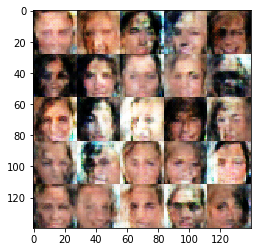

Epoch: 1/2 Discriminator Loss: 1.0347427129745483 Generator Loss: 1.1077325344085693
Epoch: 1/2 Discriminator Loss: 1.4261627197265625 Generator Loss: 0.7812106013298035
Epoch: 1/2 Discriminator Loss: 1.4152597188949585 Generator Loss: 0.7691836357116699
Epoch: 1/2 Discriminator Loss: 1.2529492378234863 Generator Loss: 0.7895524501800537
Epoch: 1/2 Discriminator Loss: 1.4055840969085693 Generator Loss: 1.1852840185165405
Epoch: 1/2 Discriminator Loss: 1.1520590782165527 Generator Loss: 0.8211553692817688
Epoch: 1/2 Discriminator Loss: 1.4609415531158447 Generator Loss: 0.9682588577270508
Epoch: 1/2 Discriminator Loss: 1.2812693119049072 Generator Loss: 0.8918930292129517
Epoch: 1/2 Discriminator Loss: 1.499204158782959 Generator Loss: 0.7833902835845947
Epoch: 1/2 Discriminator Loss: 1.4087724685668945 Generator Loss: 0.9404678344726562


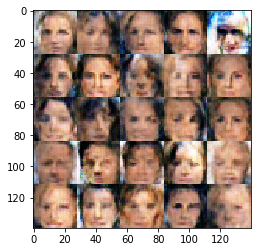

Epoch: 1/2 Discriminator Loss: 1.170994758605957 Generator Loss: 1.1373380422592163
Epoch: 1/2 Discriminator Loss: 1.2930948734283447 Generator Loss: 0.9635430574417114
Epoch: 1/2 Discriminator Loss: 1.4744725227355957 Generator Loss: 0.8599680066108704
Epoch: 1/2 Discriminator Loss: 1.2581498622894287 Generator Loss: 0.9876587986946106
Epoch: 1/2 Discriminator Loss: 1.3094311952590942 Generator Loss: 0.907184362411499
Epoch: 1/2 Discriminator Loss: 1.3785512447357178 Generator Loss: 0.8646194338798523
Epoch: 1/2 Discriminator Loss: 1.1878678798675537 Generator Loss: 0.7707315683364868
Epoch: 1/2 Discriminator Loss: 1.3388261795043945 Generator Loss: 0.8790305852890015
Epoch: 1/2 Discriminator Loss: 1.4023642539978027 Generator Loss: 0.7519857883453369
Epoch: 1/2 Discriminator Loss: 1.1274676322937012 Generator Loss: 1.0850391387939453


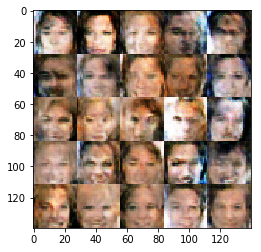

Epoch: 1/2 Discriminator Loss: 1.3063095808029175 Generator Loss: 0.9369949102401733
Epoch: 1/2 Discriminator Loss: 1.553053617477417 Generator Loss: 0.8721373677253723
Epoch: 1/2 Discriminator Loss: 1.2774171829223633 Generator Loss: 0.9018172025680542
Epoch: 1/2 Discriminator Loss: 1.1851470470428467 Generator Loss: 0.9973524212837219
Epoch: 1/2 Discriminator Loss: 1.078647255897522 Generator Loss: 1.1087005138397217
Epoch: 1/2 Discriminator Loss: 1.3050141334533691 Generator Loss: 0.955568790435791
Epoch: 1/2 Discriminator Loss: 1.5233588218688965 Generator Loss: 0.8235517144203186
Epoch: 1/2 Discriminator Loss: 1.3209178447723389 Generator Loss: 0.8220747113227844
Epoch: 1/2 Discriminator Loss: 1.5364999771118164 Generator Loss: 0.9195894002914429
Epoch: 1/2 Discriminator Loss: 1.4717297554016113 Generator Loss: 0.8862708806991577


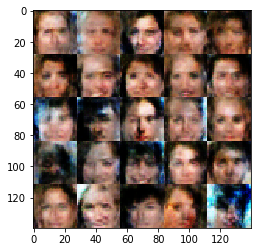

Epoch: 1/2 Discriminator Loss: 1.3681130409240723 Generator Loss: 0.853937029838562
Epoch: 1/2 Discriminator Loss: 1.4330023527145386 Generator Loss: 0.8087934255599976
Epoch: 1/2 Discriminator Loss: 1.3447065353393555 Generator Loss: 0.9302617311477661
Epoch: 1/2 Discriminator Loss: 1.3027350902557373 Generator Loss: 0.9646928310394287
Epoch: 1/2 Discriminator Loss: 1.1937036514282227 Generator Loss: 0.71364426612854
Epoch: 1/2 Discriminator Loss: 1.6494841575622559 Generator Loss: 0.8047252893447876
Epoch: 1/2 Discriminator Loss: 1.1493940353393555 Generator Loss: 1.270397663116455
Epoch: 1/2 Discriminator Loss: 1.4157218933105469 Generator Loss: 0.9755834341049194
Epoch: 1/2 Discriminator Loss: 1.2109768390655518 Generator Loss: 0.9790159463882446
Epoch: 1/2 Discriminator Loss: 1.2350696325302124 Generator Loss: 0.9818863868713379


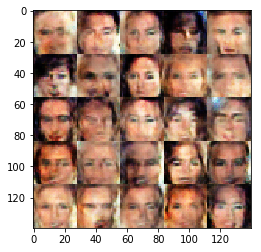

Epoch: 1/2 Discriminator Loss: 1.16885507106781 Generator Loss: 0.8448663949966431
Epoch: 1/2 Discriminator Loss: 1.2525794506072998 Generator Loss: 1.2734758853912354
Epoch: 1/2 Discriminator Loss: 1.5877599716186523 Generator Loss: 1.1618717908859253
Epoch: 1/2 Discriminator Loss: 1.213693618774414 Generator Loss: 0.9405983686447144
Epoch: 1/2 Discriminator Loss: 1.3423237800598145 Generator Loss: 0.9755173921585083
Epoch: 1/2 Discriminator Loss: 1.0669994354248047 Generator Loss: 1.0677003860473633
Epoch: 1/2 Discriminator Loss: 1.4893245697021484 Generator Loss: 0.9317873120307922
Epoch: 1/2 Discriminator Loss: 1.1610357761383057 Generator Loss: 0.964344322681427
Epoch: 1/2 Discriminator Loss: 1.1219719648361206 Generator Loss: 1.2243045568466187
Epoch: 1/2 Discriminator Loss: 1.4637200832366943 Generator Loss: 0.7006567716598511


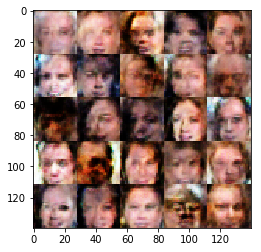

Epoch: 1/2 Discriminator Loss: 1.1051912307739258 Generator Loss: 1.214287281036377
Epoch: 1/2 Discriminator Loss: 1.324547529220581 Generator Loss: 0.6616966724395752
Epoch: 1/2 Discriminator Loss: 1.3823450803756714 Generator Loss: 0.7937521934509277
Epoch: 1/2 Discriminator Loss: 1.3187534809112549 Generator Loss: 0.9390498995780945
Epoch: 1/2 Discriminator Loss: 1.230787992477417 Generator Loss: 1.134394645690918
Epoch: 1/2 Discriminator Loss: 1.2679165601730347 Generator Loss: 1.2080590724945068
Epoch: 1/2 Discriminator Loss: 1.260697841644287 Generator Loss: 0.772196352481842
Epoch: 1/2 Discriminator Loss: 1.3068374395370483 Generator Loss: 0.9442789554595947
Epoch: 1/2 Discriminator Loss: 1.285386323928833 Generator Loss: 0.7665144801139832
Epoch: 1/2 Discriminator Loss: 1.2635605335235596 Generator Loss: 0.9492712616920471


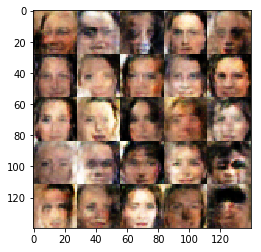

Epoch: 1/2 Discriminator Loss: 1.3099796772003174 Generator Loss: 0.9581975340843201
Epoch: 1/2 Discriminator Loss: 1.2546736001968384 Generator Loss: 0.9196174144744873
Epoch: 1/2 Discriminator Loss: 1.1749989986419678 Generator Loss: 0.9040566682815552
Epoch: 1/2 Discriminator Loss: 1.280401587486267 Generator Loss: 0.904584527015686
Epoch: 1/2 Discriminator Loss: 1.0986225605010986 Generator Loss: 0.8428876996040344
Epoch: 1/2 Discriminator Loss: 1.4568901062011719 Generator Loss: 0.5727452039718628
Epoch: 1/2 Discriminator Loss: 1.2361704111099243 Generator Loss: 0.8779253363609314
Epoch: 1/2 Discriminator Loss: 1.2010232210159302 Generator Loss: 1.142188549041748
Epoch: 1/2 Discriminator Loss: 1.529613733291626 Generator Loss: 1.0443452596664429
Epoch: 1/2 Discriminator Loss: 1.1434205770492554 Generator Loss: 0.702667236328125


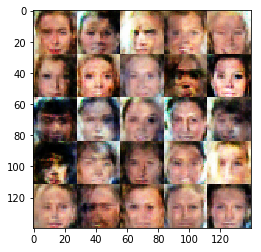

Epoch: 1/2 Discriminator Loss: 1.2740639448165894 Generator Loss: 0.9425148963928223
Epoch: 1/2 Discriminator Loss: 1.6505274772644043 Generator Loss: 1.1206552982330322
Epoch: 1/2 Discriminator Loss: 1.2157925367355347 Generator Loss: 0.902129054069519
Epoch: 1/2 Discriminator Loss: 1.1612796783447266 Generator Loss: 1.491166591644287
Epoch: 1/2 Discriminator Loss: 1.0737766027450562 Generator Loss: 1.0292260646820068
Epoch: 1/2 Discriminator Loss: 1.444067120552063 Generator Loss: 0.7018370032310486
Epoch: 1/2 Discriminator Loss: 1.2150371074676514 Generator Loss: 1.2121682167053223
Epoch: 1/2 Discriminator Loss: 1.4340105056762695 Generator Loss: 0.5748366117477417
Epoch: 1/2 Discriminator Loss: 1.1013469696044922 Generator Loss: 0.7336561679840088
Epoch: 1/2 Discriminator Loss: 1.2005198001861572 Generator Loss: 1.0801516771316528


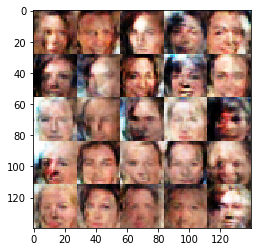

Epoch: 1/2 Discriminator Loss: 1.2530518770217896 Generator Loss: 0.8557579517364502
Epoch: 1/2 Discriminator Loss: 1.4429634809494019 Generator Loss: 0.9739129543304443
Epoch: 1/2 Discriminator Loss: 1.2550480365753174 Generator Loss: 0.9376133680343628
Epoch: 1/2 Discriminator Loss: 1.1978271007537842 Generator Loss: 1.0423334836959839
Epoch: 1/2 Discriminator Loss: 1.2699710130691528 Generator Loss: 0.9607332348823547
Epoch: 1/2 Discriminator Loss: 1.286266803741455 Generator Loss: 1.0803959369659424
Epoch: 1/2 Discriminator Loss: 1.2762224674224854 Generator Loss: 0.8858617544174194
Epoch: 1/2 Discriminator Loss: 1.2206997871398926 Generator Loss: 1.089821696281433
Epoch: 1/2 Discriminator Loss: 1.0258606672286987 Generator Loss: 1.2156339883804321
Epoch: 1/2 Discriminator Loss: 1.3913602828979492 Generator Loss: 0.9074547290802002


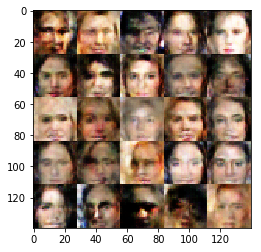

Epoch: 1/2 Discriminator Loss: 1.3629891872406006 Generator Loss: 0.7558325529098511
Epoch: 1/2 Discriminator Loss: 1.2397700548171997 Generator Loss: 1.059598684310913
Epoch: 1/2 Discriminator Loss: 1.356774091720581 Generator Loss: 0.8942666053771973
Epoch: 1/2 Discriminator Loss: 1.2249000072479248 Generator Loss: 1.1353373527526855
Epoch: 1/2 Discriminator Loss: 1.182082176208496 Generator Loss: 0.913353681564331
Epoch: 1/2 Discriminator Loss: 1.3474485874176025 Generator Loss: 1.1402407884597778
Epoch: 1/2 Discriminator Loss: 1.4925822019577026 Generator Loss: 0.9313627481460571
Epoch: 1/2 Discriminator Loss: 1.1260292530059814 Generator Loss: 0.7587063908576965
Epoch: 1/2 Discriminator Loss: 1.2225422859191895 Generator Loss: 0.9238049387931824
Epoch: 1/2 Discriminator Loss: 1.2847554683685303 Generator Loss: 0.7032672762870789


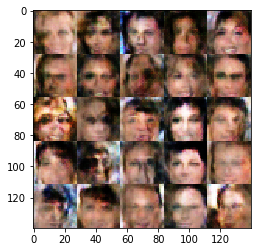

Epoch: 1/2 Discriminator Loss: 1.2817299365997314 Generator Loss: 1.0885589122772217
Epoch: 1/2 Discriminator Loss: 1.3238959312438965 Generator Loss: 0.9217579960823059
Epoch: 1/2 Discriminator Loss: 1.1562714576721191 Generator Loss: 1.0799323320388794
Epoch: 1/2 Discriminator Loss: 1.3473098278045654 Generator Loss: 1.0914322137832642
Epoch: 1/2 Discriminator Loss: 1.0699639320373535 Generator Loss: 0.860456109046936
Epoch: 1/2 Discriminator Loss: 1.1115076541900635 Generator Loss: 0.9525188207626343
Epoch: 1/2 Discriminator Loss: 1.4205527305603027 Generator Loss: 1.1219230890274048
Epoch: 1/2 Discriminator Loss: 1.3017375469207764 Generator Loss: 1.0508546829223633
Epoch: 1/2 Discriminator Loss: 1.092893362045288 Generator Loss: 1.0996136665344238
Epoch: 1/2 Discriminator Loss: 1.3461370468139648 Generator Loss: 0.8737279176712036


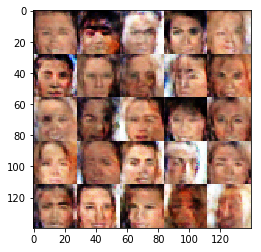

Epoch: 1/2 Discriminator Loss: 1.4227625131607056 Generator Loss: 1.1527230739593506
Epoch: 1/2 Discriminator Loss: 1.320095419883728 Generator Loss: 1.1461129188537598
Epoch: 1/2 Discriminator Loss: 1.228417158126831 Generator Loss: 1.3074612617492676
Epoch: 1/2 Discriminator Loss: 1.174720287322998 Generator Loss: 0.9621275663375854
Epoch: 1/2 Discriminator Loss: 1.1044625043869019 Generator Loss: 0.7716715931892395
Epoch: 1/2 Discriminator Loss: 1.161978006362915 Generator Loss: 1.0971078872680664
Epoch: 1/2 Discriminator Loss: 1.0627521276474 Generator Loss: 1.506922721862793
Epoch: 1/2 Discriminator Loss: 1.244956374168396 Generator Loss: 0.8102980852127075
Epoch: 1/2 Discriminator Loss: 1.3336652517318726 Generator Loss: 0.9872293472290039
Epoch: 1/2 Discriminator Loss: 1.1349523067474365 Generator Loss: 1.1613147258758545


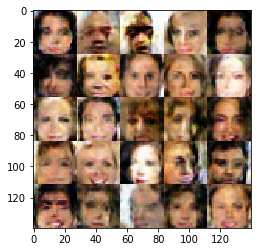

Epoch: 1/2 Discriminator Loss: 1.2975494861602783 Generator Loss: 1.2179787158966064
Epoch: 1/2 Discriminator Loss: 1.128739595413208 Generator Loss: 0.944983720779419
Epoch: 1/2 Discriminator Loss: 1.3187718391418457 Generator Loss: 0.736069917678833
Epoch: 1/2 Discriminator Loss: 1.1764888763427734 Generator Loss: 0.9944537878036499
Epoch: 1/2 Discriminator Loss: 1.3094381093978882 Generator Loss: 1.0883426666259766
Epoch: 1/2 Discriminator Loss: 1.1190130710601807 Generator Loss: 0.9570459127426147
Epoch: 1/2 Discriminator Loss: 1.0846868753433228 Generator Loss: 1.3064656257629395
Epoch: 1/2 Discriminator Loss: 1.0010278224945068 Generator Loss: 1.1560709476470947
Epoch: 1/2 Discriminator Loss: 1.5145633220672607 Generator Loss: 0.6508991718292236
Epoch: 1/2 Discriminator Loss: 1.1755372285842896 Generator Loss: 0.9268934726715088


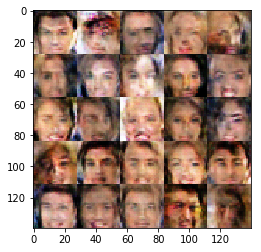

Epoch: 1/2 Discriminator Loss: 1.1792281866073608 Generator Loss: 1.0944569110870361
Epoch: 1/2 Discriminator Loss: 1.6340588331222534 Generator Loss: 0.70219886302948
Epoch: 1/2 Discriminator Loss: 1.1187807321548462 Generator Loss: 0.9535113573074341
Epoch: 1/2 Discriminator Loss: 1.276524543762207 Generator Loss: 0.6945258378982544
Epoch: 1/2 Discriminator Loss: 1.0093104839324951 Generator Loss: 1.1177494525909424
Epoch: 1/2 Discriminator Loss: 1.110886573791504 Generator Loss: 1.0649436712265015
Epoch: 1/2 Discriminator Loss: 1.2724195718765259 Generator Loss: 1.0895006656646729
Epoch: 1/2 Discriminator Loss: 1.5752418041229248 Generator Loss: 0.8597731590270996
Epoch: 1/2 Discriminator Loss: 1.3343703746795654 Generator Loss: 0.588508129119873
Epoch: 1/2 Discriminator Loss: 1.2210404872894287 Generator Loss: 0.9961774349212646


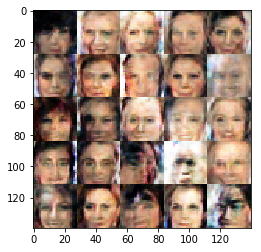

Epoch: 1/2 Discriminator Loss: 1.101928949356079 Generator Loss: 0.8249879479408264
Epoch: 1/2 Discriminator Loss: 1.2494914531707764 Generator Loss: 0.8477619886398315
Epoch: 1/2 Discriminator Loss: 1.2503962516784668 Generator Loss: 0.7042384147644043
Epoch: 1/2 Discriminator Loss: 1.380326271057129 Generator Loss: 1.2242841720581055
Epoch: 1/2 Discriminator Loss: 1.168257236480713 Generator Loss: 1.0789518356323242
Epoch: 1/2 Discriminator Loss: 1.0387322902679443 Generator Loss: 1.536094069480896
Epoch: 1/2 Discriminator Loss: 1.349740743637085 Generator Loss: 1.2865815162658691
Epoch: 1/2 Discriminator Loss: 1.0821349620819092 Generator Loss: 0.9120665788650513
Epoch: 1/2 Discriminator Loss: 1.1794222593307495 Generator Loss: 0.8427563309669495
Epoch: 1/2 Discriminator Loss: 1.1525564193725586 Generator Loss: 1.0157506465911865


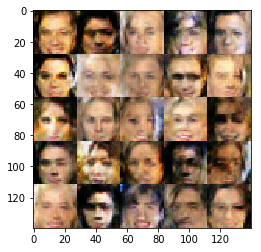

Epoch: 1/2 Discriminator Loss: 1.1557707786560059 Generator Loss: 1.3553779125213623
Epoch: 1/2 Discriminator Loss: 1.105397343635559 Generator Loss: 1.0351481437683105
Epoch: 1/2 Discriminator Loss: 1.167901635169983 Generator Loss: 1.3194217681884766
Epoch: 1/2 Discriminator Loss: 0.9879183173179626 Generator Loss: 1.412787675857544
Epoch: 1/2 Discriminator Loss: 1.1883933544158936 Generator Loss: 1.0441854000091553
Epoch: 1/2 Discriminator Loss: 1.1027947664260864 Generator Loss: 1.12716543674469
Epoch: 1/2 Discriminator Loss: 1.2088485956192017 Generator Loss: 0.9572122693061829
Epoch: 1/2 Discriminator Loss: 1.0008071660995483 Generator Loss: 1.5049134492874146
Epoch: 1/2 Discriminator Loss: 1.2321116924285889 Generator Loss: 1.0728176832199097
Epoch: 1/2 Discriminator Loss: 1.3455562591552734 Generator Loss: 1.450684905052185


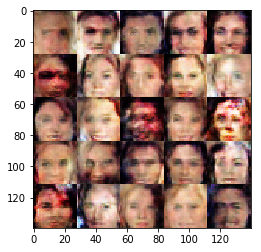

Epoch: 1/2 Discriminator Loss: 1.2876185178756714 Generator Loss: 1.255955696105957
Epoch: 1/2 Discriminator Loss: 1.1560413837432861 Generator Loss: 0.9916054606437683
Epoch: 1/2 Discriminator Loss: 1.2801713943481445 Generator Loss: 1.5150866508483887
Epoch: 1/2 Discriminator Loss: 1.0189120769500732 Generator Loss: 0.7642073631286621
Epoch: 1/2 Discriminator Loss: 1.0765337944030762 Generator Loss: 0.5931236743927002
Epoch: 1/2 Discriminator Loss: 1.2107677459716797 Generator Loss: 1.5650582313537598
Epoch: 1/2 Discriminator Loss: 1.437760829925537 Generator Loss: 1.3011382818222046
Epoch: 1/2 Discriminator Loss: 0.8652329444885254 Generator Loss: 0.9406417012214661
Epoch: 1/2 Discriminator Loss: 1.0679104328155518 Generator Loss: 0.9627169370651245
Epoch: 1/2 Discriminator Loss: 1.0809111595153809 Generator Loss: 1.0904356241226196


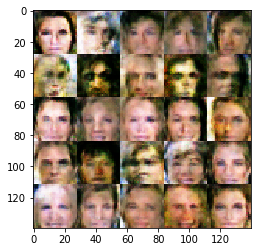

Epoch: 1/2 Discriminator Loss: 1.1421864032745361 Generator Loss: 1.4573218822479248
Epoch: 1/2 Discriminator Loss: 1.0849143266677856 Generator Loss: 1.0551308393478394
Epoch: 1/2 Discriminator Loss: 0.9714272022247314 Generator Loss: 0.841289758682251
Epoch: 1/2 Discriminator Loss: 1.2572190761566162 Generator Loss: 0.6931561231613159
Epoch: 1/2 Discriminator Loss: 1.2152159214019775 Generator Loss: 1.4189419746398926
Epoch: 1/2 Discriminator Loss: 0.9559891819953918 Generator Loss: 1.2417194843292236
Epoch: 1/2 Discriminator Loss: 1.1771718263626099 Generator Loss: 1.0718646049499512
Epoch: 1/2 Discriminator Loss: 1.350829839706421 Generator Loss: 1.561083436012268
Epoch: 1/2 Discriminator Loss: 1.200932502746582 Generator Loss: 1.324175477027893
Epoch: 1/2 Discriminator Loss: 1.217788815498352 Generator Loss: 1.4641995429992676


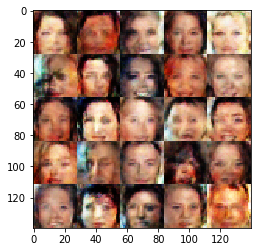

Epoch: 1/2 Discriminator Loss: 1.0824265480041504 Generator Loss: 0.9572931528091431
Epoch: 1/2 Discriminator Loss: 1.09995436668396 Generator Loss: 1.1467149257659912
Epoch: 1/2 Discriminator Loss: 1.1168010234832764 Generator Loss: 0.9758659601211548
Epoch: 1/2 Discriminator Loss: 1.2678353786468506 Generator Loss: 0.6785749793052673
Epoch: 1/2 Discriminator Loss: 1.1902967691421509 Generator Loss: 1.2159371376037598
Epoch: 1/2 Discriminator Loss: 1.3768622875213623 Generator Loss: 1.0273772478103638
Epoch: 1/2 Discriminator Loss: 1.2356535196304321 Generator Loss: 1.3103828430175781
Epoch: 1/2 Discriminator Loss: 1.0949519872665405 Generator Loss: 1.2648155689239502
Epoch: 1/2 Discriminator Loss: 1.165006399154663 Generator Loss: 1.1392865180969238
Epoch: 1/2 Discriminator Loss: 1.3467051982879639 Generator Loss: 0.8747175931930542


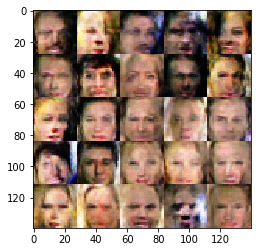

Epoch: 1/2 Discriminator Loss: 1.2003650665283203 Generator Loss: 1.313035488128662
Epoch: 1/2 Discriminator Loss: 1.2247626781463623 Generator Loss: 1.4042785167694092
Epoch: 1/2 Discriminator Loss: 1.4314793348312378 Generator Loss: 0.5637696385383606
Epoch: 1/2 Discriminator Loss: 1.1558908224105835 Generator Loss: 0.9469406604766846
Epoch: 1/2 Discriminator Loss: 1.2681890726089478 Generator Loss: 1.3008793592453003
Epoch: 1/2 Discriminator Loss: 1.213322639465332 Generator Loss: 0.9460301399230957
Epoch: 1/2 Discriminator Loss: 0.9922012686729431 Generator Loss: 1.5166374444961548
Epoch: 1/2 Discriminator Loss: 1.119805097579956 Generator Loss: 1.3971425294876099
Epoch: 1/2 Discriminator Loss: 1.05270254611969 Generator Loss: 0.8911458253860474
Epoch: 1/2 Discriminator Loss: 1.2202160358428955 Generator Loss: 1.5133386850357056


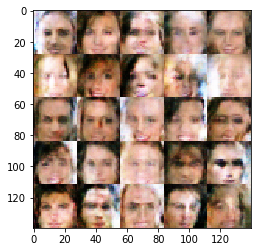

Epoch: 1/2 Discriminator Loss: 1.4882032871246338 Generator Loss: 0.7954890131950378
Epoch: 1/2 Discriminator Loss: 1.3314770460128784 Generator Loss: 0.66550213098526
Epoch: 1/2 Discriminator Loss: 1.4244465827941895 Generator Loss: 0.9401278495788574
Epoch: 1/2 Discriminator Loss: 1.1970845460891724 Generator Loss: 0.9965760707855225
Epoch: 1/2 Discriminator Loss: 1.1375706195831299 Generator Loss: 0.9663058519363403
Epoch: 1/2 Discriminator Loss: 1.2636973857879639 Generator Loss: 0.9759742021560669
Epoch: 1/2 Discriminator Loss: 1.137656569480896 Generator Loss: 1.3683109283447266
Epoch: 1/2 Discriminator Loss: 1.124266266822815 Generator Loss: 1.218281626701355
Epoch: 1/2 Discriminator Loss: 0.9563560485839844 Generator Loss: 0.9419755935668945
Epoch: 1/2 Discriminator Loss: 0.9783849120140076 Generator Loss: 0.8830469846725464


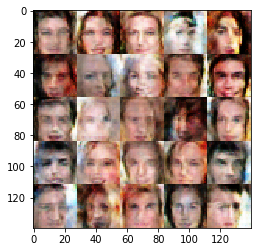

Epoch: 1/2 Discriminator Loss: 1.095780849456787 Generator Loss: 1.206447958946228
Epoch: 1/2 Discriminator Loss: 1.0423343181610107 Generator Loss: 1.7427725791931152
Epoch: 1/2 Discriminator Loss: 1.155140995979309 Generator Loss: 1.0386112928390503
Epoch: 1/2 Discriminator Loss: 1.1271288394927979 Generator Loss: 1.0777006149291992
Epoch: 1/2 Discriminator Loss: 1.180115818977356 Generator Loss: 1.2645015716552734
Epoch: 1/2 Discriminator Loss: 1.3029581308364868 Generator Loss: 0.665728747844696
Epoch: 1/2 Discriminator Loss: 1.0371663570404053 Generator Loss: 0.9152429103851318
Epoch: 1/2 Discriminator Loss: 0.8880819082260132 Generator Loss: 1.4658763408660889
Epoch: 1/2 Discriminator Loss: 0.9475325345993042 Generator Loss: 1.02059006690979
Epoch: 1/2 Discriminator Loss: 1.248931884765625 Generator Loss: 1.3459303379058838


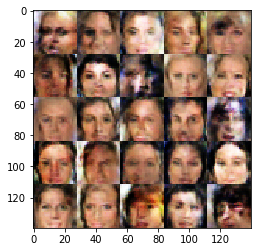

Epoch: 1/2 Discriminator Loss: 1.3866604566574097 Generator Loss: 0.9434279203414917
Epoch: 1/2 Discriminator Loss: 1.0222907066345215 Generator Loss: 1.381547451019287
Epoch: 1/2 Discriminator Loss: 1.0543105602264404 Generator Loss: 0.829502522945404
Epoch: 1/2 Discriminator Loss: 1.0480287075042725 Generator Loss: 1.5357416868209839
Epoch: 1/2 Discriminator Loss: 1.0898137092590332 Generator Loss: 1.1316545009613037
Epoch: 1/2 Discriminator Loss: 1.0470927953720093 Generator Loss: 1.403507113456726
Epoch: 1/2 Discriminator Loss: 1.1663832664489746 Generator Loss: 0.8103923797607422
Epoch: 1/2 Discriminator Loss: 1.0977602005004883 Generator Loss: 1.1683849096298218
Epoch: 1/2 Discriminator Loss: 1.235950231552124 Generator Loss: 0.6307310461997986
Epoch: 1/2 Discriminator Loss: 0.8710761666297913 Generator Loss: 1.4357092380523682


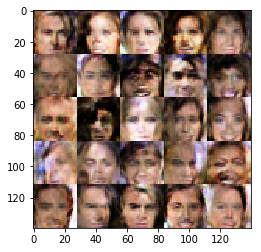

Epoch: 1/2 Discriminator Loss: 0.8326066732406616 Generator Loss: 1.3027677536010742
Epoch: 1/2 Discriminator Loss: 1.3706828355789185 Generator Loss: 1.1511178016662598
Epoch: 1/2 Discriminator Loss: 1.0691649913787842 Generator Loss: 1.0160415172576904
Epoch: 1/2 Discriminator Loss: 1.1501562595367432 Generator Loss: 1.0553078651428223
Epoch: 1/2 Discriminator Loss: 0.9137319922447205 Generator Loss: 1.5018606185913086
Epoch: 1/2 Discriminator Loss: 1.2803248167037964 Generator Loss: 0.6564652919769287
Epoch: 1/2 Discriminator Loss: 0.907545268535614 Generator Loss: 1.346683382987976
Epoch: 1/2 Discriminator Loss: 1.1389439105987549 Generator Loss: 0.9990216493606567
Epoch: 1/2 Discriminator Loss: 1.1081552505493164 Generator Loss: 1.2938605546951294
Epoch: 1/2 Discriminator Loss: 1.2002630233764648 Generator Loss: 1.2094563245773315


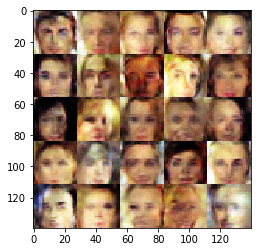

Epoch: 1/2 Discriminator Loss: 1.3693430423736572 Generator Loss: 0.8256196975708008
Epoch: 1/2 Discriminator Loss: 1.2737774848937988 Generator Loss: 0.8912889957427979
Epoch: 1/2 Discriminator Loss: 1.3433873653411865 Generator Loss: 1.0165722370147705
Epoch: 1/2 Discriminator Loss: 1.2255266904830933 Generator Loss: 0.8830222487449646
Epoch: 1/2 Discriminator Loss: 1.183413028717041 Generator Loss: 0.833343505859375
Epoch: 1/2 Discriminator Loss: 1.0155558586120605 Generator Loss: 1.0114505290985107
Epoch: 1/2 Discriminator Loss: 1.2415904998779297 Generator Loss: 0.677544891834259
Epoch: 1/2 Discriminator Loss: 1.0957324504852295 Generator Loss: 1.1848907470703125
Epoch: 1/2 Discriminator Loss: 1.2393182516098022 Generator Loss: 0.8222616314888
Epoch: 1/2 Discriminator Loss: 0.9200360774993896 Generator Loss: 1.8818707466125488


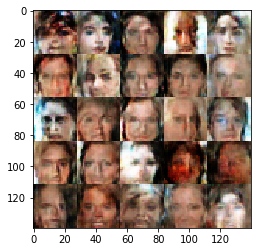

Epoch: 1/2 Discriminator Loss: 0.9523749351501465 Generator Loss: 1.2850465774536133
Epoch: 1/2 Discriminator Loss: 1.3479039669036865 Generator Loss: 0.6740860342979431
Epoch: 1/2 Discriminator Loss: 1.3252989053726196 Generator Loss: 0.6656407117843628
Epoch: 1/2 Discriminator Loss: 1.3198150396347046 Generator Loss: 1.165597677230835
Epoch: 1/2 Discriminator Loss: 0.9750118851661682 Generator Loss: 1.4467625617980957
Epoch: 1/2 Discriminator Loss: 0.9941574335098267 Generator Loss: 1.241104245185852
Epoch: 1/2 Discriminator Loss: 1.0580466985702515 Generator Loss: 1.1286909580230713
Epoch: 1/2 Discriminator Loss: 1.2975481748580933 Generator Loss: 0.6346726417541504
Epoch: 1/2 Discriminator Loss: 1.2667925357818604 Generator Loss: 1.2850580215454102
Epoch: 1/2 Discriminator Loss: 1.2754294872283936 Generator Loss: 1.1563907861709595


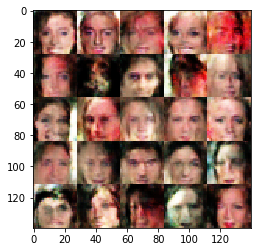

Epoch: 1/2 Discriminator Loss: 1.1493301391601562 Generator Loss: 1.466784119606018
Epoch: 1/2 Discriminator Loss: 0.8300786018371582 Generator Loss: 1.349334478378296
Epoch: 1/2 Discriminator Loss: 0.8211504817008972 Generator Loss: 1.3504706621170044
Epoch: 1/2 Discriminator Loss: 0.9179987907409668 Generator Loss: 0.9278198480606079
Epoch: 1/2 Discriminator Loss: 1.1548957824707031 Generator Loss: 0.5463212132453918
Epoch: 1/2 Discriminator Loss: 1.2057278156280518 Generator Loss: 1.4743504524230957
Epoch: 1/2 Discriminator Loss: 1.1376491785049438 Generator Loss: 0.8668460845947266
Epoch: 1/2 Discriminator Loss: 1.0423901081085205 Generator Loss: 1.1810282468795776
Epoch: 1/2 Discriminator Loss: 1.0026426315307617 Generator Loss: 1.2131927013397217
Epoch: 1/2 Discriminator Loss: 1.0494511127471924 Generator Loss: 0.8655136227607727


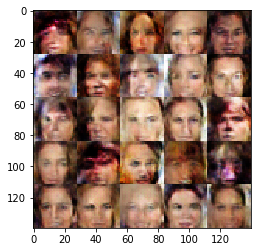

Epoch: 1/2 Discriminator Loss: 0.9450485110282898 Generator Loss: 1.593180537223816
Epoch: 1/2 Discriminator Loss: 1.0320385694503784 Generator Loss: 1.579315423965454
Epoch: 1/2 Discriminator Loss: 1.3043689727783203 Generator Loss: 1.7192068099975586
Epoch: 1/2 Discriminator Loss: 1.0661258697509766 Generator Loss: 1.2899055480957031
Epoch: 1/2 Discriminator Loss: 1.2366740703582764 Generator Loss: 0.7876944541931152
Epoch: 1/2 Discriminator Loss: 1.2152504920959473 Generator Loss: 1.2132551670074463
Epoch: 1/2 Discriminator Loss: 1.0455325841903687 Generator Loss: 1.214447021484375
Epoch: 1/2 Discriminator Loss: 1.4097225666046143 Generator Loss: 0.8111116886138916
Epoch: 1/2 Discriminator Loss: 1.163358211517334 Generator Loss: 1.0733214616775513
Epoch: 1/2 Discriminator Loss: 0.9407050609588623 Generator Loss: 1.5711891651153564


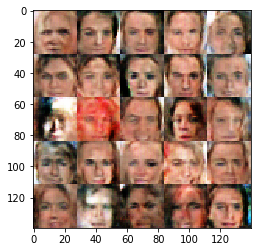

Epoch: 1/2 Discriminator Loss: 1.0848994255065918 Generator Loss: 0.9999854564666748
Epoch: 1/2 Discriminator Loss: 0.8204289674758911 Generator Loss: 1.1753367185592651
Epoch: 1/2 Discriminator Loss: 1.0593233108520508 Generator Loss: 1.7107946872711182
Epoch: 1/2 Discriminator Loss: 1.1129097938537598 Generator Loss: 1.3226723670959473
Epoch: 1/2 Discriminator Loss: 1.0451130867004395 Generator Loss: 1.6813616752624512
Epoch: 1/2 Discriminator Loss: 1.1957566738128662 Generator Loss: 1.473846673965454
Epoch: 1/2 Discriminator Loss: 1.2016267776489258 Generator Loss: 1.6566476821899414
Epoch: 1/2 Discriminator Loss: 1.204006552696228 Generator Loss: 0.9234737157821655
Epoch: 1/2 Discriminator Loss: 1.1483092308044434 Generator Loss: 0.8770943284034729
Epoch: 1/2 Discriminator Loss: 1.0612843036651611 Generator Loss: 1.2167208194732666


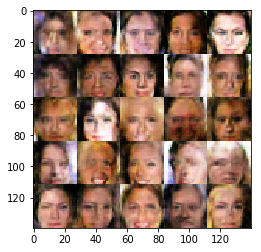

Epoch: 1/2 Discriminator Loss: 1.0699338912963867 Generator Loss: 1.0839002132415771
Epoch: 1/2 Discriminator Loss: 1.3967413902282715 Generator Loss: 0.9997659921646118
Epoch: 1/2 Discriminator Loss: 1.0125582218170166 Generator Loss: 0.8083337545394897
Epoch: 1/2 Discriminator Loss: 1.0333821773529053 Generator Loss: 1.261426568031311
Epoch: 1/2 Discriminator Loss: 1.246374249458313 Generator Loss: 0.9440186023712158
Epoch: 1/2 Discriminator Loss: 0.9907021522521973 Generator Loss: 1.5335315465927124
Epoch: 1/2 Discriminator Loss: 1.1661272048950195 Generator Loss: 0.8819832801818848
Epoch: 1/2 Discriminator Loss: 1.1471976041793823 Generator Loss: 1.4991061687469482
Epoch: 1/2 Discriminator Loss: 1.127469539642334 Generator Loss: 0.7896066308021545
Epoch: 1/2 Discriminator Loss: 0.9582757353782654 Generator Loss: 0.8943091630935669


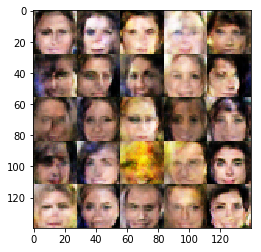

Epoch: 1/2 Discriminator Loss: 0.9767658114433289 Generator Loss: 1.5252729654312134
Epoch: 1/2 Discriminator Loss: 0.9513034820556641 Generator Loss: 1.034859538078308
Epoch: 1/2 Discriminator Loss: 1.0669515132904053 Generator Loss: 1.1679103374481201
Epoch: 1/2 Discriminator Loss: 0.9223170280456543 Generator Loss: 0.926523745059967
Epoch: 1/2 Discriminator Loss: 1.069249153137207 Generator Loss: 1.4294668436050415
Epoch: 1/2 Discriminator Loss: 1.3215830326080322 Generator Loss: 0.9447460174560547
Epoch: 1/2 Discriminator Loss: 0.9928662776947021 Generator Loss: 1.6017343997955322
Epoch: 1/2 Discriminator Loss: 0.8594672679901123 Generator Loss: 2.0787734985351562
Epoch: 1/2 Discriminator Loss: 1.4761505126953125 Generator Loss: 1.3648111820220947
Epoch: 1/2 Discriminator Loss: 1.508021593093872 Generator Loss: 0.7443684339523315


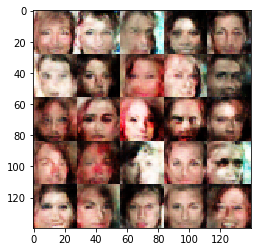

Epoch: 1/2 Discriminator Loss: 1.0962402820587158 Generator Loss: 1.8778916597366333
Epoch: 1/2 Discriminator Loss: 1.076322317123413 Generator Loss: 1.3934602737426758
Epoch: 1/2 Discriminator Loss: 1.218858242034912 Generator Loss: 0.9624848365783691
Epoch: 1/2 Discriminator Loss: 1.1638528108596802 Generator Loss: 1.584591031074524
Epoch: 1/2 Discriminator Loss: 1.465001106262207 Generator Loss: 0.8364713788032532
Epoch: 1/2 Discriminator Loss: 0.9157023429870605 Generator Loss: 1.1181626319885254
Epoch: 1/2 Discriminator Loss: 0.947623074054718 Generator Loss: 1.7426749467849731
Epoch: 1/2 Discriminator Loss: 1.2132960557937622 Generator Loss: 0.7457976937294006
Epoch: 1/2 Discriminator Loss: 1.0460106134414673 Generator Loss: 1.3486683368682861
Epoch: 1/2 Discriminator Loss: 0.8754372596740723 Generator Loss: 1.4861637353897095


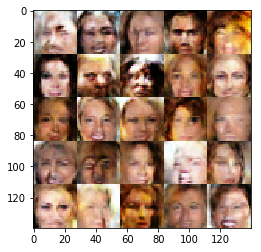

Epoch: 1/2 Discriminator Loss: 1.1081191301345825 Generator Loss: 1.2459989786148071
Epoch: 1/2 Discriminator Loss: 1.0358200073242188 Generator Loss: 1.4008820056915283
Epoch: 1/2 Discriminator Loss: 0.8276382684707642 Generator Loss: 1.3026978969573975
Epoch: 1/2 Discriminator Loss: 1.1331193447113037 Generator Loss: 1.1718072891235352
Epoch: 1/2 Discriminator Loss: 1.2266756296157837 Generator Loss: 0.8449170589447021
Epoch: 1/2 Discriminator Loss: 1.1401454210281372 Generator Loss: 1.058657169342041
Epoch: 1/2 Discriminator Loss: 0.9492506980895996 Generator Loss: 1.2948418855667114
Epoch: 1/2 Discriminator Loss: 1.0737638473510742 Generator Loss: 0.7628577947616577
Epoch: 1/2 Discriminator Loss: 1.1294620037078857 Generator Loss: 0.9271637201309204
Epoch: 1/2 Discriminator Loss: 0.7874356508255005 Generator Loss: 1.52871835231781


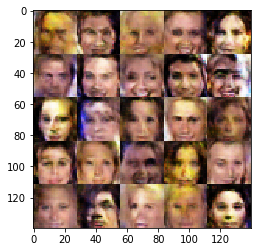

Epoch: 1/2 Discriminator Loss: 1.0839669704437256 Generator Loss: 1.0481102466583252
Epoch: 1/2 Discriminator Loss: 1.0846974849700928 Generator Loss: 1.1830189228057861
Epoch: 1/2 Discriminator Loss: 0.8222734928131104 Generator Loss: 1.015573263168335
Epoch: 1/2 Discriminator Loss: 1.1534600257873535 Generator Loss: 1.3156903982162476
Epoch: 1/2 Discriminator Loss: 0.8702530264854431 Generator Loss: 1.306830644607544
Epoch: 1/2 Discriminator Loss: 1.1383540630340576 Generator Loss: 0.8311482667922974
Epoch: 1/2 Discriminator Loss: 1.2409822940826416 Generator Loss: 1.5060410499572754
Epoch: 1/2 Discriminator Loss: 1.1995781660079956 Generator Loss: 0.8882796168327332
Epoch: 1/2 Discriminator Loss: 1.1766459941864014 Generator Loss: 1.337524652481079
Epoch: 1/2 Discriminator Loss: 1.0734052658081055 Generator Loss: 1.2800796031951904


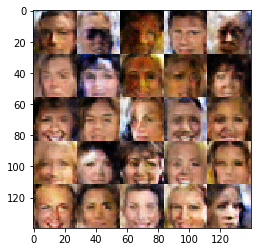

Epoch: 1/2 Discriminator Loss: 0.9639629125595093 Generator Loss: 1.3417176008224487
Epoch: 1/2 Discriminator Loss: 1.259951114654541 Generator Loss: 1.0044071674346924
Epoch: 1/2 Discriminator Loss: 1.2037453651428223 Generator Loss: 1.4698681831359863
Epoch: 1/2 Discriminator Loss: 1.1812641620635986 Generator Loss: 0.8194013237953186
Epoch: 1/2 Discriminator Loss: 1.2649905681610107 Generator Loss: 1.6274975538253784
Epoch: 1/2 Discriminator Loss: 1.1515451669692993 Generator Loss: 1.0055264234542847
Epoch: 1/2 Discriminator Loss: 1.3845374584197998 Generator Loss: 0.7972006797790527
Epoch: 1/2 Discriminator Loss: 1.1245512962341309 Generator Loss: 1.8288952112197876
Epoch: 1/2 Discriminator Loss: 1.1071470975875854 Generator Loss: 1.2057955265045166
Epoch: 1/2 Discriminator Loss: 1.3874962329864502 Generator Loss: 0.7634670734405518


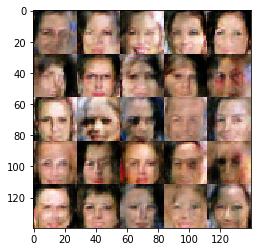

Epoch: 1/2 Discriminator Loss: 1.2845656871795654 Generator Loss: 1.3464351892471313
Epoch: 1/2 Discriminator Loss: 0.9079926013946533 Generator Loss: 1.5428084135055542
Epoch: 1/2 Discriminator Loss: 1.0953130722045898 Generator Loss: 1.6103661060333252
Epoch: 1/2 Discriminator Loss: 0.9526020288467407 Generator Loss: 1.3267892599105835
Epoch: 1/2 Discriminator Loss: 1.082493543624878 Generator Loss: 1.4101498126983643
Epoch: 1/2 Discriminator Loss: 0.7625615000724792 Generator Loss: 1.3201134204864502
Epoch: 1/2 Discriminator Loss: 1.0773203372955322 Generator Loss: 1.5175256729125977
Epoch: 1/2 Discriminator Loss: 0.9432823657989502 Generator Loss: 1.7882418632507324
Epoch: 1/2 Discriminator Loss: 0.7151536345481873 Generator Loss: 1.8088395595550537
Epoch: 1/2 Discriminator Loss: 0.943942666053772 Generator Loss: 0.97161865234375


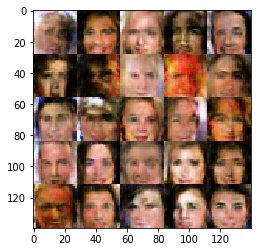

Epoch: 1/2 Discriminator Loss: 1.3826189041137695 Generator Loss: 0.9186254739761353
Epoch: 1/2 Discriminator Loss: 1.3661673069000244 Generator Loss: 1.6133713722229004
Epoch: 1/2 Discriminator Loss: 0.9357805252075195 Generator Loss: 1.2720999717712402
Epoch: 1/2 Discriminator Loss: 1.1787446737289429 Generator Loss: 0.7712951302528381
Epoch: 1/2 Discriminator Loss: 1.0147109031677246 Generator Loss: 1.2492303848266602
Epoch: 1/2 Discriminator Loss: 0.9562283158302307 Generator Loss: 1.6540539264678955
Epoch: 1/2 Discriminator Loss: 0.9078259468078613 Generator Loss: 1.6895127296447754
Epoch: 1/2 Discriminator Loss: 1.0137112140655518 Generator Loss: 1.6869779825210571
Epoch: 1/2 Discriminator Loss: 0.752852201461792 Generator Loss: 2.254024028778076
Epoch: 1/2 Discriminator Loss: 1.1193294525146484 Generator Loss: 1.237309455871582


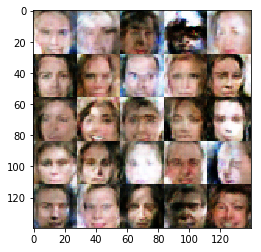

Epoch: 1/2 Discriminator Loss: 1.057125210762024 Generator Loss: 1.4522275924682617
Epoch: 1/2 Discriminator Loss: 0.8997985124588013 Generator Loss: 1.707397222518921
Epoch: 1/2 Discriminator Loss: 1.3901562690734863 Generator Loss: 0.6285070180892944
Epoch: 1/2 Discriminator Loss: 0.9142099618911743 Generator Loss: 1.11146080493927
Epoch: 1/2 Discriminator Loss: 0.9501366019248962 Generator Loss: 1.0742332935333252
Epoch: 1/2 Discriminator Loss: 0.7967575788497925 Generator Loss: 1.3228607177734375
Epoch: 1/2 Discriminator Loss: 1.2511162757873535 Generator Loss: 0.6823883056640625
Epoch: 1/2 Discriminator Loss: 0.931510329246521 Generator Loss: 1.1365468502044678
Epoch: 1/2 Discriminator Loss: 1.2841349840164185 Generator Loss: 1.2397241592407227
Epoch: 1/2 Discriminator Loss: 1.0125904083251953 Generator Loss: 1.1036275625228882


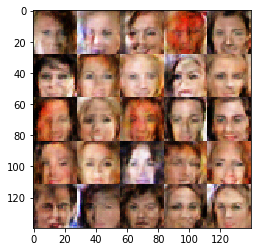

Epoch: 1/2 Discriminator Loss: 1.285796046257019 Generator Loss: 0.7621504068374634
Epoch: 1/2 Discriminator Loss: 1.0180749893188477 Generator Loss: 2.208336114883423
Epoch: 1/2 Discriminator Loss: 0.9069743752479553 Generator Loss: 1.4539098739624023
Epoch: 1/2 Discriminator Loss: 0.876738429069519 Generator Loss: 1.791193962097168
Epoch: 1/2 Discriminator Loss: 1.0013043880462646 Generator Loss: 1.2561488151550293
Epoch: 1/2 Discriminator Loss: 1.049743890762329 Generator Loss: 1.3701088428497314
Epoch: 1/2 Discriminator Loss: 0.8240175247192383 Generator Loss: 1.5857036113739014
Epoch: 1/2 Discriminator Loss: 0.9316867589950562 Generator Loss: 0.9614694118499756
Epoch: 1/2 Discriminator Loss: 1.1152236461639404 Generator Loss: 1.4940426349639893
Epoch: 1/2 Discriminator Loss: 0.8532860279083252 Generator Loss: 0.7698471546173096


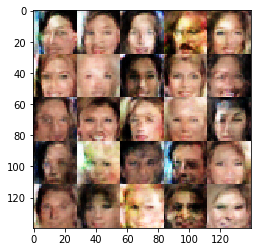

Epoch: 1/2 Discriminator Loss: 1.675452470779419 Generator Loss: 1.4276734590530396
Epoch: 1/2 Discriminator Loss: 1.0184547901153564 Generator Loss: 2.012918472290039
Epoch: 1/2 Discriminator Loss: 0.8817633390426636 Generator Loss: 1.4999799728393555
Epoch: 1/2 Discriminator Loss: 0.7181353569030762 Generator Loss: 1.5368491411209106
Epoch: 1/2 Discriminator Loss: 1.1555633544921875 Generator Loss: 1.7474886178970337
Epoch: 1/2 Discriminator Loss: 0.9952789545059204 Generator Loss: 1.7104897499084473
Epoch: 1/2 Discriminator Loss: 0.7930484414100647 Generator Loss: 1.7497873306274414
Epoch: 1/2 Discriminator Loss: 0.9294408559799194 Generator Loss: 1.779794454574585
Epoch: 1/2 Discriminator Loss: 0.9863549470901489 Generator Loss: 0.9521976113319397
Epoch: 1/2 Discriminator Loss: 1.1402103900909424 Generator Loss: 1.5431218147277832


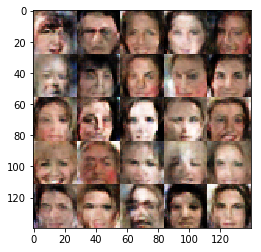

Epoch: 1/2 Discriminator Loss: 1.2142688035964966 Generator Loss: 1.7958056926727295
Epoch: 1/2 Discriminator Loss: 0.8217103481292725 Generator Loss: 1.1960196495056152
Epoch: 1/2 Discriminator Loss: 1.4415972232818604 Generator Loss: 1.4225311279296875
Epoch: 1/2 Discriminator Loss: 0.8234492540359497 Generator Loss: 1.6606719493865967
Epoch: 1/2 Discriminator Loss: 1.1045000553131104 Generator Loss: 0.9665387868881226
Epoch: 1/2 Discriminator Loss: 0.737088143825531 Generator Loss: 1.4193910360336304
Epoch: 1/2 Discriminator Loss: 0.9976767897605896 Generator Loss: 1.5319955348968506
Epoch: 1/2 Discriminator Loss: 0.9496338963508606 Generator Loss: 1.5150246620178223
Epoch: 1/2 Discriminator Loss: 1.4056048393249512 Generator Loss: 1.1130867004394531
Epoch: 1/2 Discriminator Loss: 0.8435148000717163 Generator Loss: 1.5984612703323364


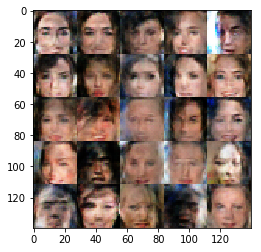

Epoch: 1/2 Discriminator Loss: 1.3072046041488647 Generator Loss: 1.093648910522461
Epoch: 1/2 Discriminator Loss: 1.0989631414413452 Generator Loss: 1.0487799644470215
Epoch: 1/2 Discriminator Loss: 0.9195159077644348 Generator Loss: 2.247817039489746
Epoch: 1/2 Discriminator Loss: 0.8070129156112671 Generator Loss: 2.582141399383545
Epoch: 1/2 Discriminator Loss: 1.1824707984924316 Generator Loss: 0.999226987361908
Epoch: 1/2 Discriminator Loss: 0.736790657043457 Generator Loss: 1.7057299613952637
Epoch: 1/2 Discriminator Loss: 1.2714401483535767 Generator Loss: 0.464851975440979
Epoch: 1/2 Discriminator Loss: 1.1497377157211304 Generator Loss: 1.1428258419036865
Epoch: 1/2 Discriminator Loss: 0.9303354024887085 Generator Loss: 1.1691375970840454
Epoch: 1/2 Discriminator Loss: 0.6404634714126587 Generator Loss: 1.7825193405151367


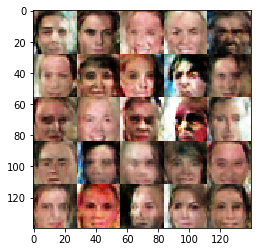

Epoch: 1/2 Discriminator Loss: 1.0677826404571533 Generator Loss: 1.1219289302825928
Epoch: 1/2 Discriminator Loss: 0.9209519624710083 Generator Loss: 1.3673391342163086
Epoch: 1/2 Discriminator Loss: 0.9528120756149292 Generator Loss: 1.0963506698608398
Epoch: 1/2 Discriminator Loss: 1.197725534439087 Generator Loss: 1.5598490238189697
Epoch: 1/2 Discriminator Loss: 1.1235404014587402 Generator Loss: 1.4436731338500977
Epoch: 1/2 Discriminator Loss: 0.9042010307312012 Generator Loss: 0.9987729787826538
Epoch: 1/2 Discriminator Loss: 0.9841980934143066 Generator Loss: 1.7771703004837036
Epoch: 1/2 Discriminator Loss: 1.0829942226409912 Generator Loss: 1.3585503101348877
Epoch: 1/2 Discriminator Loss: 1.4004590511322021 Generator Loss: 0.8592467308044434
Epoch: 1/2 Discriminator Loss: 0.7153147459030151 Generator Loss: 1.2268850803375244


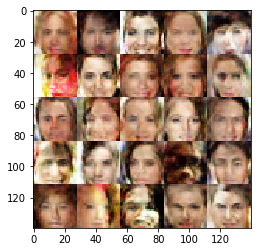

Epoch: 1/2 Discriminator Loss: 0.9156460762023926 Generator Loss: 1.5204507112503052
Epoch: 1/2 Discriminator Loss: 0.7256755828857422 Generator Loss: 2.1374382972717285
Epoch: 1/2 Discriminator Loss: 1.092278003692627 Generator Loss: 1.9624090194702148
Epoch: 1/2 Discriminator Loss: 1.096250057220459 Generator Loss: 1.5229246616363525
Epoch: 1/2 Discriminator Loss: 1.113025188446045 Generator Loss: 1.3632068634033203
Epoch: 1/2 Discriminator Loss: 1.098156213760376 Generator Loss: 1.4838948249816895
Epoch: 1/2 Discriminator Loss: 0.8596633672714233 Generator Loss: 2.1975021362304688
Epoch: 1/2 Discriminator Loss: 1.0945857763290405 Generator Loss: 2.27970552444458
Epoch: 1/2 Discriminator Loss: 1.1477047204971313 Generator Loss: 0.4404435455799103
Epoch: 1/2 Discriminator Loss: 1.6793595552444458 Generator Loss: 1.247511625289917


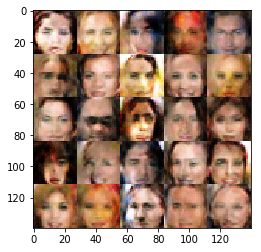

Epoch: 1/2 Discriminator Loss: 0.8737640380859375 Generator Loss: 1.2856194972991943
Epoch: 1/2 Discriminator Loss: 1.0159778594970703 Generator Loss: 1.6371452808380127
Epoch: 1/2 Discriminator Loss: 1.1435823440551758 Generator Loss: 1.5040422677993774
Epoch: 1/2 Discriminator Loss: 1.0298535823822021 Generator Loss: 1.0842046737670898
Epoch: 1/2 Discriminator Loss: 0.9518684148788452 Generator Loss: 1.8320767879486084
Epoch: 1/2 Discriminator Loss: 0.9159380197525024 Generator Loss: 1.4664983749389648
Epoch: 1/2 Discriminator Loss: 1.0015146732330322 Generator Loss: 1.402193307876587
Epoch: 1/2 Discriminator Loss: 0.8546628952026367 Generator Loss: 1.1398136615753174
Epoch: 1/2 Discriminator Loss: 1.1075103282928467 Generator Loss: 1.1981772184371948
Epoch: 1/2 Discriminator Loss: 1.1945862770080566 Generator Loss: 1.171562910079956


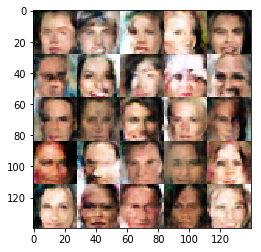

Epoch: 1/2 Discriminator Loss: 0.9205415844917297 Generator Loss: 1.158536672592163
Epoch: 1/2 Discriminator Loss: 1.2245583534240723 Generator Loss: 0.6530123949050903
Epoch: 1/2 Discriminator Loss: 1.2028043270111084 Generator Loss: 1.3065820932388306
Epoch: 1/2 Discriminator Loss: 0.8680394887924194 Generator Loss: 1.2001533508300781
Epoch: 1/2 Discriminator Loss: 0.9130508303642273 Generator Loss: 2.3433167934417725
Epoch: 1/2 Discriminator Loss: 0.8825672268867493 Generator Loss: 2.0062613487243652
Epoch: 1/2 Discriminator Loss: 1.218104600906372 Generator Loss: 1.005348801612854
Epoch: 1/2 Discriminator Loss: 0.9427168965339661 Generator Loss: 1.3621437549591064
Epoch: 1/2 Discriminator Loss: 0.9895980954170227 Generator Loss: 0.9141838550567627
Epoch: 1/2 Discriminator Loss: 0.9302868843078613 Generator Loss: 1.551379680633545


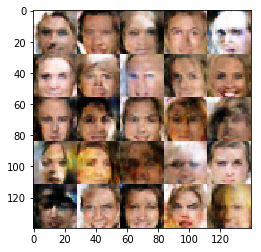

Epoch: 1/2 Discriminator Loss: 0.9903064966201782 Generator Loss: 1.6583545207977295
Epoch: 1/2 Discriminator Loss: 0.9833576083183289 Generator Loss: 1.828647494316101
Epoch: 1/2 Discriminator Loss: 0.8478182554244995 Generator Loss: 1.7140381336212158
Epoch: 1/2 Discriminator Loss: 0.9737117886543274 Generator Loss: 1.1390854120254517
Epoch: 1/2 Discriminator Loss: 0.8501169085502625 Generator Loss: 1.9372148513793945
Epoch: 1/2 Discriminator Loss: 0.9382925629615784 Generator Loss: 1.4330313205718994
Epoch: 1/2 Discriminator Loss: 1.2096363306045532 Generator Loss: 1.1161466836929321
Epoch: 1/2 Discriminator Loss: 0.8471851944923401 Generator Loss: 1.1117304563522339
Epoch: 1/2 Discriminator Loss: 1.0505766868591309 Generator Loss: 1.386027455329895
Epoch: 1/2 Discriminator Loss: 0.9337152242660522 Generator Loss: 1.4989595413208008


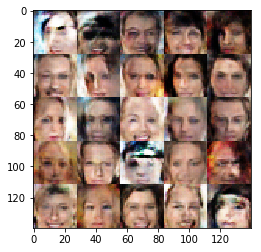

Epoch: 1/2 Discriminator Loss: 0.94959557056427 Generator Loss: 2.2717208862304688
Epoch: 1/2 Discriminator Loss: 0.8512744903564453 Generator Loss: 1.4266763925552368
Epoch: 1/2 Discriminator Loss: 1.103567361831665 Generator Loss: 1.1996243000030518
Epoch: 1/2 Discriminator Loss: 1.0636539459228516 Generator Loss: 0.8299320936203003
Epoch: 1/2 Discriminator Loss: 0.9151853919029236 Generator Loss: 1.4711482524871826
Epoch: 1/2 Discriminator Loss: 0.859707236289978 Generator Loss: 0.8922157287597656
Epoch: 1/2 Discriminator Loss: 0.868022620677948 Generator Loss: 1.3998215198516846
Epoch: 1/2 Discriminator Loss: 1.1364076137542725 Generator Loss: 1.6376969814300537
Epoch: 1/2 Discriminator Loss: 1.0611670017242432 Generator Loss: 1.3336873054504395
Epoch: 1/2 Discriminator Loss: 0.8281286954879761 Generator Loss: 0.9656432271003723


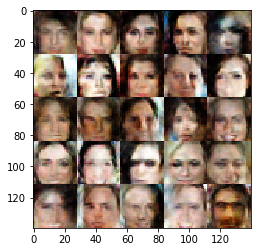

Epoch: 1/2 Discriminator Loss: 1.0735790729522705 Generator Loss: 2.2142691612243652
Epoch: 1/2 Discriminator Loss: 0.9605693817138672 Generator Loss: 1.271315097808838
Epoch: 1/2 Discriminator Loss: 0.9490458965301514 Generator Loss: 1.1316925287246704
Epoch: 1/2 Discriminator Loss: 1.4754716157913208 Generator Loss: 1.356021523475647
Epoch: 1/2 Discriminator Loss: 1.0748423337936401 Generator Loss: 1.0138825178146362
Epoch: 1/2 Discriminator Loss: 0.7871158123016357 Generator Loss: 2.566831111907959
Epoch: 1/2 Discriminator Loss: 0.8261463046073914 Generator Loss: 1.5396244525909424
Epoch: 1/2 Discriminator Loss: 0.8380560278892517 Generator Loss: 1.5918691158294678
Epoch: 1/2 Discriminator Loss: 0.8273530602455139 Generator Loss: 0.955919086933136
Epoch: 1/2 Discriminator Loss: 1.1498961448669434 Generator Loss: 1.388765573501587


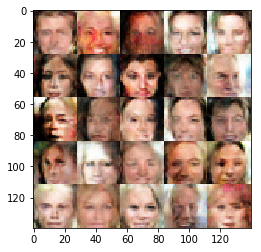

Epoch: 1/2 Discriminator Loss: 0.840603232383728 Generator Loss: 1.8328051567077637
Epoch: 1/2 Discriminator Loss: 0.902563214302063 Generator Loss: 1.092391014099121
Epoch: 1/2 Discriminator Loss: 1.3084065914154053 Generator Loss: 0.8801722526550293
Epoch: 1/2 Discriminator Loss: 1.0181009769439697 Generator Loss: 1.5393091440200806
Epoch: 1/2 Discriminator Loss: 1.074614405632019 Generator Loss: 1.6594016551971436
Epoch: 1/2 Discriminator Loss: 1.057522177696228 Generator Loss: 2.0020980834960938
Epoch: 1/2 Discriminator Loss: 0.8546631336212158 Generator Loss: 1.3144192695617676
Epoch: 1/2 Discriminator Loss: 0.8038109540939331 Generator Loss: 1.397288203239441
Epoch: 1/2 Discriminator Loss: 0.6819292306900024 Generator Loss: 0.613142728805542
Epoch: 1/2 Discriminator Loss: 0.9293162226676941 Generator Loss: 1.289971113204956


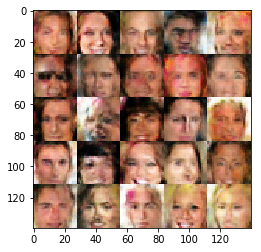

Epoch: 1/2 Discriminator Loss: 1.1735739707946777 Generator Loss: 1.3904778957366943
Epoch: 1/2 Discriminator Loss: 0.7934156656265259 Generator Loss: 1.8886785507202148
Epoch: 1/2 Discriminator Loss: 1.0518333911895752 Generator Loss: 1.595978021621704
Epoch: 1/2 Discriminator Loss: 0.8143185377120972 Generator Loss: 1.9829739332199097
Epoch: 1/2 Discriminator Loss: 0.9994847774505615 Generator Loss: 1.6211485862731934
Epoch: 1/2 Discriminator Loss: 1.097490906715393 Generator Loss: 1.146899938583374
Epoch: 1/2 Discriminator Loss: 1.0866141319274902 Generator Loss: 1.2820686101913452
Epoch: 1/2 Discriminator Loss: 0.9706393480300903 Generator Loss: 1.2186264991760254
Epoch: 1/2 Discriminator Loss: 0.8751602172851562 Generator Loss: 1.3365694284439087
Epoch: 1/2 Discriminator Loss: 0.8661209344863892 Generator Loss: 1.3724846839904785


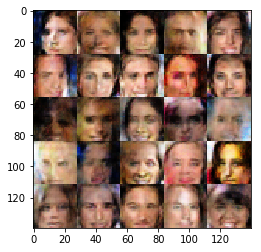

Epoch: 1/2 Discriminator Loss: 0.8041378259658813 Generator Loss: 1.541872262954712
Epoch: 1/2 Discriminator Loss: 1.239932656288147 Generator Loss: 0.658144474029541
Epoch: 1/2 Discriminator Loss: 0.7930519580841064 Generator Loss: 1.980942726135254
Epoch: 1/2 Discriminator Loss: 1.0345231294631958 Generator Loss: 1.9356335401535034
Epoch: 1/2 Discriminator Loss: 0.9922469854354858 Generator Loss: 1.3955903053283691
Epoch: 1/2 Discriminator Loss: 0.8128971457481384 Generator Loss: 2.1811318397521973
Epoch: 1/2 Discriminator Loss: 0.8861504793167114 Generator Loss: 1.59690260887146
Epoch: 1/2 Discriminator Loss: 1.085256814956665 Generator Loss: 2.461719512939453
Epoch: 1/2 Discriminator Loss: 0.8098620176315308 Generator Loss: 2.0979697704315186
Epoch: 1/2 Discriminator Loss: 1.366004467010498 Generator Loss: 0.9001572132110596


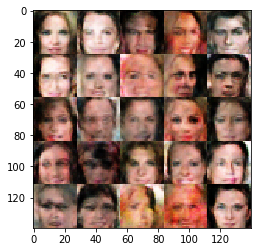

Epoch: 1/2 Discriminator Loss: 0.8677045106887817 Generator Loss: 1.2297707796096802
Epoch: 1/2 Discriminator Loss: 0.9167178273200989 Generator Loss: 2.296004056930542
Epoch: 1/2 Discriminator Loss: 1.2454934120178223 Generator Loss: 0.9377847909927368
Epoch: 1/2 Discriminator Loss: 1.2076771259307861 Generator Loss: 1.628749966621399
Epoch: 1/2 Discriminator Loss: 0.7906180620193481 Generator Loss: 2.369103193283081
Epoch: 1/2 Discriminator Loss: 0.7540401220321655 Generator Loss: 1.0606679916381836
Epoch: 1/2 Discriminator Loss: 0.8690009117126465 Generator Loss: 1.4616451263427734
Epoch: 1/2 Discriminator Loss: 1.5877642631530762 Generator Loss: 0.509803295135498
Epoch: 1/2 Discriminator Loss: 1.1020382642745972 Generator Loss: 1.273186445236206
Epoch: 1/2 Discriminator Loss: 0.915622353553772 Generator Loss: 1.5510592460632324


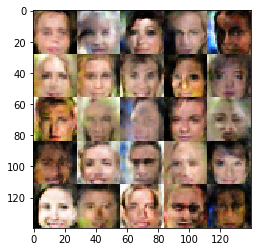

Epoch: 1/2 Discriminator Loss: 0.7815297842025757 Generator Loss: 2.008821725845337
Epoch: 1/2 Discriminator Loss: 1.0208022594451904 Generator Loss: 1.4869920015335083
Epoch: 1/2 Discriminator Loss: 0.7393786907196045 Generator Loss: 2.3814544677734375
Epoch: 1/2 Discriminator Loss: 0.7663446664810181 Generator Loss: 2.304729461669922
Epoch: 1/2 Discriminator Loss: 0.6517090797424316 Generator Loss: 1.6532533168792725
Epoch: 1/2 Discriminator Loss: 0.9849416017532349 Generator Loss: 1.0397212505340576
Epoch: 1/2 Discriminator Loss: 1.1642727851867676 Generator Loss: 0.7970078587532043
Epoch: 1/2 Discriminator Loss: 0.9021532535552979 Generator Loss: 1.1419190168380737
Epoch: 1/2 Discriminator Loss: 1.115818977355957 Generator Loss: 3.0090858936309814
Epoch: 1/2 Discriminator Loss: 0.969127893447876 Generator Loss: 1.7178664207458496


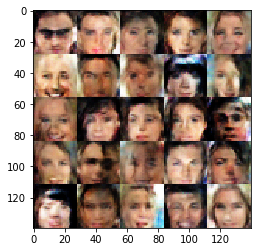

Epoch: 1/2 Discriminator Loss: 0.9131320714950562 Generator Loss: 1.6784390211105347
Epoch: 1/2 Discriminator Loss: 0.86834716796875 Generator Loss: 0.9699330925941467
Epoch: 1/2 Discriminator Loss: 1.184826135635376 Generator Loss: 1.1617074012756348
Epoch: 1/2 Discriminator Loss: 1.0916177034378052 Generator Loss: 1.2418689727783203
Epoch: 1/2 Discriminator Loss: 1.208994746208191 Generator Loss: 0.8407341837882996
Epoch: 1/2 Discriminator Loss: 0.7862111330032349 Generator Loss: 1.6742733716964722
Epoch: 1/2 Discriminator Loss: 1.0618213415145874 Generator Loss: 1.0453252792358398
Epoch: 1/2 Discriminator Loss: 0.9831556081771851 Generator Loss: 1.829103708267212
Epoch: 1/2 Discriminator Loss: 0.8634128570556641 Generator Loss: 1.21542489528656
Epoch: 1/2 Discriminator Loss: 0.7285149097442627 Generator Loss: 1.2923963069915771


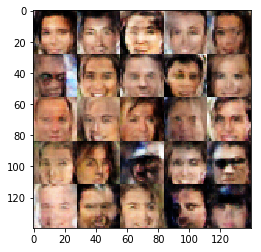

Epoch: 1/2 Discriminator Loss: 0.7901369333267212 Generator Loss: 1.8872034549713135
Epoch: 1/2 Discriminator Loss: 1.5278105735778809 Generator Loss: 1.1781847476959229
Epoch: 1/2 Discriminator Loss: 0.7415376901626587 Generator Loss: 1.252403736114502
Epoch: 1/2 Discriminator Loss: 0.7949469089508057 Generator Loss: 1.5360149145126343
Epoch: 1/2 Discriminator Loss: 1.1390169858932495 Generator Loss: 2.274956703186035
Epoch: 1/2 Discriminator Loss: 0.8527615666389465 Generator Loss: 2.2502098083496094
Epoch: 1/2 Discriminator Loss: 0.9214267134666443 Generator Loss: 0.8875313997268677
Epoch: 1/2 Discriminator Loss: 0.8423853516578674 Generator Loss: 1.6964452266693115
Epoch: 1/2 Discriminator Loss: 0.9107557535171509 Generator Loss: 2.7802703380584717
Epoch: 1/2 Discriminator Loss: 0.9574638605117798 Generator Loss: 1.6599469184875488


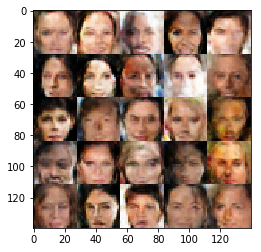

Epoch: 1/2 Discriminator Loss: 0.9361298680305481 Generator Loss: 0.7871336340904236
Epoch: 1/2 Discriminator Loss: 0.939020037651062 Generator Loss: 1.0457344055175781
Epoch: 1/2 Discriminator Loss: 0.6895496249198914 Generator Loss: 2.0763750076293945
Epoch: 1/2 Discriminator Loss: 1.101104736328125 Generator Loss: 2.4234228134155273
Epoch: 1/2 Discriminator Loss: 0.8289644718170166 Generator Loss: 2.022435188293457
Epoch: 1/2 Discriminator Loss: 0.9161556959152222 Generator Loss: 2.98152232170105
Epoch: 1/2 Discriminator Loss: 0.8084433078765869 Generator Loss: 2.1272268295288086
Epoch: 1/2 Discriminator Loss: 0.7715157866477966 Generator Loss: 1.836613655090332
Epoch: 1/2 Discriminator Loss: 0.6195738315582275 Generator Loss: 1.7361533641815186
Epoch: 1/2 Discriminator Loss: 1.3157923221588135 Generator Loss: 0.8682386875152588


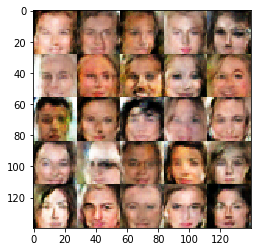

Epoch: 1/2 Discriminator Loss: 0.870410680770874 Generator Loss: 0.9791930913925171
Epoch: 1/2 Discriminator Loss: 1.13808012008667 Generator Loss: 1.8401453495025635
Epoch: 1/2 Discriminator Loss: 0.9926287531852722 Generator Loss: 1.4779490232467651
Epoch: 1/2 Discriminator Loss: 1.222917079925537 Generator Loss: 0.7831788063049316
Epoch: 1/2 Discriminator Loss: 0.8592028617858887 Generator Loss: 1.3794046640396118
Epoch: 1/2 Discriminator Loss: 0.5900682806968689 Generator Loss: 1.4415504932403564
Epoch: 1/2 Discriminator Loss: 0.8798465132713318 Generator Loss: 1.0042797327041626
Epoch: 1/2 Discriminator Loss: 1.1943199634552002 Generator Loss: 2.119318962097168
Epoch: 1/2 Discriminator Loss: 0.8057684302330017 Generator Loss: 1.668798565864563
Epoch: 1/2 Discriminator Loss: 1.0791172981262207 Generator Loss: 1.4366989135742188


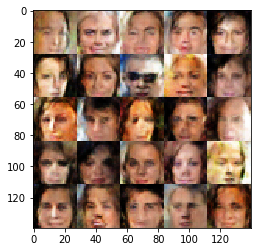

Epoch: 1/2 Discriminator Loss: 0.9332555532455444 Generator Loss: 0.919248104095459
Epoch: 1/2 Discriminator Loss: 0.8472231030464172 Generator Loss: 1.7350825071334839
Epoch: 1/2 Discriminator Loss: 0.49992841482162476 Generator Loss: 1.6076503992080688
Epoch: 1/2 Discriminator Loss: 0.9756019115447998 Generator Loss: 2.05979585647583
Epoch: 1/2 Discriminator Loss: 0.7484748363494873 Generator Loss: 1.3855295181274414
Epoch: 1/2 Discriminator Loss: 1.035258412361145 Generator Loss: 0.959242582321167
Epoch: 1/2 Discriminator Loss: 0.7456884980201721 Generator Loss: 1.4271094799041748
Epoch: 1/2 Discriminator Loss: 0.9664574265480042 Generator Loss: 1.5123430490493774
Epoch: 1/2 Discriminator Loss: 1.2442941665649414 Generator Loss: 2.0485823154449463
Epoch: 1/2 Discriminator Loss: 0.8128318786621094 Generator Loss: 1.3784881830215454


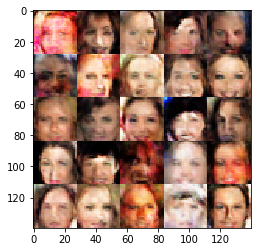

Epoch: 1/2 Discriminator Loss: 1.128638744354248 Generator Loss: 1.721016526222229
Epoch: 1/2 Discriminator Loss: 1.1120779514312744 Generator Loss: 2.037461996078491
Epoch: 1/2 Discriminator Loss: 0.6793885231018066 Generator Loss: 1.9236029386520386
Epoch: 1/2 Discriminator Loss: 0.7386530637741089 Generator Loss: 1.4203840494155884
Epoch: 1/2 Discriminator Loss: 0.8789973855018616 Generator Loss: 1.8859238624572754
Epoch: 1/2 Discriminator Loss: 0.7360432147979736 Generator Loss: 1.6333297491073608
Epoch: 1/2 Discriminator Loss: 0.782798707485199 Generator Loss: 1.5982725620269775
Epoch: 1/2 Discriminator Loss: 0.7132537364959717 Generator Loss: 1.8123586177825928
Epoch: 1/2 Discriminator Loss: 0.9872678518295288 Generator Loss: 1.6232632398605347
Epoch: 1/2 Discriminator Loss: 0.9141827821731567 Generator Loss: 1.6191693544387817


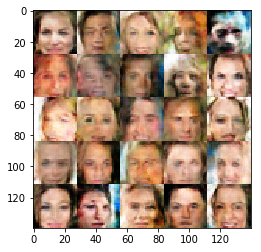

Epoch: 1/2 Discriminator Loss: 0.6921096444129944 Generator Loss: 1.3173787593841553
Epoch: 1/2 Discriminator Loss: 0.7490450143814087 Generator Loss: 1.1830717325210571
Epoch: 1/2 Discriminator Loss: 1.2304421663284302 Generator Loss: 0.6248552799224854
Epoch: 1/2 Discriminator Loss: 1.2185430526733398 Generator Loss: 1.917109727859497
Epoch: 1/2 Discriminator Loss: 0.9504558444023132 Generator Loss: 1.5421228408813477
Epoch: 1/2 Discriminator Loss: 1.0914077758789062 Generator Loss: 0.9920402765274048
Epoch: 1/2 Discriminator Loss: 1.3343451023101807 Generator Loss: 1.1100248098373413
Epoch: 1/2 Discriminator Loss: 1.010491967201233 Generator Loss: 2.471559524536133
Epoch: 1/2 Discriminator Loss: 0.6935367584228516 Generator Loss: 1.8783140182495117
Epoch: 1/2 Discriminator Loss: 0.8158650398254395 Generator Loss: 3.2019619941711426


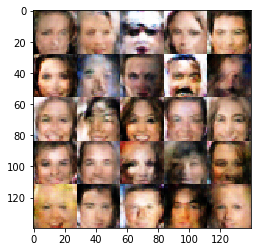

Epoch: 1/2 Discriminator Loss: 0.5480339527130127 Generator Loss: 2.502814292907715
Epoch: 1/2 Discriminator Loss: 1.2584202289581299 Generator Loss: 0.9949283599853516
Epoch: 1/2 Discriminator Loss: 1.1829771995544434 Generator Loss: 1.5580012798309326
Epoch: 1/2 Discriminator Loss: 0.9990417957305908 Generator Loss: 2.1124587059020996
Epoch: 1/2 Discriminator Loss: 0.8392622470855713 Generator Loss: 1.566040277481079
Epoch: 1/2 Discriminator Loss: 1.378942608833313 Generator Loss: 0.6442750692367554
Epoch: 1/2 Discriminator Loss: 1.095679521560669 Generator Loss: 1.24180269241333
Epoch: 1/2 Discriminator Loss: 0.7318044304847717 Generator Loss: 2.2062578201293945
Epoch: 1/2 Discriminator Loss: 0.8345463275909424 Generator Loss: 1.8078207969665527
Epoch: 1/2 Discriminator Loss: 1.0258322954177856 Generator Loss: 1.7910404205322266


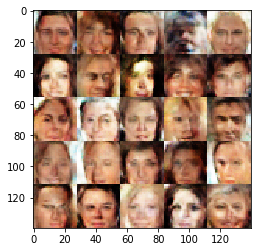

Epoch: 1/2 Discriminator Loss: 0.8574405312538147 Generator Loss: 2.1480772495269775
Epoch: 1/2 Discriminator Loss: 0.7560443878173828 Generator Loss: 1.0985212326049805
Epoch: 1/2 Discriminator Loss: 0.9613739252090454 Generator Loss: 2.142991542816162
Epoch: 1/2 Discriminator Loss: 0.6081198453903198 Generator Loss: 1.5159258842468262
Epoch: 1/2 Discriminator Loss: 0.9060901999473572 Generator Loss: 1.2508740425109863
Epoch: 1/2 Discriminator Loss: 0.8886719942092896 Generator Loss: 1.278934359550476
Epoch: 1/2 Discriminator Loss: 1.1449251174926758 Generator Loss: 1.350013256072998
Epoch: 1/2 Discriminator Loss: 1.144029974937439 Generator Loss: 1.1280674934387207
Epoch: 1/2 Discriminator Loss: 0.9183537364006042 Generator Loss: 1.8749210834503174
Epoch: 1/2 Discriminator Loss: 1.1202545166015625 Generator Loss: 2.0924272537231445


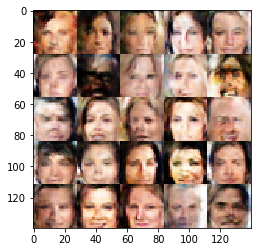

Epoch: 1/2 Discriminator Loss: 0.9431050419807434 Generator Loss: 2.3905515670776367
Epoch: 1/2 Discriminator Loss: 0.8040324449539185 Generator Loss: 2.140695333480835
Epoch: 1/2 Discriminator Loss: 0.7149471044540405 Generator Loss: 2.044607162475586
Epoch: 1/2 Discriminator Loss: 0.6669824719429016 Generator Loss: 1.926260232925415
Epoch: 1/2 Discriminator Loss: 1.1280136108398438 Generator Loss: 1.7083508968353271
Epoch: 1/2 Discriminator Loss: 1.4141943454742432 Generator Loss: 1.4997985363006592
Epoch: 1/2 Discriminator Loss: 1.1398828029632568 Generator Loss: 1.3549048900604248
Epoch: 1/2 Discriminator Loss: 0.6639886498451233 Generator Loss: 1.6355935335159302
Epoch: 1/2 Discriminator Loss: 1.0515234470367432 Generator Loss: 1.2254894971847534
Epoch: 1/2 Discriminator Loss: 0.8352882862091064 Generator Loss: 1.5682120323181152


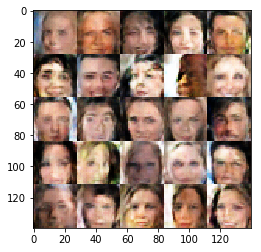

Epoch: 1/2 Discriminator Loss: 0.9778350591659546 Generator Loss: 1.9716858863830566
Epoch: 1/2 Discriminator Loss: 0.8502647876739502 Generator Loss: 1.5017808675765991
Epoch: 1/2 Discriminator Loss: 0.9287482500076294 Generator Loss: 2.0028858184814453
Epoch: 1/2 Discriminator Loss: 0.8372406959533691 Generator Loss: 0.9968878030776978
Epoch: 1/2 Discriminator Loss: 0.7134453654289246 Generator Loss: 1.6194591522216797
Epoch: 1/2 Discriminator Loss: 0.7431121468544006 Generator Loss: 1.7027662992477417
Epoch: 1/2 Discriminator Loss: 1.259110450744629 Generator Loss: 1.5845485925674438
Epoch: 1/2 Discriminator Loss: 0.7717497944831848 Generator Loss: 1.9619828462600708
Epoch: 1/2 Discriminator Loss: 0.5543164610862732 Generator Loss: 1.4062299728393555
Epoch: 1/2 Discriminator Loss: 0.7806015014648438 Generator Loss: 1.7871493101119995


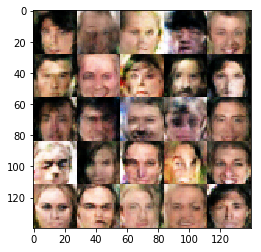

Epoch: 1/2 Discriminator Loss: 0.7555025815963745 Generator Loss: 2.9898033142089844
Epoch: 1/2 Discriminator Loss: 1.174023151397705 Generator Loss: 0.884691059589386
Epoch: 1/2 Discriminator Loss: 0.8475381135940552 Generator Loss: 1.1427608728408813
Epoch: 1/2 Discriminator Loss: 1.0151495933532715 Generator Loss: 0.9278062582015991
Epoch: 1/2 Discriminator Loss: 1.0740959644317627 Generator Loss: 0.9257742762565613
Epoch: 1/2 Discriminator Loss: 0.9272966384887695 Generator Loss: 3.5256905555725098
Epoch: 1/2 Discriminator Loss: 1.0366735458374023 Generator Loss: 1.0847491025924683
Epoch: 1/2 Discriminator Loss: 1.014704942703247 Generator Loss: 1.242846131324768
Epoch: 1/2 Discriminator Loss: 1.1005029678344727 Generator Loss: 1.2093926668167114
Epoch: 1/2 Discriminator Loss: 0.9970862865447998 Generator Loss: 0.8945758938789368


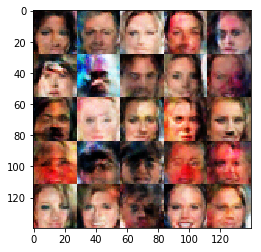

Epoch: 1/2 Discriminator Loss: 0.7125018835067749 Generator Loss: 1.3452391624450684
Epoch: 1/2 Discriminator Loss: 1.2441942691802979 Generator Loss: 0.6848569512367249
Epoch: 1/2 Discriminator Loss: 1.5177125930786133 Generator Loss: 1.8801013231277466
Epoch: 1/2 Discriminator Loss: 0.7457836866378784 Generator Loss: 2.334721565246582
Epoch: 1/2 Discriminator Loss: 0.9524160623550415 Generator Loss: 2.1110363006591797
Epoch: 1/2 Discriminator Loss: 0.8631684184074402 Generator Loss: 1.1186984777450562
Epoch: 1/2 Discriminator Loss: 0.9348641037940979 Generator Loss: 2.2839815616607666
Epoch: 1/2 Discriminator Loss: 0.9625355005264282 Generator Loss: 1.7086079120635986
Epoch: 1/2 Discriminator Loss: 0.9894165992736816 Generator Loss: 2.135693073272705
Epoch: 1/2 Discriminator Loss: 0.6488305926322937 Generator Loss: 1.81638503074646


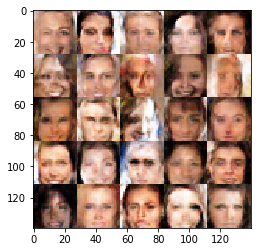

Epoch: 1/2 Discriminator Loss: 1.0407702922821045 Generator Loss: 2.692634344100952
Epoch: 1/2 Discriminator Loss: 1.0973422527313232 Generator Loss: 0.9413372278213501
Epoch: 1/2 Discriminator Loss: 1.0492522716522217 Generator Loss: 1.0571246147155762
Epoch: 1/2 Discriminator Loss: 0.8576614856719971 Generator Loss: 2.4688031673431396
Epoch: 1/2 Discriminator Loss: 0.7121195197105408 Generator Loss: 2.015054225921631
Epoch: 1/2 Discriminator Loss: 0.6430166363716125 Generator Loss: 1.8372013568878174
Epoch: 1/2 Discriminator Loss: 0.6795530319213867 Generator Loss: 1.9182243347167969
Epoch: 1/2 Discriminator Loss: 0.5674217343330383 Generator Loss: 1.8218581676483154
Epoch: 1/2 Discriminator Loss: 0.9810531139373779 Generator Loss: 2.5077948570251465
Epoch: 1/2 Discriminator Loss: 0.8203487396240234 Generator Loss: 1.8193541765213013


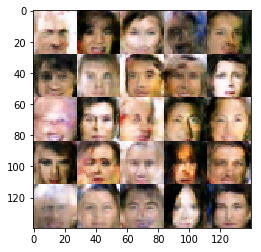

Epoch: 1/2 Discriminator Loss: 0.7727138996124268 Generator Loss: 1.7769978046417236
Epoch: 1/2 Discriminator Loss: 0.5953366160392761 Generator Loss: 1.9232350587844849
Epoch: 1/2 Discriminator Loss: 1.019425392150879 Generator Loss: 2.0257863998413086
Epoch: 1/2 Discriminator Loss: 0.9971585869789124 Generator Loss: 2.2850444316864014
Epoch: 1/2 Discriminator Loss: 0.7985354661941528 Generator Loss: 1.3424441814422607
Epoch: 1/2 Discriminator Loss: 0.7858332395553589 Generator Loss: 1.1400887966156006
Epoch: 1/2 Discriminator Loss: 0.7023793458938599 Generator Loss: 2.595396041870117
Epoch: 1/2 Discriminator Loss: 0.7490169405937195 Generator Loss: 2.884406089782715
Epoch: 1/2 Discriminator Loss: 0.7513288259506226 Generator Loss: 2.294684886932373
Epoch: 1/2 Discriminator Loss: 1.0462403297424316 Generator Loss: 0.9506154656410217


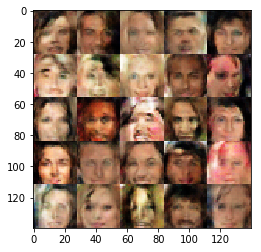

Epoch: 1/2 Discriminator Loss: 0.7865819931030273 Generator Loss: 1.2436509132385254
Epoch: 1/2 Discriminator Loss: 0.8086961507797241 Generator Loss: 1.4464356899261475
Epoch: 1/2 Discriminator Loss: 0.6083682775497437 Generator Loss: 1.8217583894729614
Epoch: 1/2 Discriminator Loss: 0.7217333316802979 Generator Loss: 1.5929276943206787
Epoch: 1/2 Discriminator Loss: 0.5195361971855164 Generator Loss: 1.5221836566925049
Epoch: 1/2 Discriminator Loss: 1.3808461427688599 Generator Loss: 1.9373606443405151
Epoch: 1/2 Discriminator Loss: 0.9889951944351196 Generator Loss: 2.280975341796875
Epoch: 1/2 Discriminator Loss: 1.035265564918518 Generator Loss: 1.871992826461792
Epoch: 1/2 Discriminator Loss: 0.6335258483886719 Generator Loss: 2.4334018230438232
Epoch: 1/2 Discriminator Loss: 1.0304265022277832 Generator Loss: 2.2777953147888184


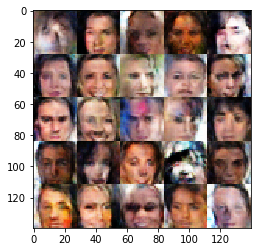

Epoch: 1/2 Discriminator Loss: 1.257798671722412 Generator Loss: 1.4470280408859253
Epoch: 1/2 Discriminator Loss: 1.392613172531128 Generator Loss: 0.5880842208862305
Epoch: 1/2 Discriminator Loss: 0.6198985576629639 Generator Loss: 2.765044927597046
Epoch: 1/2 Discriminator Loss: 0.8111633658409119 Generator Loss: 2.275716781616211
Epoch: 1/2 Discriminator Loss: 0.6313613653182983 Generator Loss: 2.481476068496704
Epoch: 1/2 Discriminator Loss: 0.8992854952812195 Generator Loss: 1.245788335800171
Epoch: 1/2 Discriminator Loss: 1.089731216430664 Generator Loss: 0.6491079926490784
Epoch: 1/2 Discriminator Loss: 1.343864917755127 Generator Loss: 0.41734516620635986
Epoch: 1/2 Discriminator Loss: 0.7965264916419983 Generator Loss: 1.8931808471679688
Epoch: 1/2 Discriminator Loss: 0.7024862766265869 Generator Loss: 2.741769790649414


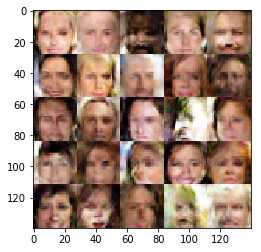

Epoch: 1/2 Discriminator Loss: 1.4080541133880615 Generator Loss: 1.1873691082000732
Epoch: 1/2 Discriminator Loss: 0.7984727621078491 Generator Loss: 2.7450857162475586
Epoch: 1/2 Discriminator Loss: 0.6363698840141296 Generator Loss: 1.7678935527801514
Epoch: 1/2 Discriminator Loss: 0.8425276279449463 Generator Loss: 2.4550533294677734
Epoch: 1/2 Discriminator Loss: 1.1107513904571533 Generator Loss: 1.8283628225326538
Epoch: 1/2 Discriminator Loss: 1.122998833656311 Generator Loss: 1.8761062622070312
Epoch: 1/2 Discriminator Loss: 0.512387216091156 Generator Loss: 1.8803715705871582
Epoch: 1/2 Discriminator Loss: 0.725071132183075 Generator Loss: 1.8278628587722778
Epoch: 1/2 Discriminator Loss: 0.7932616472244263 Generator Loss: 1.5204435586929321
Epoch: 1/2 Discriminator Loss: 1.064906358718872 Generator Loss: 2.221412181854248


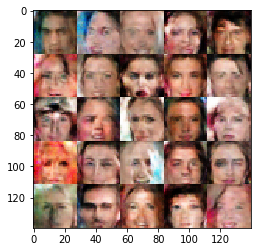

Epoch: 1/2 Discriminator Loss: 0.6862159967422485 Generator Loss: 2.0892257690429688
Epoch: 1/2 Discriminator Loss: 0.9091002941131592 Generator Loss: 1.61485755443573
Epoch: 1/2 Discriminator Loss: 0.4988230764865875 Generator Loss: 2.570779323577881
Epoch: 1/2 Discriminator Loss: 0.8834500312805176 Generator Loss: 2.574699878692627
Epoch: 1/2 Discriminator Loss: 0.8733752369880676 Generator Loss: 1.7972091436386108
Epoch: 1/2 Discriminator Loss: 0.970072329044342 Generator Loss: 2.6713547706604004
Epoch: 1/2 Discriminator Loss: 0.851402997970581 Generator Loss: 1.5992655754089355
Epoch: 1/2 Discriminator Loss: 0.685066819190979 Generator Loss: 1.4660173654556274
Epoch: 1/2 Discriminator Loss: 0.8594579100608826 Generator Loss: 2.416125774383545
Epoch: 1/2 Discriminator Loss: 1.143833041191101 Generator Loss: 0.8563637137413025


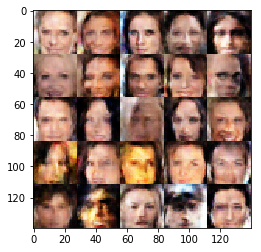

Epoch: 1/2 Discriminator Loss: 0.9458980560302734 Generator Loss: 2.1922993659973145
Epoch: 1/2 Discriminator Loss: 0.6445765495300293 Generator Loss: 1.2825675010681152
Epoch: 1/2 Discriminator Loss: 0.927740752696991 Generator Loss: 1.7033402919769287
Epoch: 1/2 Discriminator Loss: 0.7353453636169434 Generator Loss: 1.4754445552825928
Epoch: 1/2 Discriminator Loss: 0.7081379890441895 Generator Loss: 2.0892834663391113
Epoch: 1/2 Discriminator Loss: 0.7491120100021362 Generator Loss: 2.1374285221099854
Epoch: 1/2 Discriminator Loss: 0.8141481876373291 Generator Loss: 2.9771783351898193
Epoch: 1/2 Discriminator Loss: 0.9440783262252808 Generator Loss: 2.340695858001709
Epoch: 1/2 Discriminator Loss: 0.8836162686347961 Generator Loss: 1.5755423307418823
Epoch: 1/2 Discriminator Loss: 1.1857203245162964 Generator Loss: 1.031131386756897


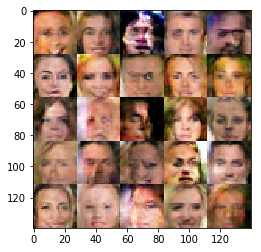

Epoch: 1/2 Discriminator Loss: 0.5693403482437134 Generator Loss: 1.8417567014694214
Epoch: 1/2 Discriminator Loss: 0.6774688363075256 Generator Loss: 2.3476483821868896
Epoch: 1/2 Discriminator Loss: 0.6564660668373108 Generator Loss: 1.5968198776245117
Epoch: 1/2 Discriminator Loss: 0.8829059600830078 Generator Loss: 2.1228575706481934
Epoch: 1/2 Discriminator Loss: 0.96300208568573 Generator Loss: 1.1073286533355713
Epoch: 1/2 Discriminator Loss: 1.0081679821014404 Generator Loss: 2.1770238876342773
Epoch: 1/2 Discriminator Loss: 1.1013469696044922 Generator Loss: 1.6402347087860107
Epoch: 1/2 Discriminator Loss: 0.7540561556816101 Generator Loss: 2.744032382965088
Epoch: 1/2 Discriminator Loss: 0.8639624118804932 Generator Loss: 1.3577245473861694
Epoch: 1/2 Discriminator Loss: 1.031862735748291 Generator Loss: 0.65981125831604


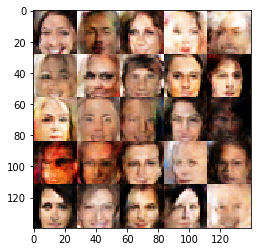

Epoch: 1/2 Discriminator Loss: 0.8195914030075073 Generator Loss: 1.6664788722991943
Epoch: 1/2 Discriminator Loss: 0.8981387615203857 Generator Loss: 2.3890604972839355
Epoch: 1/2 Discriminator Loss: 0.9788521528244019 Generator Loss: 0.7748149633407593
Epoch: 1/2 Discriminator Loss: 0.6944960355758667 Generator Loss: 0.864725649356842
Epoch: 1/2 Discriminator Loss: 0.9615082740783691 Generator Loss: 1.834829330444336
Epoch: 1/2 Discriminator Loss: 0.6645177602767944 Generator Loss: 1.7531505823135376
Epoch: 1/2 Discriminator Loss: 0.8275554180145264 Generator Loss: 1.7626898288726807
Epoch: 1/2 Discriminator Loss: 1.1640262603759766 Generator Loss: 0.6900978088378906
Epoch: 1/2 Discriminator Loss: 0.7617796659469604 Generator Loss: 3.251152276992798
Epoch: 1/2 Discriminator Loss: 0.6395938396453857 Generator Loss: 1.7678852081298828


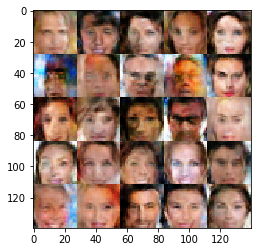

Epoch: 1/2 Discriminator Loss: 0.9225157499313354 Generator Loss: 1.5928714275360107
Epoch: 1/2 Discriminator Loss: 0.9368464350700378 Generator Loss: 0.831757128238678
Epoch: 1/2 Discriminator Loss: 0.8467172384262085 Generator Loss: 2.6800286769866943
Epoch: 1/2 Discriminator Loss: 0.8564297556877136 Generator Loss: 1.5416884422302246
Epoch: 1/2 Discriminator Loss: 1.2905735969543457 Generator Loss: 1.7669137716293335
Epoch: 1/2 Discriminator Loss: 0.6657100319862366 Generator Loss: 1.668651819229126
Epoch: 1/2 Discriminator Loss: 0.6623495817184448 Generator Loss: 1.862823247909546
Epoch: 1/2 Discriminator Loss: 0.7073986530303955 Generator Loss: 1.8479197025299072
Epoch: 1/2 Discriminator Loss: 0.9967899322509766 Generator Loss: 0.8754865527153015
Epoch: 1/2 Discriminator Loss: 1.0166488885879517 Generator Loss: 2.688784599304199


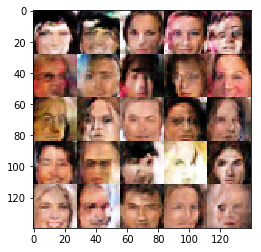

Epoch: 1/2 Discriminator Loss: 0.7070913314819336 Generator Loss: 1.7928314208984375
Epoch: 1/2 Discriminator Loss: 0.979985773563385 Generator Loss: 1.98955500125885
Epoch: 1/2 Discriminator Loss: 0.9215255975723267 Generator Loss: 1.536789059638977
Epoch: 1/2 Discriminator Loss: 0.7936669588088989 Generator Loss: 1.9423052072525024
Epoch: 1/2 Discriminator Loss: 1.2162210941314697 Generator Loss: 1.0144611597061157
Epoch: 1/2 Discriminator Loss: 1.143664002418518 Generator Loss: 1.5163137912750244
Epoch: 1/2 Discriminator Loss: 0.806094765663147 Generator Loss: 1.590524673461914
Epoch: 1/2 Discriminator Loss: 0.6452966928482056 Generator Loss: 1.417293667793274
Epoch: 1/2 Discriminator Loss: 1.2288024425506592 Generator Loss: 2.739068031311035
Epoch: 1/2 Discriminator Loss: 0.7922713756561279 Generator Loss: 2.1620867252349854


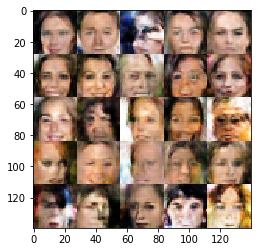

Epoch: 1/2 Discriminator Loss: 0.8859026432037354 Generator Loss: 1.7678911685943604
Epoch: 1/2 Discriminator Loss: 0.5413035154342651 Generator Loss: 2.6631879806518555
Epoch: 1/2 Discriminator Loss: 0.8231569528579712 Generator Loss: 1.90935218334198
Epoch: 1/2 Discriminator Loss: 0.7662002444267273 Generator Loss: 0.9256694316864014
Epoch: 1/2 Discriminator Loss: 0.6831965446472168 Generator Loss: 2.1484296321868896
Epoch: 1/2 Discriminator Loss: 1.4071385860443115 Generator Loss: 0.8489358425140381
Epoch: 1/2 Discriminator Loss: 0.6084342002868652 Generator Loss: 2.4992024898529053
Epoch: 1/2 Discriminator Loss: 1.0940455198287964 Generator Loss: 2.180835008621216
Epoch: 1/2 Discriminator Loss: 0.944179892539978 Generator Loss: 0.564297080039978
Epoch: 1/2 Discriminator Loss: 0.509017288684845 Generator Loss: 1.3685390949249268


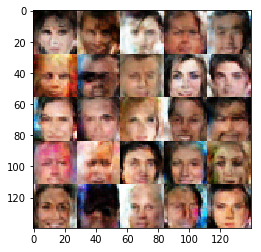

Epoch: 1/2 Discriminator Loss: 1.0916924476623535 Generator Loss: 0.9632271528244019
Epoch: 1/2 Discriminator Loss: 0.8536504507064819 Generator Loss: 2.9595255851745605
Epoch: 1/2 Discriminator Loss: 1.1908600330352783 Generator Loss: 1.495713472366333
Epoch: 1/2 Discriminator Loss: 1.5785022974014282 Generator Loss: 0.4621184468269348
Epoch: 1/2 Discriminator Loss: 0.8676500916481018 Generator Loss: 2.4062037467956543
Epoch: 1/2 Discriminator Loss: 1.4298126697540283 Generator Loss: 0.7699354290962219
Epoch: 1/2 Discriminator Loss: 0.7802219390869141 Generator Loss: 1.0128099918365479
Epoch: 1/2 Discriminator Loss: 0.8213570713996887 Generator Loss: 1.7638649940490723
Epoch: 1/2 Discriminator Loss: 0.7085773944854736 Generator Loss: 2.0658092498779297
Epoch: 1/2 Discriminator Loss: 0.8226785659790039 Generator Loss: 2.549042224884033


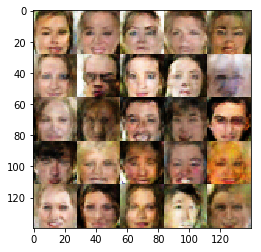

Epoch: 1/2 Discriminator Loss: 1.0848042964935303 Generator Loss: 0.8861437439918518
Epoch: 1/2 Discriminator Loss: 1.1422028541564941 Generator Loss: 1.4355666637420654
Epoch: 1/2 Discriminator Loss: 0.9943501949310303 Generator Loss: 0.9503052234649658
Epoch: 1/2 Discriminator Loss: 0.623223602771759 Generator Loss: 1.5180933475494385
Epoch: 1/2 Discriminator Loss: 0.5483477711677551 Generator Loss: 2.321084499359131
Epoch: 1/2 Discriminator Loss: 0.7434090375900269 Generator Loss: 3.1837940216064453
Epoch: 1/2 Discriminator Loss: 0.47422242164611816 Generator Loss: 1.3088831901550293
Epoch: 1/2 Discriminator Loss: 0.5990475416183472 Generator Loss: 1.7964673042297363
Epoch: 1/2 Discriminator Loss: 0.9290224313735962 Generator Loss: 1.2706712484359741
Epoch: 1/2 Discriminator Loss: 0.6297781467437744 Generator Loss: 2.5106983184814453


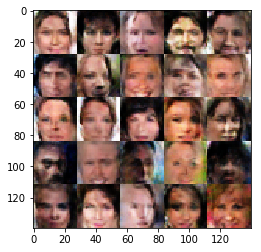

Epoch: 1/2 Discriminator Loss: 0.7767988443374634 Generator Loss: 1.9006507396697998
Epoch: 1/2 Discriminator Loss: 0.936034619808197 Generator Loss: 3.47019624710083
Epoch: 1/2 Discriminator Loss: 0.9473541378974915 Generator Loss: 1.3293378353118896
Epoch: 1/2 Discriminator Loss: 1.2141611576080322 Generator Loss: 1.6505306959152222
Epoch: 1/2 Discriminator Loss: 0.8619579076766968 Generator Loss: 1.352927803993225
Epoch: 1/2 Discriminator Loss: 0.7052794694900513 Generator Loss: 1.2251110076904297
Epoch: 1/2 Discriminator Loss: 0.9082493782043457 Generator Loss: 0.9051889777183533
Epoch: 1/2 Discriminator Loss: 0.687075138092041 Generator Loss: 1.5953590869903564
Epoch: 1/2 Discriminator Loss: 1.0245893001556396 Generator Loss: 1.6561932563781738
Epoch: 1/2 Discriminator Loss: 1.0519769191741943 Generator Loss: 2.482525110244751


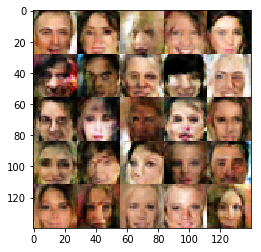

Epoch: 1/2 Discriminator Loss: 0.7429426908493042 Generator Loss: 1.5863419771194458
Epoch: 1/2 Discriminator Loss: 1.0662730932235718 Generator Loss: 1.0381108522415161
Epoch: 1/2 Discriminator Loss: 1.318160057067871 Generator Loss: 3.2887494564056396
Epoch: 1/2 Discriminator Loss: 0.8713937997817993 Generator Loss: 3.640902280807495
Epoch: 1/2 Discriminator Loss: 1.0787454843521118 Generator Loss: 2.202585220336914
Epoch: 1/2 Discriminator Loss: 1.0412064790725708 Generator Loss: 1.2049068212509155
Epoch: 1/2 Discriminator Loss: 1.3103981018066406 Generator Loss: 2.2966537475585938
Epoch: 1/2 Discriminator Loss: 1.0718134641647339 Generator Loss: 1.9706041812896729
Epoch: 1/2 Discriminator Loss: 0.7345908880233765 Generator Loss: 2.2238030433654785
Epoch: 1/2 Discriminator Loss: 0.7348020076751709 Generator Loss: 1.870524525642395


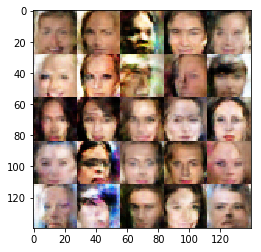

Epoch: 1/2 Discriminator Loss: 0.6404590606689453 Generator Loss: 1.0101721286773682
Epoch: 1/2 Discriminator Loss: 0.7736880779266357 Generator Loss: 0.8908895254135132
Epoch: 1/2 Discriminator Loss: 1.0162384510040283 Generator Loss: 0.971768856048584
Epoch: 1/2 Discriminator Loss: 0.5453563928604126 Generator Loss: 1.8808127641677856
Epoch: 1/2 Discriminator Loss: 0.654312014579773 Generator Loss: 1.3618719577789307
Epoch: 1/2 Discriminator Loss: 0.816065788269043 Generator Loss: 1.3994030952453613
Epoch: 1/2 Discriminator Loss: 1.5324803590774536 Generator Loss: 1.3847904205322266
Epoch: 1/2 Discriminator Loss: 0.9061647653579712 Generator Loss: 2.031310796737671
Epoch: 1/2 Discriminator Loss: 1.117460012435913 Generator Loss: 1.5281434059143066
Epoch: 1/2 Discriminator Loss: 0.8903802037239075 Generator Loss: 2.622371196746826


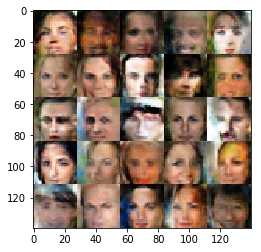

Epoch: 1/2 Discriminator Loss: 0.8472075462341309 Generator Loss: 0.9946073889732361
Epoch: 1/2 Discriminator Loss: 0.7521145343780518 Generator Loss: 2.505310297012329
Epoch: 1/2 Discriminator Loss: 0.7106422185897827 Generator Loss: 2.733306646347046
Epoch: 1/2 Discriminator Loss: 1.095654010772705 Generator Loss: 1.30106782913208
Epoch: 1/2 Discriminator Loss: 1.0225672721862793 Generator Loss: 1.8554201126098633
Epoch: 1/2 Discriminator Loss: 0.7243258357048035 Generator Loss: 1.5251834392547607
Epoch: 1/2 Discriminator Loss: 0.6661791801452637 Generator Loss: 1.0705150365829468
Epoch: 1/2 Discriminator Loss: 0.7281614542007446 Generator Loss: 0.9314991235733032
Epoch: 1/2 Discriminator Loss: 0.7097963094711304 Generator Loss: 1.7940123081207275
Epoch: 1/2 Discriminator Loss: 0.7156088352203369 Generator Loss: 1.1506391763687134


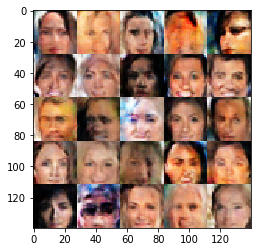

Epoch: 1/2 Discriminator Loss: 0.9303002953529358 Generator Loss: 2.347184181213379
Epoch: 1/2 Discriminator Loss: 1.277425765991211 Generator Loss: 1.1467010974884033
Epoch: 1/2 Discriminator Loss: 0.7405418157577515 Generator Loss: 1.4619851112365723
Epoch: 1/2 Discriminator Loss: 0.6661635637283325 Generator Loss: 1.4621012210845947
Epoch: 1/2 Discriminator Loss: 0.6782598495483398 Generator Loss: 1.7955472469329834
Epoch: 1/2 Discriminator Loss: 0.5874983072280884 Generator Loss: 2.479077100753784
Epoch: 1/2 Discriminator Loss: 0.7608164548873901 Generator Loss: 1.7237380743026733
Epoch: 1/2 Discriminator Loss: 0.8527247905731201 Generator Loss: 1.9520069360733032
Epoch: 1/2 Discriminator Loss: 0.9694567918777466 Generator Loss: 0.8992206454277039
Epoch: 1/2 Discriminator Loss: 0.7086441516876221 Generator Loss: 2.0840814113616943


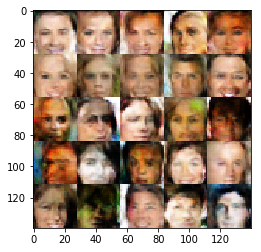

Epoch: 1/2 Discriminator Loss: 0.728135347366333 Generator Loss: 1.4707822799682617
Epoch: 1/2 Discriminator Loss: 0.6705881357192993 Generator Loss: 0.9036343097686768
Epoch: 1/2 Discriminator Loss: 0.638598620891571 Generator Loss: 3.00093412399292
Epoch: 1/2 Discriminator Loss: 1.0982882976531982 Generator Loss: 2.141122817993164
Epoch: 1/2 Discriminator Loss: 0.8692600131034851 Generator Loss: 1.8544611930847168
Epoch: 1/2 Discriminator Loss: 0.7824668288230896 Generator Loss: 1.7190892696380615
Epoch: 1/2 Discriminator Loss: 0.5304990410804749 Generator Loss: 1.4337711334228516
Epoch: 1/2 Discriminator Loss: 0.8006225228309631 Generator Loss: 1.6644233465194702
Epoch: 1/2 Discriminator Loss: 1.0126208066940308 Generator Loss: 1.6724755764007568
Epoch: 1/2 Discriminator Loss: 0.9202775955200195 Generator Loss: 0.9236495494842529


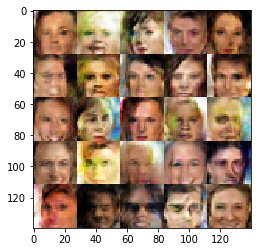

Epoch: 1/2 Discriminator Loss: 0.7365676164627075 Generator Loss: 1.4768363237380981
Epoch: 1/2 Discriminator Loss: 0.8010210990905762 Generator Loss: 1.3089362382888794
Epoch: 1/2 Discriminator Loss: 0.900606095790863 Generator Loss: 1.51909601688385
Epoch: 1/2 Discriminator Loss: 0.6682004928588867 Generator Loss: 2.8904967308044434
Epoch: 1/2 Discriminator Loss: 0.7431025505065918 Generator Loss: 1.811554193496704
Epoch: 1/2 Discriminator Loss: 0.6826505661010742 Generator Loss: 2.155122995376587
Epoch: 1/2 Discriminator Loss: 0.9951519966125488 Generator Loss: 1.380895733833313
Epoch: 1/2 Discriminator Loss: 2.0215935707092285 Generator Loss: 0.7065747976303101
Epoch: 1/2 Discriminator Loss: 0.8300079107284546 Generator Loss: 1.436450481414795
Epoch: 1/2 Discriminator Loss: 0.7866359949111938 Generator Loss: 2.702582836151123


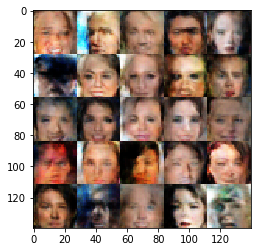

Epoch: 1/2 Discriminator Loss: 1.1306909322738647 Generator Loss: 1.6582785844802856
Epoch: 1/2 Discriminator Loss: 0.6908459663391113 Generator Loss: 2.568345546722412
Epoch: 1/2 Discriminator Loss: 0.823534369468689 Generator Loss: 1.82136070728302
Epoch: 1/2 Discriminator Loss: 1.0513968467712402 Generator Loss: 2.316368341445923
Epoch: 1/2 Discriminator Loss: 1.0801222324371338 Generator Loss: 2.254005193710327
Epoch: 1/2 Discriminator Loss: 1.0222389698028564 Generator Loss: 2.778115749359131
Epoch: 1/2 Discriminator Loss: 0.6294593811035156 Generator Loss: 1.692460298538208
Epoch: 1/2 Discriminator Loss: 0.6524348258972168 Generator Loss: 1.762376070022583
Epoch: 1/2 Discriminator Loss: 0.777614951133728 Generator Loss: 3.2323169708251953
Epoch: 1/2 Discriminator Loss: 0.8058965802192688 Generator Loss: 1.445372223854065


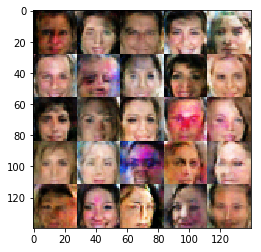

Epoch: 1/2 Discriminator Loss: 0.759918749332428 Generator Loss: 2.4624104499816895
Epoch: 1/2 Discriminator Loss: 0.730527937412262 Generator Loss: 1.788962960243225
Epoch: 1/2 Discriminator Loss: 0.7513418197631836 Generator Loss: 2.196871519088745
Epoch: 1/2 Discriminator Loss: 0.5211113691329956 Generator Loss: 2.439957618713379
Epoch: 1/2 Discriminator Loss: 0.9665868282318115 Generator Loss: 1.6250605583190918
Epoch: 1/2 Discriminator Loss: 0.6312903165817261 Generator Loss: 0.5929239988327026
Epoch: 1/2 Discriminator Loss: 1.230689525604248 Generator Loss: 2.621884346008301
Epoch: 1/2 Discriminator Loss: 0.8662919998168945 Generator Loss: 1.8087493181228638
Epoch: 1/2 Discriminator Loss: 1.056300163269043 Generator Loss: 2.4677910804748535
Epoch: 1/2 Discriminator Loss: 1.2423713207244873 Generator Loss: 2.523573398590088


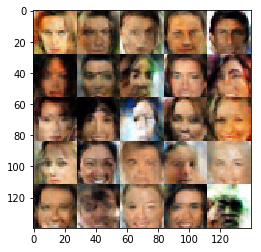

Epoch: 1/2 Discriminator Loss: 0.7209533452987671 Generator Loss: 2.528928518295288
Epoch: 1/2 Discriminator Loss: 1.1103347539901733 Generator Loss: 0.678658127784729
Epoch: 1/2 Discriminator Loss: 1.0139371156692505 Generator Loss: 1.1857306957244873
Epoch: 1/2 Discriminator Loss: 0.6708841323852539 Generator Loss: 1.492936372756958
Epoch: 1/2 Discriminator Loss: 0.8910496234893799 Generator Loss: 1.367431640625
Epoch: 1/2 Discriminator Loss: 0.9047282338142395 Generator Loss: 1.5243656635284424
Epoch: 1/2 Discriminator Loss: 0.6345295906066895 Generator Loss: 1.6899627447128296
Epoch: 1/2 Discriminator Loss: 0.8645004630088806 Generator Loss: 1.2273106575012207
Epoch: 1/2 Discriminator Loss: 0.5469626188278198 Generator Loss: 2.0332741737365723
Epoch: 1/2 Discriminator Loss: 0.709291934967041 Generator Loss: 1.6733484268188477


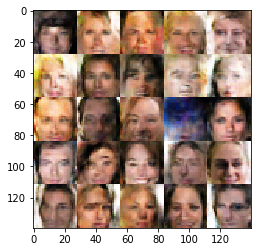

Epoch: 1/2 Discriminator Loss: 0.8226709365844727 Generator Loss: 2.151684045791626
Epoch: 1/2 Discriminator Loss: 1.1653543710708618 Generator Loss: 3.174771547317505
Epoch: 1/2 Discriminator Loss: 0.8447154760360718 Generator Loss: 1.3339897394180298
Epoch: 1/2 Discriminator Loss: 1.4283761978149414 Generator Loss: 0.9815459251403809
Epoch: 1/2 Discriminator Loss: 0.7590141892433167 Generator Loss: 1.449223518371582
Epoch: 1/2 Discriminator Loss: 0.9175075888633728 Generator Loss: 1.8427860736846924
Epoch: 1/2 Discriminator Loss: 0.6498419046401978 Generator Loss: 1.1869137287139893
Epoch: 1/2 Discriminator Loss: 0.5796241760253906 Generator Loss: 1.9983627796173096
Epoch: 1/2 Discriminator Loss: 0.5518394708633423 Generator Loss: 0.8093016147613525
Epoch: 1/2 Discriminator Loss: 0.9771428108215332 Generator Loss: 0.929396390914917


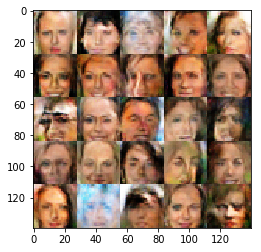

Epoch: 1/2 Discriminator Loss: 0.6973488330841064 Generator Loss: 2.5480239391326904
Epoch: 1/2 Discriminator Loss: 0.771364688873291 Generator Loss: 1.5216245651245117
Epoch: 1/2 Discriminator Loss: 1.2349828481674194 Generator Loss: 1.6957371234893799
Epoch: 1/2 Discriminator Loss: 0.6782827377319336 Generator Loss: 1.7946767807006836
Epoch: 1/2 Discriminator Loss: 0.5585824847221375 Generator Loss: 1.677950143814087
Epoch: 1/2 Discriminator Loss: 1.0274121761322021 Generator Loss: 0.33816254138946533
Epoch: 1/2 Discriminator Loss: 0.7385962009429932 Generator Loss: 1.1917479038238525
Epoch: 1/2 Discriminator Loss: 0.868726372718811 Generator Loss: 1.400673747062683
Epoch: 1/2 Discriminator Loss: 0.7660418748855591 Generator Loss: 1.9364780187606812
Epoch: 1/2 Discriminator Loss: 1.0495604276657104 Generator Loss: 1.1489815711975098


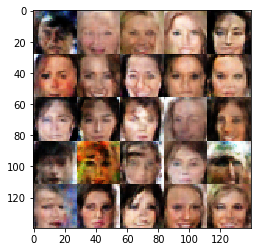

Epoch: 1/2 Discriminator Loss: 0.8397163152694702 Generator Loss: 0.38176488876342773
Epoch: 1/2 Discriminator Loss: 0.8260208964347839 Generator Loss: 2.1983113288879395
Epoch: 1/2 Discriminator Loss: 0.8311977386474609 Generator Loss: 0.8852826356887817
Epoch: 1/2 Discriminator Loss: 0.723862886428833 Generator Loss: 2.396939277648926
Epoch: 1/2 Discriminator Loss: 1.7549068927764893 Generator Loss: 0.39969998598098755
Epoch: 1/2 Discriminator Loss: 0.6984667181968689 Generator Loss: 2.1369266510009766
Epoch: 1/2 Discriminator Loss: 0.5438944101333618 Generator Loss: 2.3066139221191406
Epoch: 1/2 Discriminator Loss: 1.0710594654083252 Generator Loss: 1.5423939228057861
Epoch: 1/2 Discriminator Loss: 0.6214238405227661 Generator Loss: 2.22585391998291
Epoch: 1/2 Discriminator Loss: 0.6777154207229614 Generator Loss: 2.2371134757995605


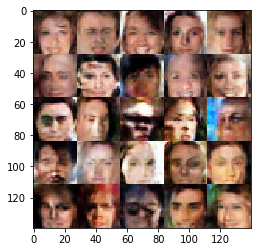

Epoch: 1/2 Discriminator Loss: 0.9008042812347412 Generator Loss: 3.4226207733154297
Epoch: 1/2 Discriminator Loss: 0.6279063820838928 Generator Loss: 2.6719164848327637
Epoch: 1/2 Discriminator Loss: 1.4846769571304321 Generator Loss: 2.103804588317871
Epoch: 1/2 Discriminator Loss: 0.8213958144187927 Generator Loss: 1.8322527408599854
Epoch: 1/2 Discriminator Loss: 0.8570070266723633 Generator Loss: 2.5735762119293213
Epoch: 1/2 Discriminator Loss: 0.6449804306030273 Generator Loss: 1.198179006576538
Epoch: 1/2 Discriminator Loss: 0.8828092217445374 Generator Loss: 2.4763541221618652
Epoch: 1/2 Discriminator Loss: 0.5305390357971191 Generator Loss: 1.5391769409179688
Epoch: 1/2 Discriminator Loss: 0.6017560362815857 Generator Loss: 2.912881851196289
Epoch: 1/2 Discriminator Loss: 0.7103790640830994 Generator Loss: 1.8440370559692383


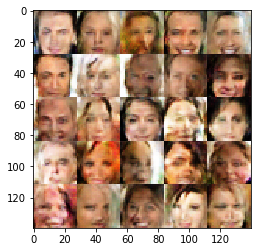

Epoch: 1/2 Discriminator Loss: 0.8489923477172852 Generator Loss: 1.897277593612671
Epoch: 1/2 Discriminator Loss: 0.762844443321228 Generator Loss: 1.5224248170852661
Epoch: 1/2 Discriminator Loss: 0.7747043967247009 Generator Loss: 3.340254783630371
Epoch: 1/2 Discriminator Loss: 0.5770031213760376 Generator Loss: 2.4287705421447754
Epoch: 1/2 Discriminator Loss: 0.8914732933044434 Generator Loss: 1.573488712310791
Epoch: 1/2 Discriminator Loss: 0.5577430725097656 Generator Loss: 2.7104744911193848
Epoch: 2/2 Discriminator Loss: 0.684814453125 Generator Loss: 3.1621217727661133
Epoch: 2/2 Discriminator Loss: 0.4671238660812378 Generator Loss: 2.630357265472412
Epoch: 2/2 Discriminator Loss: 0.7902142405509949 Generator Loss: 2.287121295928955
Epoch: 2/2 Discriminator Loss: 1.0603225231170654 Generator Loss: 0.9922748804092407


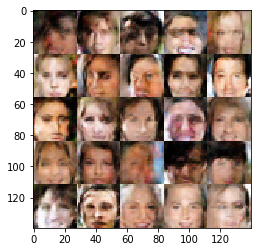

Epoch: 2/2 Discriminator Loss: 1.1301711797714233 Generator Loss: 2.284163475036621
Epoch: 2/2 Discriminator Loss: 0.8506638407707214 Generator Loss: 2.098113536834717
Epoch: 2/2 Discriminator Loss: 0.8943573236465454 Generator Loss: 2.0934157371520996
Epoch: 2/2 Discriminator Loss: 0.81297767162323 Generator Loss: 1.688875675201416
Epoch: 2/2 Discriminator Loss: 0.6513004302978516 Generator Loss: 2.23494291305542
Epoch: 2/2 Discriminator Loss: 0.9829577207565308 Generator Loss: 2.0970394611358643
Epoch: 2/2 Discriminator Loss: 0.5049715042114258 Generator Loss: 2.542088031768799
Epoch: 2/2 Discriminator Loss: 0.9170536994934082 Generator Loss: 1.2128609418869019
Epoch: 2/2 Discriminator Loss: 0.8552985787391663 Generator Loss: 1.3310682773590088
Epoch: 2/2 Discriminator Loss: 0.5944318175315857 Generator Loss: 2.760347366333008


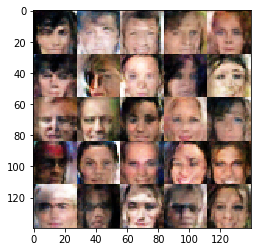

Epoch: 2/2 Discriminator Loss: 0.8990800380706787 Generator Loss: 2.6596202850341797
Epoch: 2/2 Discriminator Loss: 0.5069936513900757 Generator Loss: 1.6227046251296997
Epoch: 2/2 Discriminator Loss: 0.7595540285110474 Generator Loss: 0.9928919076919556
Epoch: 2/2 Discriminator Loss: 0.6553316116333008 Generator Loss: 3.11708927154541
Epoch: 2/2 Discriminator Loss: 0.6537947058677673 Generator Loss: 2.6416268348693848
Epoch: 2/2 Discriminator Loss: 0.7289108633995056 Generator Loss: 2.590707540512085
Epoch: 2/2 Discriminator Loss: 0.9169450998306274 Generator Loss: 1.395511507987976
Epoch: 2/2 Discriminator Loss: 0.6633009910583496 Generator Loss: 1.802547812461853
Epoch: 2/2 Discriminator Loss: 1.106801986694336 Generator Loss: 1.0607163906097412
Epoch: 2/2 Discriminator Loss: 1.2416764497756958 Generator Loss: 0.5575172901153564


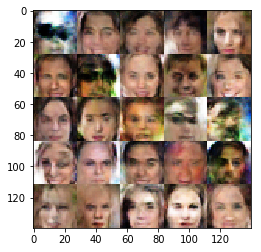

Epoch: 2/2 Discriminator Loss: 1.221545696258545 Generator Loss: 2.3007798194885254
Epoch: 2/2 Discriminator Loss: 0.5859768390655518 Generator Loss: 2.0989580154418945
Epoch: 2/2 Discriminator Loss: 0.5302544236183167 Generator Loss: 3.5482771396636963
Epoch: 2/2 Discriminator Loss: 0.593050479888916 Generator Loss: 1.9266245365142822
Epoch: 2/2 Discriminator Loss: 0.7204405665397644 Generator Loss: 3.1781017780303955
Epoch: 2/2 Discriminator Loss: 0.6054425835609436 Generator Loss: 1.6968603134155273
Epoch: 2/2 Discriminator Loss: 0.6718248128890991 Generator Loss: 3.48374605178833
Epoch: 2/2 Discriminator Loss: 1.0908987522125244 Generator Loss: 1.749824047088623
Epoch: 2/2 Discriminator Loss: 0.8843326568603516 Generator Loss: 1.0591812133789062
Epoch: 2/2 Discriminator Loss: 1.2089424133300781 Generator Loss: 1.4451446533203125


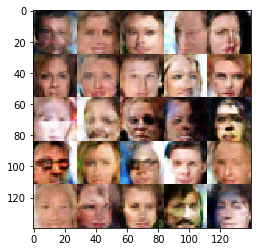

Epoch: 2/2 Discriminator Loss: 0.6941036581993103 Generator Loss: 1.360050082206726
Epoch: 2/2 Discriminator Loss: 1.0090217590332031 Generator Loss: 1.7413651943206787
Epoch: 2/2 Discriminator Loss: 0.8328831195831299 Generator Loss: 0.39994901418685913
Epoch: 2/2 Discriminator Loss: 0.8438607454299927 Generator Loss: 3.1116647720336914
Epoch: 2/2 Discriminator Loss: 0.5817674398422241 Generator Loss: 1.5200695991516113
Epoch: 2/2 Discriminator Loss: 1.2648353576660156 Generator Loss: 2.41709041595459
Epoch: 2/2 Discriminator Loss: 1.372971773147583 Generator Loss: 2.292971611022949
Epoch: 2/2 Discriminator Loss: 0.7174839377403259 Generator Loss: 1.4528847932815552
Epoch: 2/2 Discriminator Loss: 0.8609094619750977 Generator Loss: 2.3985495567321777
Epoch: 2/2 Discriminator Loss: 0.9329304099082947 Generator Loss: 1.5029542446136475


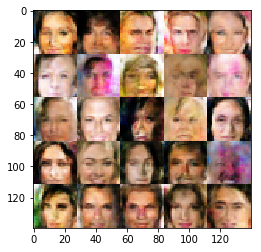

Epoch: 2/2 Discriminator Loss: 1.1182975769042969 Generator Loss: 1.2593538761138916
Epoch: 2/2 Discriminator Loss: 0.49128344655036926 Generator Loss: 2.4595260620117188
Epoch: 2/2 Discriminator Loss: 1.2074477672576904 Generator Loss: 0.9423313140869141
Epoch: 2/2 Discriminator Loss: 0.5646223425865173 Generator Loss: 3.3962159156799316
Epoch: 2/2 Discriminator Loss: 1.1437560319900513 Generator Loss: 2.24489688873291
Epoch: 2/2 Discriminator Loss: 0.9379377961158752 Generator Loss: 4.115902423858643
Epoch: 2/2 Discriminator Loss: 0.717028021812439 Generator Loss: 1.2200679779052734
Epoch: 2/2 Discriminator Loss: 0.6920058727264404 Generator Loss: 1.7164281606674194
Epoch: 2/2 Discriminator Loss: 1.083146572113037 Generator Loss: 2.524080276489258
Epoch: 2/2 Discriminator Loss: 0.6775377988815308 Generator Loss: 3.1009795665740967


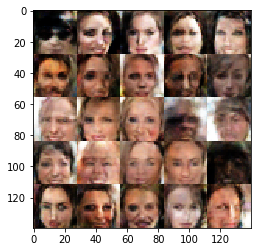

Epoch: 2/2 Discriminator Loss: 0.625377893447876 Generator Loss: 2.0099189281463623
Epoch: 2/2 Discriminator Loss: 1.1759350299835205 Generator Loss: 1.3659065961837769
Epoch: 2/2 Discriminator Loss: 1.0018372535705566 Generator Loss: 2.3029651641845703
Epoch: 2/2 Discriminator Loss: 1.0620460510253906 Generator Loss: 1.5494540929794312
Epoch: 2/2 Discriminator Loss: 0.745522141456604 Generator Loss: 2.896888017654419
Epoch: 2/2 Discriminator Loss: 0.5374504327774048 Generator Loss: 2.6070594787597656
Epoch: 2/2 Discriminator Loss: 1.041619062423706 Generator Loss: 1.3238534927368164
Epoch: 2/2 Discriminator Loss: 0.44651463627815247 Generator Loss: 2.8181824684143066
Epoch: 2/2 Discriminator Loss: 0.6226279735565186 Generator Loss: 2.7793376445770264
Epoch: 2/2 Discriminator Loss: 1.5216861963272095 Generator Loss: 4.063111782073975


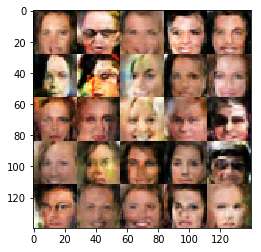

Epoch: 2/2 Discriminator Loss: 0.5958380103111267 Generator Loss: 2.20061993598938
Epoch: 2/2 Discriminator Loss: 0.5721224546432495 Generator Loss: 1.0120365619659424
Epoch: 2/2 Discriminator Loss: 0.702764630317688 Generator Loss: 3.4026949405670166
Epoch: 2/2 Discriminator Loss: 0.5600718259811401 Generator Loss: 2.294140100479126
Epoch: 2/2 Discriminator Loss: 0.5262784957885742 Generator Loss: 2.1187820434570312
Epoch: 2/2 Discriminator Loss: 0.7181116342544556 Generator Loss: 1.4888551235198975
Epoch: 2/2 Discriminator Loss: 0.6318199038505554 Generator Loss: 2.0186715126037598
Epoch: 2/2 Discriminator Loss: 1.0474321842193604 Generator Loss: 1.4919933080673218
Epoch: 2/2 Discriminator Loss: 0.5774918794631958 Generator Loss: 1.4242830276489258
Epoch: 2/2 Discriminator Loss: 1.279971718788147 Generator Loss: 1.049573302268982


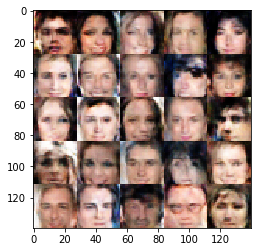

Epoch: 2/2 Discriminator Loss: 0.6931409239768982 Generator Loss: 2.054809093475342
Epoch: 2/2 Discriminator Loss: 0.8065813779830933 Generator Loss: 1.2907555103302002
Epoch: 2/2 Discriminator Loss: 1.0036989450454712 Generator Loss: 1.3519201278686523
Epoch: 2/2 Discriminator Loss: 0.5547610521316528 Generator Loss: 2.370283603668213
Epoch: 2/2 Discriminator Loss: 1.0194370746612549 Generator Loss: 1.5365805625915527
Epoch: 2/2 Discriminator Loss: 0.6121214032173157 Generator Loss: 3.203824996948242
Epoch: 2/2 Discriminator Loss: 0.8020365238189697 Generator Loss: 2.208852767944336
Epoch: 2/2 Discriminator Loss: 0.6668538451194763 Generator Loss: 3.5378127098083496
Epoch: 2/2 Discriminator Loss: 1.3045904636383057 Generator Loss: 0.38198983669281006
Epoch: 2/2 Discriminator Loss: 0.6783936619758606 Generator Loss: 1.6062676906585693


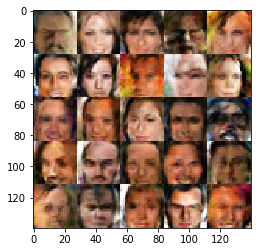

Epoch: 2/2 Discriminator Loss: 1.3229498863220215 Generator Loss: 0.7344974279403687
Epoch: 2/2 Discriminator Loss: 0.9001363515853882 Generator Loss: 3.812239170074463
Epoch: 2/2 Discriminator Loss: 0.9378198385238647 Generator Loss: 2.145056962966919
Epoch: 2/2 Discriminator Loss: 1.0833466053009033 Generator Loss: 1.2250629663467407
Epoch: 2/2 Discriminator Loss: 0.6303004622459412 Generator Loss: 2.2587122917175293
Epoch: 2/2 Discriminator Loss: 0.9920368790626526 Generator Loss: 2.639939308166504
Epoch: 2/2 Discriminator Loss: 1.5816543102264404 Generator Loss: 1.4946209192276
Epoch: 2/2 Discriminator Loss: 0.7528258562088013 Generator Loss: 1.4882841110229492
Epoch: 2/2 Discriminator Loss: 0.9557309150695801 Generator Loss: 2.0352420806884766
Epoch: 2/2 Discriminator Loss: 0.5749981999397278 Generator Loss: 2.070695400238037


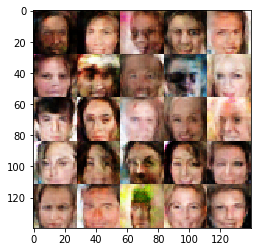

Epoch: 2/2 Discriminator Loss: 0.6016483306884766 Generator Loss: 2.183925151824951
Epoch: 2/2 Discriminator Loss: 0.7028197050094604 Generator Loss: 2.188469409942627
Epoch: 2/2 Discriminator Loss: 1.5485254526138306 Generator Loss: 1.400925636291504
Epoch: 2/2 Discriminator Loss: 0.5842922329902649 Generator Loss: 1.4482101202011108
Epoch: 2/2 Discriminator Loss: 0.7465303540229797 Generator Loss: 1.0377061367034912
Epoch: 2/2 Discriminator Loss: 0.7582472562789917 Generator Loss: 1.443274736404419
Epoch: 2/2 Discriminator Loss: 0.6213521361351013 Generator Loss: 3.6675424575805664
Epoch: 2/2 Discriminator Loss: 0.705096960067749 Generator Loss: 2.0826480388641357
Epoch: 2/2 Discriminator Loss: 0.6054083108901978 Generator Loss: 2.4551925659179688
Epoch: 2/2 Discriminator Loss: 0.7394895553588867 Generator Loss: 1.8946037292480469


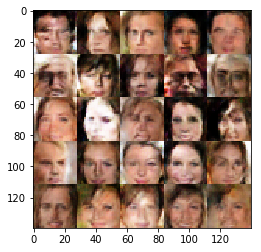

Epoch: 2/2 Discriminator Loss: 0.5833789110183716 Generator Loss: 2.6151485443115234
Epoch: 2/2 Discriminator Loss: 0.590032696723938 Generator Loss: 1.5520098209381104
Epoch: 2/2 Discriminator Loss: 0.697819709777832 Generator Loss: 2.7134041786193848
Epoch: 2/2 Discriminator Loss: 0.6432684659957886 Generator Loss: 2.100374698638916
Epoch: 2/2 Discriminator Loss: 0.78679358959198 Generator Loss: 2.9478888511657715
Epoch: 2/2 Discriminator Loss: 1.7652703523635864 Generator Loss: 1.3807026147842407
Epoch: 2/2 Discriminator Loss: 1.3174992799758911 Generator Loss: 0.9323013424873352
Epoch: 2/2 Discriminator Loss: 0.7235914468765259 Generator Loss: 2.3939530849456787
Epoch: 2/2 Discriminator Loss: 1.084963321685791 Generator Loss: 1.9739989042282104
Epoch: 2/2 Discriminator Loss: 0.8928050994873047 Generator Loss: 1.9758635759353638


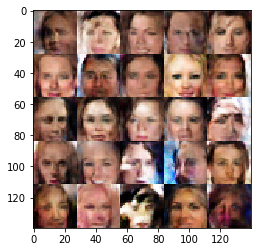

Epoch: 2/2 Discriminator Loss: 0.5628799200057983 Generator Loss: 2.4105923175811768
Epoch: 2/2 Discriminator Loss: 0.6566046476364136 Generator Loss: 1.662481427192688
Epoch: 2/2 Discriminator Loss: 0.5628194212913513 Generator Loss: 1.8078213930130005
Epoch: 2/2 Discriminator Loss: 0.9016502499580383 Generator Loss: 3.5547196865081787
Epoch: 2/2 Discriminator Loss: 0.8519980907440186 Generator Loss: 1.98152494430542
Epoch: 2/2 Discriminator Loss: 1.4329205751419067 Generator Loss: 0.8569880723953247
Epoch: 2/2 Discriminator Loss: 0.8211241960525513 Generator Loss: 2.292234420776367
Epoch: 2/2 Discriminator Loss: 0.578734815120697 Generator Loss: 2.7691969871520996
Epoch: 2/2 Discriminator Loss: 0.6836364269256592 Generator Loss: 1.7330126762390137
Epoch: 2/2 Discriminator Loss: 0.7803560495376587 Generator Loss: 1.776112675666809


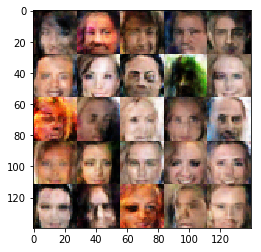

Epoch: 2/2 Discriminator Loss: 0.7879748344421387 Generator Loss: 1.2110010385513306
Epoch: 2/2 Discriminator Loss: 1.4373798370361328 Generator Loss: 2.229179859161377
Epoch: 2/2 Discriminator Loss: 0.5879522562026978 Generator Loss: 1.7423744201660156
Epoch: 2/2 Discriminator Loss: 0.4698784351348877 Generator Loss: 3.4819843769073486
Epoch: 2/2 Discriminator Loss: 0.6255514621734619 Generator Loss: 2.24898624420166
Epoch: 2/2 Discriminator Loss: 0.6448267698287964 Generator Loss: 1.19093656539917
Epoch: 2/2 Discriminator Loss: 0.6180760860443115 Generator Loss: 2.8989179134368896
Epoch: 2/2 Discriminator Loss: 1.0865265130996704 Generator Loss: 3.762155771255493
Epoch: 2/2 Discriminator Loss: 1.7399204969406128 Generator Loss: 2.0318667888641357
Epoch: 2/2 Discriminator Loss: 0.7173709273338318 Generator Loss: 1.4152547121047974


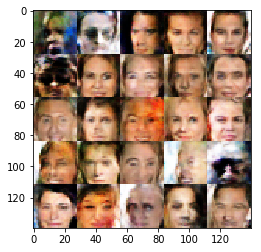

Epoch: 2/2 Discriminator Loss: 0.6216832399368286 Generator Loss: 3.1569130420684814
Epoch: 2/2 Discriminator Loss: 0.5604283213615417 Generator Loss: 2.4284486770629883
Epoch: 2/2 Discriminator Loss: 0.5884298086166382 Generator Loss: 1.2329936027526855
Epoch: 2/2 Discriminator Loss: 0.9094085693359375 Generator Loss: 2.358612060546875
Epoch: 2/2 Discriminator Loss: 0.4083620607852936 Generator Loss: 2.4546051025390625
Epoch: 2/2 Discriminator Loss: 0.6817929744720459 Generator Loss: 1.4892356395721436
Epoch: 2/2 Discriminator Loss: 1.036521315574646 Generator Loss: 1.51786208152771
Epoch: 2/2 Discriminator Loss: 0.8863884210586548 Generator Loss: 1.9833569526672363
Epoch: 2/2 Discriminator Loss: 0.6640671491622925 Generator Loss: 1.5258119106292725
Epoch: 2/2 Discriminator Loss: 0.7540062069892883 Generator Loss: 1.5581048727035522


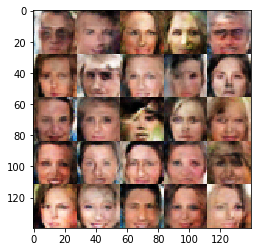

Epoch: 2/2 Discriminator Loss: 1.1075570583343506 Generator Loss: 2.20194411277771
Epoch: 2/2 Discriminator Loss: 0.6274439692497253 Generator Loss: 2.344578266143799
Epoch: 2/2 Discriminator Loss: 0.6835833787918091 Generator Loss: 1.7871663570404053
Epoch: 2/2 Discriminator Loss: 1.0302159786224365 Generator Loss: 1.3425192832946777
Epoch: 2/2 Discriminator Loss: 0.653876543045044 Generator Loss: 2.971759796142578
Epoch: 2/2 Discriminator Loss: 0.8611799478530884 Generator Loss: 0.774883508682251
Epoch: 2/2 Discriminator Loss: 0.5856111645698547 Generator Loss: 3.08064603805542
Epoch: 2/2 Discriminator Loss: 1.0964925289154053 Generator Loss: 0.9521656036376953
Epoch: 2/2 Discriminator Loss: 0.7505685687065125 Generator Loss: 3.395580768585205
Epoch: 2/2 Discriminator Loss: 0.5886422991752625 Generator Loss: 2.930443286895752


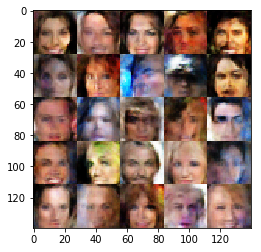

Epoch: 2/2 Discriminator Loss: 0.660749077796936 Generator Loss: 1.658803939819336
Epoch: 2/2 Discriminator Loss: 0.6586747169494629 Generator Loss: 2.1168739795684814
Epoch: 2/2 Discriminator Loss: 0.5785262584686279 Generator Loss: 1.7690273523330688
Epoch: 2/2 Discriminator Loss: 0.5838729739189148 Generator Loss: 3.2000577449798584
Epoch: 2/2 Discriminator Loss: 0.744518518447876 Generator Loss: 2.9871344566345215
Epoch: 2/2 Discriminator Loss: 0.6068962812423706 Generator Loss: 1.868685007095337
Epoch: 2/2 Discriminator Loss: 0.6747472286224365 Generator Loss: 3.4377644062042236
Epoch: 2/2 Discriminator Loss: 0.7910374999046326 Generator Loss: 1.5398377180099487
Epoch: 2/2 Discriminator Loss: 0.5776670575141907 Generator Loss: 1.524242639541626
Epoch: 2/2 Discriminator Loss: 0.6934230327606201 Generator Loss: 2.1085636615753174


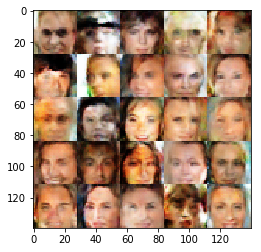

Epoch: 2/2 Discriminator Loss: 0.634319543838501 Generator Loss: 2.838305711746216
Epoch: 2/2 Discriminator Loss: 0.5614510774612427 Generator Loss: 1.0043110847473145
Epoch: 2/2 Discriminator Loss: 0.8318036794662476 Generator Loss: 2.593085289001465
Epoch: 2/2 Discriminator Loss: 0.8965717554092407 Generator Loss: 1.135629653930664
Epoch: 2/2 Discriminator Loss: 0.6176111698150635 Generator Loss: 1.9631272554397583
Epoch: 2/2 Discriminator Loss: 0.8562631607055664 Generator Loss: 1.8612821102142334
Epoch: 2/2 Discriminator Loss: 0.7589920163154602 Generator Loss: 2.8835363388061523
Epoch: 2/2 Discriminator Loss: 1.0729951858520508 Generator Loss: 3.1637444496154785
Epoch: 2/2 Discriminator Loss: 0.9725400805473328 Generator Loss: 1.7701549530029297
Epoch: 2/2 Discriminator Loss: 0.9458923935890198 Generator Loss: 1.1381235122680664


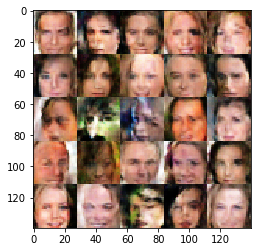

Epoch: 2/2 Discriminator Loss: 0.7168657779693604 Generator Loss: 2.106921672821045
Epoch: 2/2 Discriminator Loss: 0.7264673709869385 Generator Loss: 3.775082588195801
Epoch: 2/2 Discriminator Loss: 0.6633700132369995 Generator Loss: 1.7898130416870117
Epoch: 2/2 Discriminator Loss: 0.7778623700141907 Generator Loss: 1.4916486740112305
Epoch: 2/2 Discriminator Loss: 0.6329676508903503 Generator Loss: 0.8879277110099792
Epoch: 2/2 Discriminator Loss: 0.5519486665725708 Generator Loss: 3.2845356464385986
Epoch: 2/2 Discriminator Loss: 0.5307883620262146 Generator Loss: 2.3117423057556152
Epoch: 2/2 Discriminator Loss: 0.614408016204834 Generator Loss: 2.108750820159912
Epoch: 2/2 Discriminator Loss: 0.88387531042099 Generator Loss: 0.8875170946121216
Epoch: 2/2 Discriminator Loss: 0.6211197376251221 Generator Loss: 1.6144440174102783


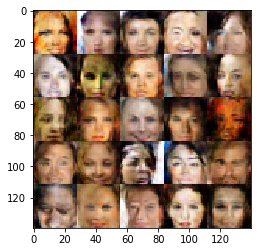

Epoch: 2/2 Discriminator Loss: 0.880721926689148 Generator Loss: 1.2087239027023315
Epoch: 2/2 Discriminator Loss: 0.8590071201324463 Generator Loss: 1.5691357851028442
Epoch: 2/2 Discriminator Loss: 0.7196263670921326 Generator Loss: 1.2591984272003174
Epoch: 2/2 Discriminator Loss: 0.7684800624847412 Generator Loss: 2.2295427322387695
Epoch: 2/2 Discriminator Loss: 0.6679639220237732 Generator Loss: 2.722923755645752
Epoch: 2/2 Discriminator Loss: 0.8932009935379028 Generator Loss: 3.3217387199401855
Epoch: 2/2 Discriminator Loss: 0.803971529006958 Generator Loss: 1.9800792932510376
Epoch: 2/2 Discriminator Loss: 0.7740226984024048 Generator Loss: 2.384321689605713
Epoch: 2/2 Discriminator Loss: 0.915299654006958 Generator Loss: 1.5262441635131836
Epoch: 2/2 Discriminator Loss: 0.5979419946670532 Generator Loss: 1.520026683807373


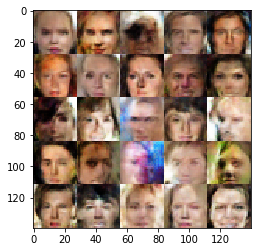

Epoch: 2/2 Discriminator Loss: 0.5780023336410522 Generator Loss: 2.404003620147705
Epoch: 2/2 Discriminator Loss: 0.9109379649162292 Generator Loss: 2.110016107559204
Epoch: 2/2 Discriminator Loss: 0.4716230630874634 Generator Loss: 2.2774276733398438
Epoch: 2/2 Discriminator Loss: 0.8375273942947388 Generator Loss: 2.5761327743530273
Epoch: 2/2 Discriminator Loss: 0.872018575668335 Generator Loss: 2.690518379211426
Epoch: 2/2 Discriminator Loss: 0.7051153182983398 Generator Loss: 2.5101165771484375
Epoch: 2/2 Discriminator Loss: 1.1643801927566528 Generator Loss: 2.272515296936035
Epoch: 2/2 Discriminator Loss: 0.6660276651382446 Generator Loss: 3.334089756011963
Epoch: 2/2 Discriminator Loss: 0.6099313497543335 Generator Loss: 0.5475460290908813
Epoch: 2/2 Discriminator Loss: 1.226621389389038 Generator Loss: 1.5358622074127197


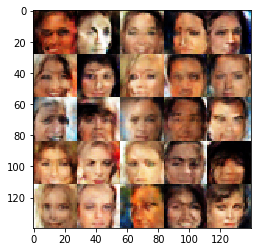

Epoch: 2/2 Discriminator Loss: 1.1418845653533936 Generator Loss: 1.1900103092193604
Epoch: 2/2 Discriminator Loss: 1.0468729734420776 Generator Loss: 2.095177412033081
Epoch: 2/2 Discriminator Loss: 1.0642036199569702 Generator Loss: 1.8626198768615723
Epoch: 2/2 Discriminator Loss: 0.8199887275695801 Generator Loss: 2.438302993774414
Epoch: 2/2 Discriminator Loss: 1.4113051891326904 Generator Loss: 2.0354411602020264
Epoch: 2/2 Discriminator Loss: 1.1396772861480713 Generator Loss: 0.9461512565612793
Epoch: 2/2 Discriminator Loss: 0.7680159211158752 Generator Loss: 2.7488582134246826
Epoch: 2/2 Discriminator Loss: 0.7686456441879272 Generator Loss: 0.7874517440795898
Epoch: 2/2 Discriminator Loss: 0.7106554508209229 Generator Loss: 1.8609089851379395
Epoch: 2/2 Discriminator Loss: 0.5094919204711914 Generator Loss: 3.884368419647217


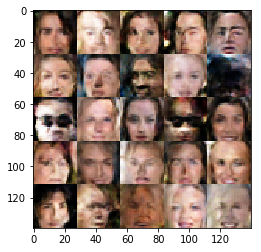

Epoch: 2/2 Discriminator Loss: 0.4068368673324585 Generator Loss: 2.0205209255218506
Epoch: 2/2 Discriminator Loss: 1.0895047187805176 Generator Loss: 2.212367534637451
Epoch: 2/2 Discriminator Loss: 0.6351256370544434 Generator Loss: 2.5180537700653076
Epoch: 2/2 Discriminator Loss: 1.4617265462875366 Generator Loss: 2.971487045288086
Epoch: 2/2 Discriminator Loss: 0.5273324251174927 Generator Loss: 2.591904640197754
Epoch: 2/2 Discriminator Loss: 0.7187017798423767 Generator Loss: 2.100797414779663
Epoch: 2/2 Discriminator Loss: 0.5867060422897339 Generator Loss: 2.6103692054748535
Epoch: 2/2 Discriminator Loss: 1.3892920017242432 Generator Loss: 2.0590357780456543
Epoch: 2/2 Discriminator Loss: 0.6665902137756348 Generator Loss: 1.3789559602737427
Epoch: 2/2 Discriminator Loss: 0.6934128999710083 Generator Loss: 2.0734214782714844


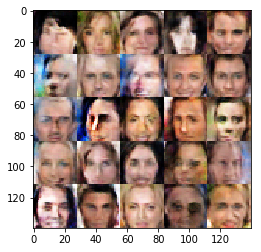

Epoch: 2/2 Discriminator Loss: 1.2730560302734375 Generator Loss: 1.962512493133545
Epoch: 2/2 Discriminator Loss: 1.028724193572998 Generator Loss: 3.5184638500213623
Epoch: 2/2 Discriminator Loss: 0.6023322939872742 Generator Loss: 2.350099563598633
Epoch: 2/2 Discriminator Loss: 0.6053197383880615 Generator Loss: 3.211012125015259
Epoch: 2/2 Discriminator Loss: 0.8622329235076904 Generator Loss: 2.851145029067993
Epoch: 2/2 Discriminator Loss: 0.8165645599365234 Generator Loss: 2.1529808044433594
Epoch: 2/2 Discriminator Loss: 1.2032649517059326 Generator Loss: 1.5021425485610962
Epoch: 2/2 Discriminator Loss: 0.5683708190917969 Generator Loss: 1.6738154888153076
Epoch: 2/2 Discriminator Loss: 0.6499217748641968 Generator Loss: 1.8608862161636353
Epoch: 2/2 Discriminator Loss: 0.6092361211776733 Generator Loss: 3.045457601547241


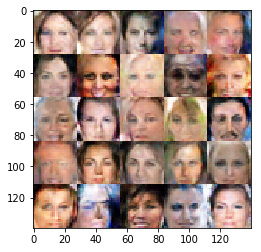

Epoch: 2/2 Discriminator Loss: 0.5749730467796326 Generator Loss: 1.8725965023040771
Epoch: 2/2 Discriminator Loss: 0.5530207753181458 Generator Loss: 2.2263145446777344
Epoch: 2/2 Discriminator Loss: 0.8061899542808533 Generator Loss: 0.8603914380073547
Epoch: 2/2 Discriminator Loss: 0.8618385791778564 Generator Loss: 2.5891947746276855
Epoch: 2/2 Discriminator Loss: 0.5931956768035889 Generator Loss: 2.685037612915039
Epoch: 2/2 Discriminator Loss: 0.5043003559112549 Generator Loss: 1.3156602382659912
Epoch: 2/2 Discriminator Loss: 0.9070718884468079 Generator Loss: 1.8490941524505615
Epoch: 2/2 Discriminator Loss: 0.8112602233886719 Generator Loss: 0.7507409453392029
Epoch: 2/2 Discriminator Loss: 1.4528050422668457 Generator Loss: 0.9281848669052124
Epoch: 2/2 Discriminator Loss: 0.8703316450119019 Generator Loss: 2.0293402671813965


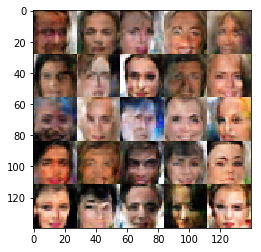

Epoch: 2/2 Discriminator Loss: 0.5996426939964294 Generator Loss: 1.9933878183364868
Epoch: 2/2 Discriminator Loss: 0.5963361263275146 Generator Loss: 2.8647680282592773
Epoch: 2/2 Discriminator Loss: 0.9027955532073975 Generator Loss: 2.2908504009246826
Epoch: 2/2 Discriminator Loss: 0.7750453948974609 Generator Loss: 1.1630346775054932
Epoch: 2/2 Discriminator Loss: 0.8865911960601807 Generator Loss: 3.603213310241699
Epoch: 2/2 Discriminator Loss: 0.9077122211456299 Generator Loss: 2.012897253036499
Epoch: 2/2 Discriminator Loss: 0.7072343826293945 Generator Loss: 2.259629011154175
Epoch: 2/2 Discriminator Loss: 0.7204225063323975 Generator Loss: 1.9347128868103027
Epoch: 2/2 Discriminator Loss: 0.738439679145813 Generator Loss: 0.8426134586334229
Epoch: 2/2 Discriminator Loss: 1.0553302764892578 Generator Loss: 1.685388207435608


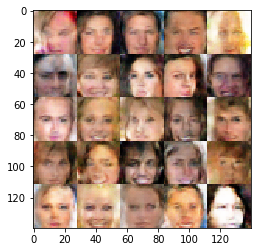

Epoch: 2/2 Discriminator Loss: 0.5867135524749756 Generator Loss: 2.236751079559326
Epoch: 2/2 Discriminator Loss: 1.3217487335205078 Generator Loss: 2.200489044189453
Epoch: 2/2 Discriminator Loss: 0.5975823402404785 Generator Loss: 2.139883279800415
Epoch: 2/2 Discriminator Loss: 0.7179286479949951 Generator Loss: 2.9010632038116455
Epoch: 2/2 Discriminator Loss: 0.8008605241775513 Generator Loss: 2.141084671020508
Epoch: 2/2 Discriminator Loss: 0.7583220601081848 Generator Loss: 1.815861463546753
Epoch: 2/2 Discriminator Loss: 0.7452738285064697 Generator Loss: 3.36165714263916
Epoch: 2/2 Discriminator Loss: 0.7204641103744507 Generator Loss: 1.6482949256896973
Epoch: 2/2 Discriminator Loss: 0.9104716181755066 Generator Loss: 1.6891779899597168
Epoch: 2/2 Discriminator Loss: 0.7021580934524536 Generator Loss: 3.1200265884399414


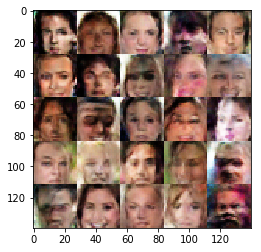

Epoch: 2/2 Discriminator Loss: 0.9141236543655396 Generator Loss: 1.3536204099655151
Epoch: 2/2 Discriminator Loss: 0.5288628339767456 Generator Loss: 3.2164196968078613
Epoch: 2/2 Discriminator Loss: 0.7460922002792358 Generator Loss: 3.1843509674072266
Epoch: 2/2 Discriminator Loss: 0.857391357421875 Generator Loss: 2.6859254837036133
Epoch: 2/2 Discriminator Loss: 0.4559510350227356 Generator Loss: 3.102017879486084
Epoch: 2/2 Discriminator Loss: 0.6429873704910278 Generator Loss: 2.8050990104675293
Epoch: 2/2 Discriminator Loss: 0.7610892057418823 Generator Loss: 3.411024570465088
Epoch: 2/2 Discriminator Loss: 0.9377108812332153 Generator Loss: 0.8502776026725769
Epoch: 2/2 Discriminator Loss: 1.1190738677978516 Generator Loss: 2.395109176635742
Epoch: 2/2 Discriminator Loss: 0.4961532652378082 Generator Loss: 3.5008578300476074


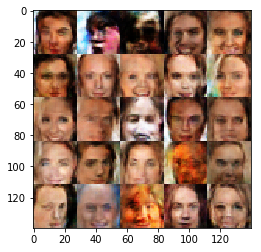

Epoch: 2/2 Discriminator Loss: 0.7462406158447266 Generator Loss: 2.3758130073547363
Epoch: 2/2 Discriminator Loss: 0.727837860584259 Generator Loss: 2.818260908126831
Epoch: 2/2 Discriminator Loss: 0.6487120389938354 Generator Loss: 1.1799429655075073
Epoch: 2/2 Discriminator Loss: 0.5447072386741638 Generator Loss: 3.3272409439086914
Epoch: 2/2 Discriminator Loss: 0.6003909111022949 Generator Loss: 3.5936074256896973
Epoch: 2/2 Discriminator Loss: 0.5490173697471619 Generator Loss: 1.1537683010101318
Epoch: 2/2 Discriminator Loss: 0.7116125822067261 Generator Loss: 2.0114059448242188
Epoch: 2/2 Discriminator Loss: 0.6483242511749268 Generator Loss: 1.9039027690887451
Epoch: 2/2 Discriminator Loss: 0.9934098720550537 Generator Loss: 1.221921682357788
Epoch: 2/2 Discriminator Loss: 0.6599353551864624 Generator Loss: 2.684654712677002


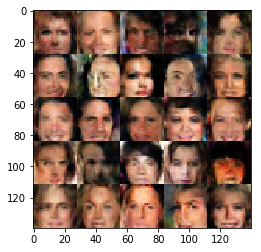

Epoch: 2/2 Discriminator Loss: 0.7837653756141663 Generator Loss: 1.206942081451416
Epoch: 2/2 Discriminator Loss: 0.6277340650558472 Generator Loss: 2.0097241401672363
Epoch: 2/2 Discriminator Loss: 0.678503155708313 Generator Loss: 2.3274617195129395
Epoch: 2/2 Discriminator Loss: 0.6005733013153076 Generator Loss: 2.3419718742370605
Epoch: 2/2 Discriminator Loss: 1.177772045135498 Generator Loss: 1.2477083206176758
Epoch: 2/2 Discriminator Loss: 0.9506123065948486 Generator Loss: 2.8252146244049072
Epoch: 2/2 Discriminator Loss: 0.6744606494903564 Generator Loss: 1.882603406906128
Epoch: 2/2 Discriminator Loss: 0.5986616611480713 Generator Loss: 1.942598819732666
Epoch: 2/2 Discriminator Loss: 0.9797093868255615 Generator Loss: 1.5626261234283447
Epoch: 2/2 Discriminator Loss: 0.5397405028343201 Generator Loss: 3.7223734855651855


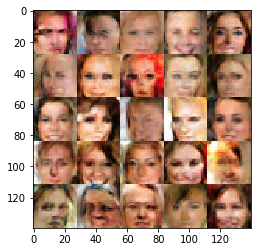

Epoch: 2/2 Discriminator Loss: 0.6489872932434082 Generator Loss: 1.6898070573806763
Epoch: 2/2 Discriminator Loss: 0.528338611125946 Generator Loss: 1.1064704656600952
Epoch: 2/2 Discriminator Loss: 0.6553138494491577 Generator Loss: 1.7084968090057373
Epoch: 2/2 Discriminator Loss: 0.6388912796974182 Generator Loss: 2.537266731262207
Epoch: 2/2 Discriminator Loss: 0.6833544969558716 Generator Loss: 2.4704530239105225
Epoch: 2/2 Discriminator Loss: 0.8931339979171753 Generator Loss: 0.7674461603164673
Epoch: 2/2 Discriminator Loss: 0.937043309211731 Generator Loss: 3.06691312789917
Epoch: 2/2 Discriminator Loss: 0.6345115900039673 Generator Loss: 2.765707015991211
Epoch: 2/2 Discriminator Loss: 1.300506591796875 Generator Loss: 1.280564308166504
Epoch: 2/2 Discriminator Loss: 0.59654700756073 Generator Loss: 2.2118396759033203


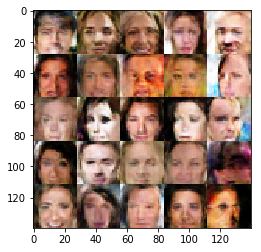

Epoch: 2/2 Discriminator Loss: 0.5138003826141357 Generator Loss: 1.2410465478897095
Epoch: 2/2 Discriminator Loss: 1.157046914100647 Generator Loss: 1.802455186843872
Epoch: 2/2 Discriminator Loss: 1.7503962516784668 Generator Loss: 0.22782041132450104
Epoch: 2/2 Discriminator Loss: 0.9467202425003052 Generator Loss: 2.8142688274383545
Epoch: 2/2 Discriminator Loss: 1.193351149559021 Generator Loss: 2.434044599533081
Epoch: 2/2 Discriminator Loss: 0.4515224099159241 Generator Loss: 3.5728201866149902
Epoch: 2/2 Discriminator Loss: 1.039954423904419 Generator Loss: 2.428649425506592
Epoch: 2/2 Discriminator Loss: 0.8981404304504395 Generator Loss: 1.7590124607086182
Epoch: 2/2 Discriminator Loss: 0.7520893812179565 Generator Loss: 1.4661445617675781
Epoch: 2/2 Discriminator Loss: 0.8542947173118591 Generator Loss: 1.850401759147644


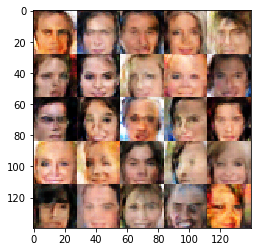

Epoch: 2/2 Discriminator Loss: 0.5575135946273804 Generator Loss: 2.5196378231048584
Epoch: 2/2 Discriminator Loss: 0.6741316914558411 Generator Loss: 4.014357089996338
Epoch: 2/2 Discriminator Loss: 1.0180774927139282 Generator Loss: 3.3535542488098145
Epoch: 2/2 Discriminator Loss: 0.5141581296920776 Generator Loss: 2.2732462882995605
Epoch: 2/2 Discriminator Loss: 0.5493218302726746 Generator Loss: 2.0900259017944336
Epoch: 2/2 Discriminator Loss: 0.6295552849769592 Generator Loss: 2.3507373332977295
Epoch: 2/2 Discriminator Loss: 1.2148845195770264 Generator Loss: 2.866926670074463
Epoch: 2/2 Discriminator Loss: 0.7073082327842712 Generator Loss: 2.670698642730713
Epoch: 2/2 Discriminator Loss: 0.4610884487628937 Generator Loss: 3.3119897842407227
Epoch: 2/2 Discriminator Loss: 0.5487726926803589 Generator Loss: 1.9008333683013916


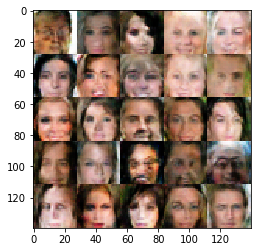

Epoch: 2/2 Discriminator Loss: 0.5368983149528503 Generator Loss: 2.567976951599121
Epoch: 2/2 Discriminator Loss: 0.7054013013839722 Generator Loss: 1.577042818069458
Epoch: 2/2 Discriminator Loss: 0.6565386056900024 Generator Loss: 2.0042452812194824
Epoch: 2/2 Discriminator Loss: 0.9928415417671204 Generator Loss: 3.4213614463806152
Epoch: 2/2 Discriminator Loss: 2.002244472503662 Generator Loss: 0.939634382724762
Epoch: 2/2 Discriminator Loss: 0.6113960146903992 Generator Loss: 1.114348292350769
Epoch: 2/2 Discriminator Loss: 0.6779316663742065 Generator Loss: 0.6861010789871216
Epoch: 2/2 Discriminator Loss: 0.6166126132011414 Generator Loss: 1.63456392288208
Epoch: 2/2 Discriminator Loss: 0.5403541922569275 Generator Loss: 3.086153984069824
Epoch: 2/2 Discriminator Loss: 1.5817173719406128 Generator Loss: 1.0247743129730225


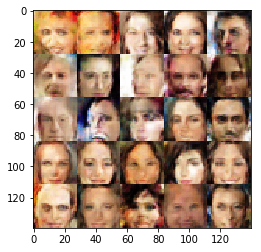

Epoch: 2/2 Discriminator Loss: 0.875754177570343 Generator Loss: 2.2983694076538086
Epoch: 2/2 Discriminator Loss: 0.49190041422843933 Generator Loss: 2.7216742038726807
Epoch: 2/2 Discriminator Loss: 0.7384733557701111 Generator Loss: 2.333637237548828
Epoch: 2/2 Discriminator Loss: 0.5688159465789795 Generator Loss: 2.5641918182373047
Epoch: 2/2 Discriminator Loss: 0.5705842971801758 Generator Loss: 2.034785270690918
Epoch: 2/2 Discriminator Loss: 0.6056346893310547 Generator Loss: 2.3988986015319824
Epoch: 2/2 Discriminator Loss: 0.4296071231365204 Generator Loss: 2.2135424613952637
Epoch: 2/2 Discriminator Loss: 1.0650198459625244 Generator Loss: 0.5985998511314392
Epoch: 2/2 Discriminator Loss: 0.7753839492797852 Generator Loss: 2.127980947494507
Epoch: 2/2 Discriminator Loss: 0.5085444450378418 Generator Loss: 1.864644169807434


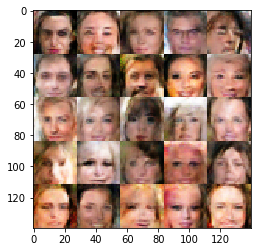

Epoch: 2/2 Discriminator Loss: 0.7108145952224731 Generator Loss: 1.6941547393798828
Epoch: 2/2 Discriminator Loss: 0.9538956880569458 Generator Loss: 2.7245497703552246
Epoch: 2/2 Discriminator Loss: 0.5081554055213928 Generator Loss: 2.0282530784606934
Epoch: 2/2 Discriminator Loss: 0.6284825801849365 Generator Loss: 2.48862886428833
Epoch: 2/2 Discriminator Loss: 0.5021523237228394 Generator Loss: 3.912546157836914
Epoch: 2/2 Discriminator Loss: 1.127275824546814 Generator Loss: 2.128220319747925
Epoch: 2/2 Discriminator Loss: 0.5307629108428955 Generator Loss: 3.4164416790008545
Epoch: 2/2 Discriminator Loss: 1.2619961500167847 Generator Loss: 2.137510061264038
Epoch: 2/2 Discriminator Loss: 0.9182990789413452 Generator Loss: 1.3133056163787842
Epoch: 2/2 Discriminator Loss: 0.5659216642379761 Generator Loss: 1.7189183235168457


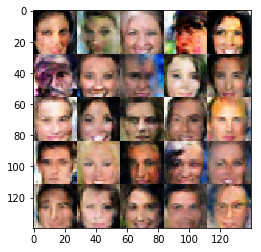

Epoch: 2/2 Discriminator Loss: 0.5011767148971558 Generator Loss: 2.729790449142456
Epoch: 2/2 Discriminator Loss: 0.9597510695457458 Generator Loss: 1.1308786869049072
Epoch: 2/2 Discriminator Loss: 1.0593433380126953 Generator Loss: 1.3792349100112915
Epoch: 2/2 Discriminator Loss: 1.0734431743621826 Generator Loss: 1.2524945735931396
Epoch: 2/2 Discriminator Loss: 0.526150107383728 Generator Loss: 2.6805033683776855
Epoch: 2/2 Discriminator Loss: 0.813762903213501 Generator Loss: 1.4646135568618774
Epoch: 2/2 Discriminator Loss: 0.4697917103767395 Generator Loss: 2.0343494415283203
Epoch: 2/2 Discriminator Loss: 0.5722991228103638 Generator Loss: 3.2755112648010254
Epoch: 2/2 Discriminator Loss: 0.4453890323638916 Generator Loss: 1.9283554553985596
Epoch: 2/2 Discriminator Loss: 0.7237709760665894 Generator Loss: 2.0329787731170654


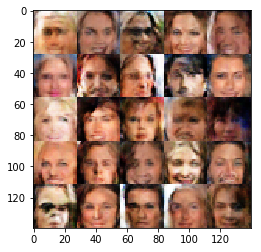

Epoch: 2/2 Discriminator Loss: 0.6307398080825806 Generator Loss: 0.9108608961105347
Epoch: 2/2 Discriminator Loss: 0.9153768420219421 Generator Loss: 2.2294559478759766
Epoch: 2/2 Discriminator Loss: 0.5589292049407959 Generator Loss: 2.090657949447632
Epoch: 2/2 Discriminator Loss: 1.6358616352081299 Generator Loss: 0.4993894696235657
Epoch: 2/2 Discriminator Loss: 1.178910493850708 Generator Loss: 1.6311782598495483
Epoch: 2/2 Discriminator Loss: 0.6334689855575562 Generator Loss: 2.834463596343994
Epoch: 2/2 Discriminator Loss: 0.6520715355873108 Generator Loss: 2.4393458366394043
Epoch: 2/2 Discriminator Loss: 0.7852580547332764 Generator Loss: 2.5009894371032715
Epoch: 2/2 Discriminator Loss: 0.5566276907920837 Generator Loss: 2.8839502334594727
Epoch: 2/2 Discriminator Loss: 0.4872762858867645 Generator Loss: 2.9063339233398438


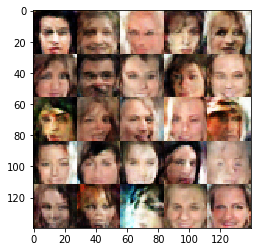

Epoch: 2/2 Discriminator Loss: 0.7123880386352539 Generator Loss: 2.049895763397217
Epoch: 2/2 Discriminator Loss: 0.8139120936393738 Generator Loss: 1.387265682220459
Epoch: 2/2 Discriminator Loss: 0.8434489369392395 Generator Loss: 2.3921613693237305
Epoch: 2/2 Discriminator Loss: 0.8999001979827881 Generator Loss: 1.432398796081543
Epoch: 2/2 Discriminator Loss: 0.92503821849823 Generator Loss: 1.6227611303329468
Epoch: 2/2 Discriminator Loss: 0.4478558301925659 Generator Loss: 3.561494827270508
Epoch: 2/2 Discriminator Loss: 0.5741099715232849 Generator Loss: 3.0205295085906982
Epoch: 2/2 Discriminator Loss: 0.628312349319458 Generator Loss: 2.23252010345459
Epoch: 2/2 Discriminator Loss: 0.7399569153785706 Generator Loss: 3.465676784515381
Epoch: 2/2 Discriminator Loss: 0.8528493046760559 Generator Loss: 2.2497811317443848


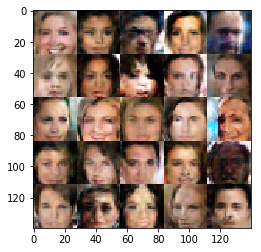

Epoch: 2/2 Discriminator Loss: 0.5465778708457947 Generator Loss: 3.2754526138305664
Epoch: 2/2 Discriminator Loss: 0.5951825380325317 Generator Loss: 2.9730329513549805
Epoch: 2/2 Discriminator Loss: 1.1874277591705322 Generator Loss: 1.0093119144439697
Epoch: 2/2 Discriminator Loss: 0.8664547204971313 Generator Loss: 1.4015247821807861
Epoch: 2/2 Discriminator Loss: 0.9337319135665894 Generator Loss: 2.911682605743408
Epoch: 2/2 Discriminator Loss: 0.519261360168457 Generator Loss: 3.729841709136963
Epoch: 2/2 Discriminator Loss: 0.8562895059585571 Generator Loss: 2.4222002029418945
Epoch: 2/2 Discriminator Loss: 0.9920635223388672 Generator Loss: 1.6837949752807617
Epoch: 2/2 Discriminator Loss: 0.8773699998855591 Generator Loss: 2.3968827724456787
Epoch: 2/2 Discriminator Loss: 0.812690019607544 Generator Loss: 1.0906925201416016


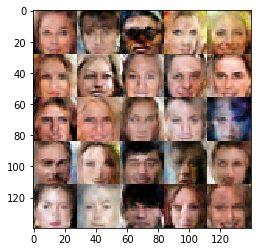

Epoch: 2/2 Discriminator Loss: 0.9080541729927063 Generator Loss: 3.4958224296569824
Epoch: 2/2 Discriminator Loss: 0.6966762542724609 Generator Loss: 2.3628146648406982
Epoch: 2/2 Discriminator Loss: 0.7747143507003784 Generator Loss: 2.4864840507507324
Epoch: 2/2 Discriminator Loss: 0.9040884971618652 Generator Loss: 0.9124062657356262
Epoch: 2/2 Discriminator Loss: 0.4258285462856293 Generator Loss: 2.3874611854553223
Epoch: 2/2 Discriminator Loss: 0.6489877700805664 Generator Loss: 1.8313559293746948
Epoch: 2/2 Discriminator Loss: 0.6095563173294067 Generator Loss: 1.3991978168487549
Epoch: 2/2 Discriminator Loss: 0.6772347688674927 Generator Loss: 1.0481693744659424
Epoch: 2/2 Discriminator Loss: 0.5138837099075317 Generator Loss: 2.2818045616149902
Epoch: 2/2 Discriminator Loss: 0.8470311164855957 Generator Loss: 1.1535005569458008


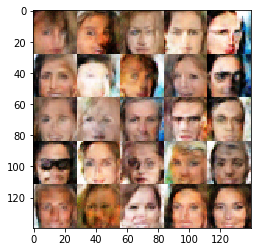

Epoch: 2/2 Discriminator Loss: 0.8065252304077148 Generator Loss: 2.572350025177002
Epoch: 2/2 Discriminator Loss: 0.43156614899635315 Generator Loss: 3.8099849224090576
Epoch: 2/2 Discriminator Loss: 1.2149693965911865 Generator Loss: 1.1451506614685059
Epoch: 2/2 Discriminator Loss: 1.2190368175506592 Generator Loss: 1.60931396484375
Epoch: 2/2 Discriminator Loss: 0.6219492554664612 Generator Loss: 1.520982265472412
Epoch: 2/2 Discriminator Loss: 1.0547699928283691 Generator Loss: 0.9961390495300293
Epoch: 2/2 Discriminator Loss: 1.5610034465789795 Generator Loss: 0.8576128482818604
Epoch: 2/2 Discriminator Loss: 0.6241176128387451 Generator Loss: 2.8129146099090576
Epoch: 2/2 Discriminator Loss: 0.7740141153335571 Generator Loss: 2.275437831878662
Epoch: 2/2 Discriminator Loss: 0.606087863445282 Generator Loss: 2.904158592224121


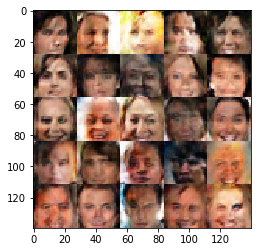

Epoch: 2/2 Discriminator Loss: 0.6928856372833252 Generator Loss: 1.3844974040985107
Epoch: 2/2 Discriminator Loss: 0.47266513109207153 Generator Loss: 1.7648906707763672
Epoch: 2/2 Discriminator Loss: 0.9063052535057068 Generator Loss: 1.2412652969360352
Epoch: 2/2 Discriminator Loss: 0.7211974263191223 Generator Loss: 2.027430534362793
Epoch: 2/2 Discriminator Loss: 0.6253529191017151 Generator Loss: 1.841172218322754
Epoch: 2/2 Discriminator Loss: 1.2591042518615723 Generator Loss: 3.0968523025512695
Epoch: 2/2 Discriminator Loss: 1.0651073455810547 Generator Loss: 0.45317649841308594
Epoch: 2/2 Discriminator Loss: 1.0462892055511475 Generator Loss: 0.7754210233688354
Epoch: 2/2 Discriminator Loss: 0.5292782783508301 Generator Loss: 2.638312339782715
Epoch: 2/2 Discriminator Loss: 0.604184627532959 Generator Loss: 2.9349634647369385


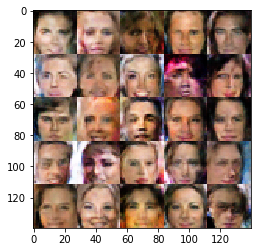

Epoch: 2/2 Discriminator Loss: 0.7782952189445496 Generator Loss: 1.9759764671325684
Epoch: 2/2 Discriminator Loss: 1.1389297246932983 Generator Loss: 3.5574631690979004
Epoch: 2/2 Discriminator Loss: 0.5126438140869141 Generator Loss: 1.8721373081207275
Epoch: 2/2 Discriminator Loss: 0.8672592639923096 Generator Loss: 1.5762453079223633
Epoch: 2/2 Discriminator Loss: 0.8439080119132996 Generator Loss: 1.713996410369873
Epoch: 2/2 Discriminator Loss: 0.7840237617492676 Generator Loss: 1.7952001094818115
Epoch: 2/2 Discriminator Loss: 0.76937335729599 Generator Loss: 0.9338075518608093
Epoch: 2/2 Discriminator Loss: 0.8034175634384155 Generator Loss: 2.4833412170410156
Epoch: 2/2 Discriminator Loss: 1.1392732858657837 Generator Loss: 1.45303475856781
Epoch: 2/2 Discriminator Loss: 0.5516825914382935 Generator Loss: 2.344331741333008


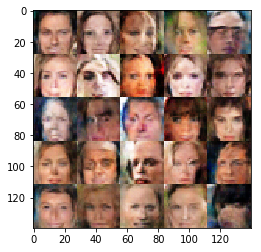

Epoch: 2/2 Discriminator Loss: 0.5717982053756714 Generator Loss: 1.9970251321792603
Epoch: 2/2 Discriminator Loss: 0.828913688659668 Generator Loss: 1.3990646600723267
Epoch: 2/2 Discriminator Loss: 1.0323642492294312 Generator Loss: 0.569545567035675
Epoch: 2/2 Discriminator Loss: 0.5492850542068481 Generator Loss: 2.4370274543762207
Epoch: 2/2 Discriminator Loss: 0.4932190775871277 Generator Loss: 3.370403528213501
Epoch: 2/2 Discriminator Loss: 0.6776182651519775 Generator Loss: 2.7847049236297607
Epoch: 2/2 Discriminator Loss: 0.5318113565444946 Generator Loss: 1.221468448638916
Epoch: 2/2 Discriminator Loss: 0.6036444902420044 Generator Loss: 2.016204357147217
Epoch: 2/2 Discriminator Loss: 0.579707682132721 Generator Loss: 1.3143560886383057
Epoch: 2/2 Discriminator Loss: 0.7220054864883423 Generator Loss: 1.2796247005462646


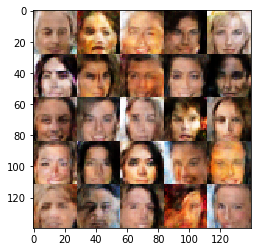

Epoch: 2/2 Discriminator Loss: 0.519353985786438 Generator Loss: 4.312085151672363
Epoch: 2/2 Discriminator Loss: 0.558995246887207 Generator Loss: 1.8237067461013794
Epoch: 2/2 Discriminator Loss: 0.8125500082969666 Generator Loss: 2.2809906005859375
Epoch: 2/2 Discriminator Loss: 0.7095038294792175 Generator Loss: 1.835737705230713
Epoch: 2/2 Discriminator Loss: 0.5435730218887329 Generator Loss: 2.157609224319458
Epoch: 2/2 Discriminator Loss: 0.7136732935905457 Generator Loss: 1.1409258842468262
Epoch: 2/2 Discriminator Loss: 0.6356757879257202 Generator Loss: 2.1060612201690674
Epoch: 2/2 Discriminator Loss: 0.6801328659057617 Generator Loss: 2.4061694145202637
Epoch: 2/2 Discriminator Loss: 0.38805869221687317 Generator Loss: 3.3234715461730957
Epoch: 2/2 Discriminator Loss: 0.8158344626426697 Generator Loss: 1.9550529718399048


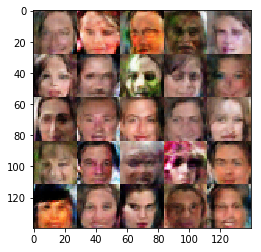

Epoch: 2/2 Discriminator Loss: 0.664115846157074 Generator Loss: 2.5904836654663086
Epoch: 2/2 Discriminator Loss: 0.48321571946144104 Generator Loss: 3.1278324127197266
Epoch: 2/2 Discriminator Loss: 0.8243221640586853 Generator Loss: 1.1221367120742798
Epoch: 2/2 Discriminator Loss: 0.9638968110084534 Generator Loss: 2.7532572746276855
Epoch: 2/2 Discriminator Loss: 0.7734464406967163 Generator Loss: 1.461556315422058
Epoch: 2/2 Discriminator Loss: 0.520841658115387 Generator Loss: 3.5198135375976562
Epoch: 2/2 Discriminator Loss: 1.3088810443878174 Generator Loss: 1.1822015047073364
Epoch: 2/2 Discriminator Loss: 0.6744250655174255 Generator Loss: 1.1589288711547852
Epoch: 2/2 Discriminator Loss: 0.5530081987380981 Generator Loss: 3.109381675720215
Epoch: 2/2 Discriminator Loss: 1.0701974630355835 Generator Loss: 1.0432581901550293


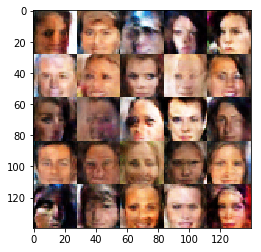

Epoch: 2/2 Discriminator Loss: 0.5800368785858154 Generator Loss: 2.441129207611084
Epoch: 2/2 Discriminator Loss: 0.5790956616401672 Generator Loss: 2.069807767868042
Epoch: 2/2 Discriminator Loss: 1.082824945449829 Generator Loss: 1.6078418493270874
Epoch: 2/2 Discriminator Loss: 0.8337115049362183 Generator Loss: 1.6516625881195068
Epoch: 2/2 Discriminator Loss: 0.7426608800888062 Generator Loss: 2.2650208473205566
Epoch: 2/2 Discriminator Loss: 0.48312997817993164 Generator Loss: 2.477550506591797
Epoch: 2/2 Discriminator Loss: 0.7452144622802734 Generator Loss: 0.812502384185791
Epoch: 2/2 Discriminator Loss: 0.49728769063949585 Generator Loss: 1.6912827491760254
Epoch: 2/2 Discriminator Loss: 0.7427015900611877 Generator Loss: 1.6776418685913086
Epoch: 2/2 Discriminator Loss: 0.8659030199050903 Generator Loss: 1.920544147491455


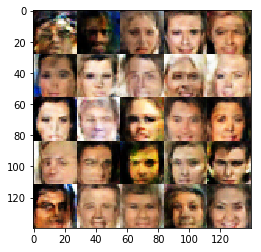

Epoch: 2/2 Discriminator Loss: 1.6495516300201416 Generator Loss: 0.35210123658180237
Epoch: 2/2 Discriminator Loss: 0.8521161675453186 Generator Loss: 1.3686678409576416
Epoch: 2/2 Discriminator Loss: 0.7161624431610107 Generator Loss: 3.3145880699157715
Epoch: 2/2 Discriminator Loss: 0.48651599884033203 Generator Loss: 2.355409622192383
Epoch: 2/2 Discriminator Loss: 0.5317462682723999 Generator Loss: 3.030806064605713
Epoch: 2/2 Discriminator Loss: 0.9062599539756775 Generator Loss: 2.308652877807617
Epoch: 2/2 Discriminator Loss: 0.5421982407569885 Generator Loss: 2.895120620727539
Epoch: 2/2 Discriminator Loss: 0.6368382573127747 Generator Loss: 0.923859715461731
Epoch: 2/2 Discriminator Loss: 0.6032677888870239 Generator Loss: 1.3268473148345947
Epoch: 2/2 Discriminator Loss: 0.5245755314826965 Generator Loss: 2.7454493045806885


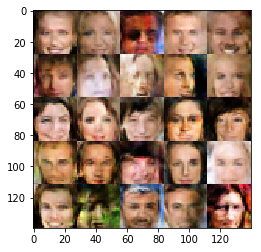

Epoch: 2/2 Discriminator Loss: 0.5099213123321533 Generator Loss: 3.0670437812805176
Epoch: 2/2 Discriminator Loss: 0.7499879002571106 Generator Loss: 1.6115269660949707
Epoch: 2/2 Discriminator Loss: 0.5709653496742249 Generator Loss: 2.7444674968719482
Epoch: 2/2 Discriminator Loss: 0.8090341091156006 Generator Loss: 1.9919390678405762
Epoch: 2/2 Discriminator Loss: 0.448325514793396 Generator Loss: 2.1808419227600098
Epoch: 2/2 Discriminator Loss: 0.766594648361206 Generator Loss: 1.337597370147705
Epoch: 2/2 Discriminator Loss: 1.4781430959701538 Generator Loss: 2.5900211334228516
Epoch: 2/2 Discriminator Loss: 0.6807484030723572 Generator Loss: 1.6523463726043701
Epoch: 2/2 Discriminator Loss: 1.1568145751953125 Generator Loss: 2.432504653930664
Epoch: 2/2 Discriminator Loss: 0.9554017186164856 Generator Loss: 1.9067656993865967


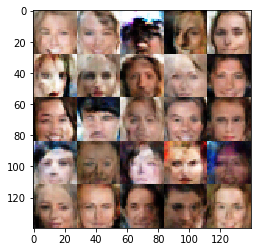

Epoch: 2/2 Discriminator Loss: 0.9592145085334778 Generator Loss: 0.35813790559768677
Epoch: 2/2 Discriminator Loss: 0.5354182720184326 Generator Loss: 1.7135456800460815
Epoch: 2/2 Discriminator Loss: 0.7165133357048035 Generator Loss: 3.2874035835266113
Epoch: 2/2 Discriminator Loss: 0.4912133514881134 Generator Loss: 2.776486396789551
Epoch: 2/2 Discriminator Loss: 0.622961163520813 Generator Loss: 2.7736573219299316
Epoch: 2/2 Discriminator Loss: 0.5779999494552612 Generator Loss: 3.6392579078674316
Epoch: 2/2 Discriminator Loss: 0.3875693082809448 Generator Loss: 2.883972644805908
Epoch: 2/2 Discriminator Loss: 0.6955418586730957 Generator Loss: 0.5670347809791565
Epoch: 2/2 Discriminator Loss: 1.1956725120544434 Generator Loss: 1.13590407371521
Epoch: 2/2 Discriminator Loss: 0.7437500357627869 Generator Loss: 2.5650620460510254


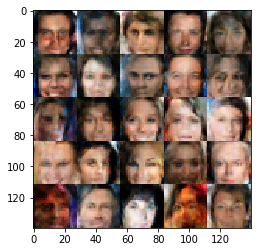

Epoch: 2/2 Discriminator Loss: 0.6764750480651855 Generator Loss: 1.2508057355880737
Epoch: 2/2 Discriminator Loss: 0.6006151437759399 Generator Loss: 2.5924692153930664
Epoch: 2/2 Discriminator Loss: 0.6048041582107544 Generator Loss: 2.1692569255828857
Epoch: 2/2 Discriminator Loss: 0.5080133676528931 Generator Loss: 1.4170055389404297
Epoch: 2/2 Discriminator Loss: 0.5977318286895752 Generator Loss: 1.4619745016098022
Epoch: 2/2 Discriminator Loss: 0.8337911367416382 Generator Loss: 0.5393223166465759
Epoch: 2/2 Discriminator Loss: 1.3475128412246704 Generator Loss: 0.8802962303161621
Epoch: 2/2 Discriminator Loss: 0.6054518818855286 Generator Loss: 2.6363372802734375
Epoch: 2/2 Discriminator Loss: 0.6536203026771545 Generator Loss: 1.5209519863128662
Epoch: 2/2 Discriminator Loss: 0.6417757272720337 Generator Loss: 4.480156898498535


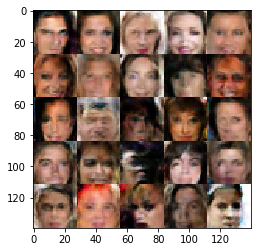

Epoch: 2/2 Discriminator Loss: 0.4315614700317383 Generator Loss: 2.8751487731933594
Epoch: 2/2 Discriminator Loss: 0.44195878505706787 Generator Loss: 3.1542510986328125
Epoch: 2/2 Discriminator Loss: 0.8480610847473145 Generator Loss: 1.4018795490264893
Epoch: 2/2 Discriminator Loss: 0.439519464969635 Generator Loss: 2.789454460144043
Epoch: 2/2 Discriminator Loss: 0.4861660897731781 Generator Loss: 2.280318260192871
Epoch: 2/2 Discriminator Loss: 0.7375422716140747 Generator Loss: 3.205164670944214
Epoch: 2/2 Discriminator Loss: 0.624879777431488 Generator Loss: 1.717630386352539
Epoch: 2/2 Discriminator Loss: 0.7231060266494751 Generator Loss: 0.6654268503189087
Epoch: 2/2 Discriminator Loss: 0.6645740270614624 Generator Loss: 3.4212636947631836
Epoch: 2/2 Discriminator Loss: 0.4953281879425049 Generator Loss: 2.7032275199890137


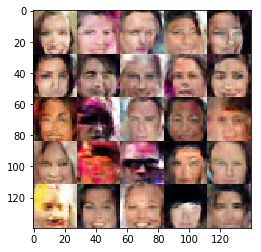

Epoch: 2/2 Discriminator Loss: 0.45140954852104187 Generator Loss: 3.6098227500915527
Epoch: 2/2 Discriminator Loss: 1.3837796449661255 Generator Loss: 2.5976340770721436
Epoch: 2/2 Discriminator Loss: 0.7315593957901001 Generator Loss: 1.3221685886383057
Epoch: 2/2 Discriminator Loss: 0.7081911563873291 Generator Loss: 2.43811297416687
Epoch: 2/2 Discriminator Loss: 0.6923203468322754 Generator Loss: 1.8767237663269043
Epoch: 2/2 Discriminator Loss: 0.637939453125 Generator Loss: 2.94297456741333
Epoch: 2/2 Discriminator Loss: 0.6251356601715088 Generator Loss: 1.499302625656128
Epoch: 2/2 Discriminator Loss: 0.8300352692604065 Generator Loss: 1.8364440202713013
Epoch: 2/2 Discriminator Loss: 0.4851626753807068 Generator Loss: 3.146355152130127
Epoch: 2/2 Discriminator Loss: 0.7309967279434204 Generator Loss: 2.7216761112213135


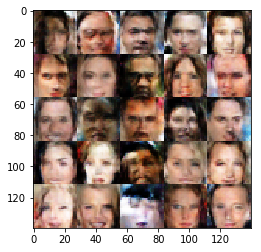

Epoch: 2/2 Discriminator Loss: 0.4818953275680542 Generator Loss: 2.5864553451538086
Epoch: 2/2 Discriminator Loss: 0.6207097768783569 Generator Loss: 1.7380290031433105
Epoch: 2/2 Discriminator Loss: 0.8594169616699219 Generator Loss: 2.3082447052001953
Epoch: 2/2 Discriminator Loss: 1.3734283447265625 Generator Loss: 2.6121268272399902
Epoch: 2/2 Discriminator Loss: 0.8900116682052612 Generator Loss: 1.0604658126831055
Epoch: 2/2 Discriminator Loss: 0.6666178703308105 Generator Loss: 1.7402369976043701
Epoch: 2/2 Discriminator Loss: 0.5210776329040527 Generator Loss: 2.205289602279663
Epoch: 2/2 Discriminator Loss: 0.8688012361526489 Generator Loss: 0.9319134950637817
Epoch: 2/2 Discriminator Loss: 0.7868881225585938 Generator Loss: 2.4453041553497314
Epoch: 2/2 Discriminator Loss: 0.41704824566841125 Generator Loss: 2.590693473815918


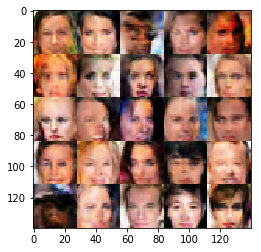

Epoch: 2/2 Discriminator Loss: 0.5582127571105957 Generator Loss: 2.085724115371704
Epoch: 2/2 Discriminator Loss: 0.6270666122436523 Generator Loss: 1.640882968902588
Epoch: 2/2 Discriminator Loss: 0.6172117590904236 Generator Loss: 2.7822866439819336
Epoch: 2/2 Discriminator Loss: 0.6493879556655884 Generator Loss: 2.293886184692383
Epoch: 2/2 Discriminator Loss: 0.9999767541885376 Generator Loss: 2.8187599182128906
Epoch: 2/2 Discriminator Loss: 0.47923606634140015 Generator Loss: 2.4222240447998047
Epoch: 2/2 Discriminator Loss: 0.42419111728668213 Generator Loss: 2.927095413208008
Epoch: 2/2 Discriminator Loss: 0.7586904168128967 Generator Loss: 1.9858379364013672
Epoch: 2/2 Discriminator Loss: 0.819632887840271 Generator Loss: 2.429076671600342
Epoch: 2/2 Discriminator Loss: 1.123849630355835 Generator Loss: 1.0192067623138428


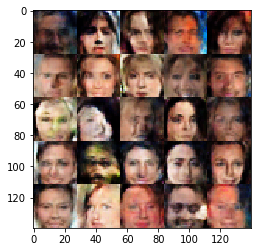

Epoch: 2/2 Discriminator Loss: 0.9352498054504395 Generator Loss: 1.7274787425994873
Epoch: 2/2 Discriminator Loss: 0.5725675821304321 Generator Loss: 1.4676165580749512
Epoch: 2/2 Discriminator Loss: 0.5317114591598511 Generator Loss: 1.4821770191192627
Epoch: 2/2 Discriminator Loss: 0.5304684638977051 Generator Loss: 2.4328675270080566
Epoch: 2/2 Discriminator Loss: 0.7630252838134766 Generator Loss: 2.694572925567627
Epoch: 2/2 Discriminator Loss: 0.6868167519569397 Generator Loss: 1.4615367650985718
Epoch: 2/2 Discriminator Loss: 0.756223738193512 Generator Loss: 1.395728588104248
Epoch: 2/2 Discriminator Loss: 1.2200819253921509 Generator Loss: 1.2282907962799072
Epoch: 2/2 Discriminator Loss: 0.4407983124256134 Generator Loss: 2.129277467727661
Epoch: 2/2 Discriminator Loss: 0.7982531785964966 Generator Loss: 1.9520303010940552


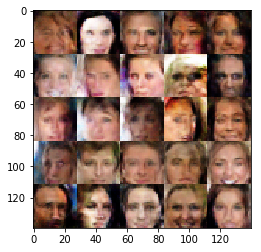

Epoch: 2/2 Discriminator Loss: 0.6470555663108826 Generator Loss: 0.9913502931594849
Epoch: 2/2 Discriminator Loss: 0.9905740022659302 Generator Loss: 2.213711738586426
Epoch: 2/2 Discriminator Loss: 0.8443561792373657 Generator Loss: 0.9893218278884888
Epoch: 2/2 Discriminator Loss: 0.7551845908164978 Generator Loss: 1.54165518283844
Epoch: 2/2 Discriminator Loss: 0.8942873477935791 Generator Loss: 1.565441608428955
Epoch: 2/2 Discriminator Loss: 0.6627646684646606 Generator Loss: 1.5208196640014648
Epoch: 2/2 Discriminator Loss: 0.9252092242240906 Generator Loss: 0.774027407169342
Epoch: 2/2 Discriminator Loss: 0.6367523670196533 Generator Loss: 3.191274642944336
Epoch: 2/2 Discriminator Loss: 1.1408382654190063 Generator Loss: 1.8856143951416016
Epoch: 2/2 Discriminator Loss: 0.6107124090194702 Generator Loss: 2.344771385192871


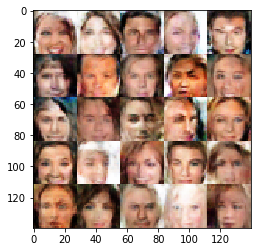

Epoch: 2/2 Discriminator Loss: 1.0241985321044922 Generator Loss: 1.0138137340545654
Epoch: 2/2 Discriminator Loss: 0.4785597622394562 Generator Loss: 0.9055870175361633
Epoch: 2/2 Discriminator Loss: 0.5596438050270081 Generator Loss: 3.313416004180908
Epoch: 2/2 Discriminator Loss: 0.6743051409721375 Generator Loss: 2.365163564682007
Epoch: 2/2 Discriminator Loss: 0.46852415800094604 Generator Loss: 1.8582677841186523
Epoch: 2/2 Discriminator Loss: 0.7168119549751282 Generator Loss: 3.2271416187286377
Epoch: 2/2 Discriminator Loss: 0.7761178016662598 Generator Loss: 3.3494091033935547
Epoch: 2/2 Discriminator Loss: 0.6355370879173279 Generator Loss: 1.0026302337646484
Epoch: 2/2 Discriminator Loss: 0.6879907846450806 Generator Loss: 0.7455391883850098
Epoch: 2/2 Discriminator Loss: 0.5096620917320251 Generator Loss: 2.7035083770751953


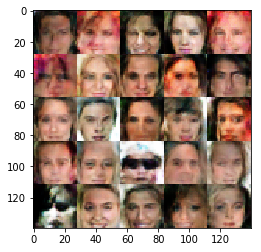

Epoch: 2/2 Discriminator Loss: 1.15131676197052 Generator Loss: 1.1180733442306519
Epoch: 2/2 Discriminator Loss: 0.7968932390213013 Generator Loss: 2.3149373531341553
Epoch: 2/2 Discriminator Loss: 0.8335027694702148 Generator Loss: 2.57375431060791
Epoch: 2/2 Discriminator Loss: 0.9687115550041199 Generator Loss: 1.3356318473815918
Epoch: 2/2 Discriminator Loss: 0.601852536201477 Generator Loss: 3.6460533142089844
Epoch: 2/2 Discriminator Loss: 0.8273055553436279 Generator Loss: 1.9203476905822754
Epoch: 2/2 Discriminator Loss: 1.9693468809127808 Generator Loss: 3.4957876205444336
Epoch: 2/2 Discriminator Loss: 0.5940873622894287 Generator Loss: 1.5964319705963135
Epoch: 2/2 Discriminator Loss: 0.5974696278572083 Generator Loss: 2.3130006790161133
Epoch: 2/2 Discriminator Loss: 0.48554548621177673 Generator Loss: 3.592883825302124


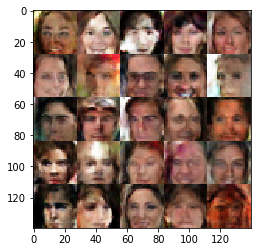

Epoch: 2/2 Discriminator Loss: 0.7881834506988525 Generator Loss: 1.2551196813583374
Epoch: 2/2 Discriminator Loss: 0.8024952411651611 Generator Loss: 2.1091015338897705
Epoch: 2/2 Discriminator Loss: 0.645102858543396 Generator Loss: 2.4117772579193115
Epoch: 2/2 Discriminator Loss: 0.7601395845413208 Generator Loss: 1.60882568359375
Epoch: 2/2 Discriminator Loss: 0.5545396208763123 Generator Loss: 1.4422061443328857
Epoch: 2/2 Discriminator Loss: 0.6063728332519531 Generator Loss: 0.9573752880096436
Epoch: 2/2 Discriminator Loss: 0.5019165873527527 Generator Loss: 3.5855860710144043
Epoch: 2/2 Discriminator Loss: 0.6160075664520264 Generator Loss: 3.1471071243286133
Epoch: 2/2 Discriminator Loss: 0.5998790264129639 Generator Loss: 2.053429126739502
Epoch: 2/2 Discriminator Loss: 0.6685646176338196 Generator Loss: 1.3859118223190308


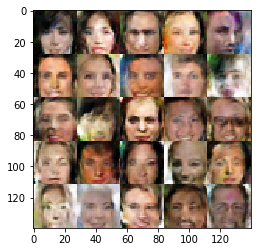

Epoch: 2/2 Discriminator Loss: 0.4500714838504791 Generator Loss: 2.6641147136688232
Epoch: 2/2 Discriminator Loss: 0.9049383401870728 Generator Loss: 2.4380297660827637
Epoch: 2/2 Discriminator Loss: 0.835563600063324 Generator Loss: 2.180309534072876
Epoch: 2/2 Discriminator Loss: 1.1006031036376953 Generator Loss: 4.685955047607422
Epoch: 2/2 Discriminator Loss: 0.49755823612213135 Generator Loss: 2.9978795051574707
Epoch: 2/2 Discriminator Loss: 0.847263753414154 Generator Loss: 2.133594512939453
Epoch: 2/2 Discriminator Loss: 0.4744381308555603 Generator Loss: 2.3930516242980957
Epoch: 2/2 Discriminator Loss: 0.685244083404541 Generator Loss: 2.3160085678100586
Epoch: 2/2 Discriminator Loss: 0.531592845916748 Generator Loss: 2.8934357166290283
Epoch: 2/2 Discriminator Loss: 0.47492533922195435 Generator Loss: 3.3867201805114746


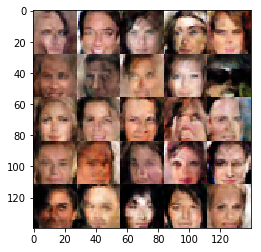

Epoch: 2/2 Discriminator Loss: 0.5101889967918396 Generator Loss: 1.4619271755218506
Epoch: 2/2 Discriminator Loss: 0.9238832592964172 Generator Loss: 2.2062742710113525
Epoch: 2/2 Discriminator Loss: 0.6909545660018921 Generator Loss: 0.4371975064277649
Epoch: 2/2 Discriminator Loss: 0.6932438015937805 Generator Loss: 1.5183308124542236
Epoch: 2/2 Discriminator Loss: 0.9215984344482422 Generator Loss: 1.8799062967300415
Epoch: 2/2 Discriminator Loss: 0.8190590739250183 Generator Loss: 2.019120216369629
Epoch: 2/2 Discriminator Loss: 0.4337419867515564 Generator Loss: 1.5422296524047852
Epoch: 2/2 Discriminator Loss: 0.7649523019790649 Generator Loss: 3.0010955333709717
Epoch: 2/2 Discriminator Loss: 0.6701875925064087 Generator Loss: 3.4913487434387207
Epoch: 2/2 Discriminator Loss: 0.41796010732650757 Generator Loss: 2.1891274452209473


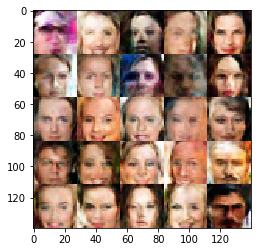

Epoch: 2/2 Discriminator Loss: 0.7933300733566284 Generator Loss: 2.078625202178955
Epoch: 2/2 Discriminator Loss: 0.8144495487213135 Generator Loss: 1.2998275756835938
Epoch: 2/2 Discriminator Loss: 0.47355180978775024 Generator Loss: 2.703996181488037
Epoch: 2/2 Discriminator Loss: 0.4223877787590027 Generator Loss: 4.140074253082275
Epoch: 2/2 Discriminator Loss: 0.7740087509155273 Generator Loss: 2.516996383666992
Epoch: 2/2 Discriminator Loss: 0.7985518574714661 Generator Loss: 0.5050827264785767
Epoch: 2/2 Discriminator Loss: 0.8631988763809204 Generator Loss: 1.7977980375289917
Epoch: 2/2 Discriminator Loss: 0.5461596250534058 Generator Loss: 1.9464842081069946
Epoch: 2/2 Discriminator Loss: 0.9434768557548523 Generator Loss: 1.3847434520721436
Epoch: 2/2 Discriminator Loss: 0.7656688690185547 Generator Loss: 1.6635947227478027


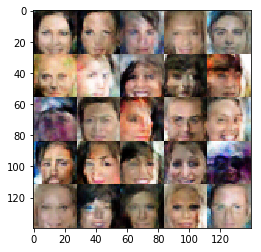

Epoch: 2/2 Discriminator Loss: 0.8798088431358337 Generator Loss: 1.1967875957489014
Epoch: 2/2 Discriminator Loss: 0.5400645732879639 Generator Loss: 3.511306047439575
Epoch: 2/2 Discriminator Loss: 0.8351778984069824 Generator Loss: 2.4915482997894287
Epoch: 2/2 Discriminator Loss: 0.7439672350883484 Generator Loss: 1.474839448928833
Epoch: 2/2 Discriminator Loss: 0.7347955703735352 Generator Loss: 2.7159061431884766
Epoch: 2/2 Discriminator Loss: 0.5268369317054749 Generator Loss: 1.4450037479400635
Epoch: 2/2 Discriminator Loss: 0.639265239238739 Generator Loss: 1.7013697624206543
Epoch: 2/2 Discriminator Loss: 0.453508585691452 Generator Loss: 3.375286102294922
Epoch: 2/2 Discriminator Loss: 0.6654102802276611 Generator Loss: 4.110942363739014
Epoch: 2/2 Discriminator Loss: 0.8241828083992004 Generator Loss: 1.7513349056243896


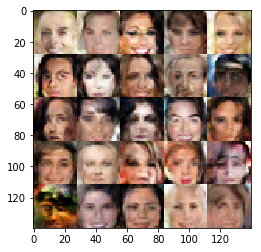

Epoch: 2/2 Discriminator Loss: 0.5337437391281128 Generator Loss: 2.0397119522094727
Epoch: 2/2 Discriminator Loss: 1.0289536714553833 Generator Loss: 1.9114477634429932
Epoch: 2/2 Discriminator Loss: 0.4677894115447998 Generator Loss: 2.460094451904297
Epoch: 2/2 Discriminator Loss: 0.5525195598602295 Generator Loss: 2.4472122192382812
Epoch: 2/2 Discriminator Loss: 0.6678758859634399 Generator Loss: 1.694198727607727
Epoch: 2/2 Discriminator Loss: 0.4548652768135071 Generator Loss: 2.080803871154785
Epoch: 2/2 Discriminator Loss: 1.216505527496338 Generator Loss: 1.6753525733947754
Epoch: 2/2 Discriminator Loss: 0.5531883239746094 Generator Loss: 2.5707345008850098
Epoch: 2/2 Discriminator Loss: 0.5316115021705627 Generator Loss: 2.355991840362549
Epoch: 2/2 Discriminator Loss: 0.5644218921661377 Generator Loss: 2.151416063308716


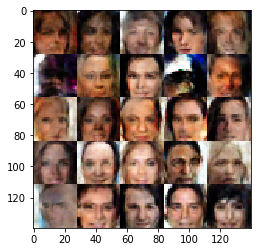

Epoch: 2/2 Discriminator Loss: 0.8289911150932312 Generator Loss: 2.074275493621826
Epoch: 2/2 Discriminator Loss: 0.4140380620956421 Generator Loss: 3.359539031982422
Epoch: 2/2 Discriminator Loss: 0.642707347869873 Generator Loss: 1.976686954498291
Epoch: 2/2 Discriminator Loss: 1.6164543628692627 Generator Loss: 0.8290950059890747
Epoch: 2/2 Discriminator Loss: 0.7020176649093628 Generator Loss: 2.619265079498291
Epoch: 2/2 Discriminator Loss: 0.5593609809875488 Generator Loss: 3.7356789112091064
Epoch: 2/2 Discriminator Loss: 0.5666509866714478 Generator Loss: 2.2824625968933105
Epoch: 2/2 Discriminator Loss: 0.6341434121131897 Generator Loss: 1.4216618537902832
Epoch: 2/2 Discriminator Loss: 0.7213972210884094 Generator Loss: 3.008316993713379
Epoch: 2/2 Discriminator Loss: 0.9967843294143677 Generator Loss: 3.0141689777374268


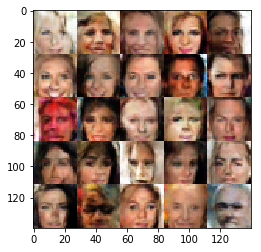

Epoch: 2/2 Discriminator Loss: 0.541953444480896 Generator Loss: 2.0447185039520264
Epoch: 2/2 Discriminator Loss: 0.5520516633987427 Generator Loss: 1.4402923583984375
Epoch: 2/2 Discriminator Loss: 0.561813235282898 Generator Loss: 3.416107416152954
Epoch: 2/2 Discriminator Loss: 0.9469165802001953 Generator Loss: 1.2130851745605469
Epoch: 2/2 Discriminator Loss: 0.8990458250045776 Generator Loss: 2.776541233062744
Epoch: 2/2 Discriminator Loss: 0.7039205431938171 Generator Loss: 2.0579538345336914
Epoch: 2/2 Discriminator Loss: 0.6579364538192749 Generator Loss: 2.997866630554199
Epoch: 2/2 Discriminator Loss: 0.7864428758621216 Generator Loss: 1.4953724145889282
Epoch: 2/2 Discriminator Loss: 1.3032982349395752 Generator Loss: 1.8400297164916992
Epoch: 2/2 Discriminator Loss: 0.6006309986114502 Generator Loss: 2.596959114074707


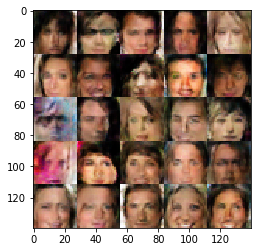

Epoch: 2/2 Discriminator Loss: 0.5329334735870361 Generator Loss: 2.1424102783203125
Epoch: 2/2 Discriminator Loss: 0.6511001586914062 Generator Loss: 1.3969645500183105
Epoch: 2/2 Discriminator Loss: 0.9939824342727661 Generator Loss: 0.25605309009552
Epoch: 2/2 Discriminator Loss: 0.6218858957290649 Generator Loss: 2.141207218170166
Epoch: 2/2 Discriminator Loss: 0.6888202428817749 Generator Loss: 1.803941011428833
Epoch: 2/2 Discriminator Loss: 0.7885079383850098 Generator Loss: 4.536449432373047
Epoch: 2/2 Discriminator Loss: 0.5605545043945312 Generator Loss: 2.6715774536132812
Epoch: 2/2 Discriminator Loss: 0.6393629312515259 Generator Loss: 1.4809595346450806
Epoch: 2/2 Discriminator Loss: 0.6877318620681763 Generator Loss: 1.3317108154296875
Epoch: 2/2 Discriminator Loss: 0.6969177722930908 Generator Loss: 2.5964038372039795


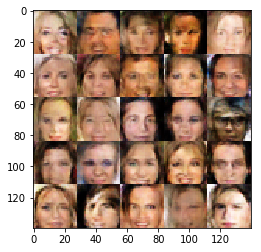

Epoch: 2/2 Discriminator Loss: 0.7422300577163696 Generator Loss: 1.071181058883667
Epoch: 2/2 Discriminator Loss: 0.4985412359237671 Generator Loss: 2.487398386001587
Epoch: 2/2 Discriminator Loss: 0.4664496183395386 Generator Loss: 2.6131324768066406
Epoch: 2/2 Discriminator Loss: 0.49397847056388855 Generator Loss: 2.4290614128112793
Epoch: 2/2 Discriminator Loss: 0.7969799041748047 Generator Loss: 2.1199488639831543
Epoch: 2/2 Discriminator Loss: 1.0319161415100098 Generator Loss: 1.9152936935424805
Epoch: 2/2 Discriminator Loss: 0.6653686165809631 Generator Loss: 2.1235766410827637
Epoch: 2/2 Discriminator Loss: 0.6350544691085815 Generator Loss: 2.7629199028015137
Epoch: 2/2 Discriminator Loss: 0.9199665784835815 Generator Loss: 3.0723044872283936
Epoch: 2/2 Discriminator Loss: 0.987835168838501 Generator Loss: 2.22527813911438


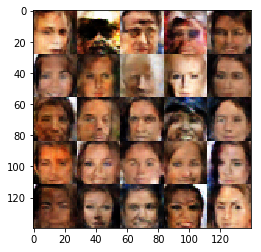

Epoch: 2/2 Discriminator Loss: 0.4888313412666321 Generator Loss: 2.128004550933838
Epoch: 2/2 Discriminator Loss: 0.6401609182357788 Generator Loss: 2.690927505493164
Epoch: 2/2 Discriminator Loss: 0.6251765489578247 Generator Loss: 2.4087905883789062
Epoch: 2/2 Discriminator Loss: 0.6583079099655151 Generator Loss: 2.042809009552002
Epoch: 2/2 Discriminator Loss: 0.5436244010925293 Generator Loss: 2.608165740966797
Epoch: 2/2 Discriminator Loss: 0.9541314840316772 Generator Loss: 1.4377301931381226
Epoch: 2/2 Discriminator Loss: 0.9029737114906311 Generator Loss: 3.643101215362549
Epoch: 2/2 Discriminator Loss: 0.7104737758636475 Generator Loss: 2.736795425415039
Epoch: 2/2 Discriminator Loss: 0.6878162622451782 Generator Loss: 3.070651054382324
Epoch: 2/2 Discriminator Loss: 0.6278080940246582 Generator Loss: 2.2728371620178223


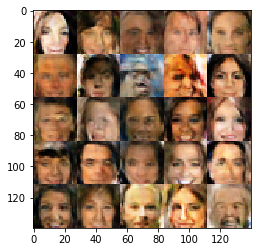

Epoch: 2/2 Discriminator Loss: 0.638007402420044 Generator Loss: 1.7655941247940063
Epoch: 2/2 Discriminator Loss: 0.6328787207603455 Generator Loss: 2.089190721511841
Epoch: 2/2 Discriminator Loss: 0.7259486317634583 Generator Loss: 1.9512035846710205
Epoch: 2/2 Discriminator Loss: 1.3571252822875977 Generator Loss: 1.2080782651901245
Epoch: 2/2 Discriminator Loss: 0.8006916046142578 Generator Loss: 2.8468692302703857
Epoch: 2/2 Discriminator Loss: 0.8539639115333557 Generator Loss: 2.7150206565856934
Epoch: 2/2 Discriminator Loss: 0.45253098011016846 Generator Loss: 2.8809242248535156
Epoch: 2/2 Discriminator Loss: 0.42403364181518555 Generator Loss: 4.61862850189209
Epoch: 2/2 Discriminator Loss: 0.43545857071876526 Generator Loss: 0.7178898453712463
Epoch: 2/2 Discriminator Loss: 0.8332712650299072 Generator Loss: 1.8909471035003662


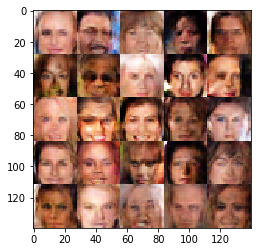

Epoch: 2/2 Discriminator Loss: 1.001259446144104 Generator Loss: 1.5758075714111328
Epoch: 2/2 Discriminator Loss: 0.5487741827964783 Generator Loss: 4.261196136474609
Epoch: 2/2 Discriminator Loss: 0.9312946796417236 Generator Loss: 1.4561865329742432
Epoch: 2/2 Discriminator Loss: 0.8538706302642822 Generator Loss: 2.216282367706299
Epoch: 2/2 Discriminator Loss: 0.5956385731697083 Generator Loss: 1.3527741432189941
Epoch: 2/2 Discriminator Loss: 0.5949413180351257 Generator Loss: 2.388509511947632
Epoch: 2/2 Discriminator Loss: 0.6389709115028381 Generator Loss: 2.257293224334717
Epoch: 2/2 Discriminator Loss: 1.1819853782653809 Generator Loss: 1.4986298084259033
Epoch: 2/2 Discriminator Loss: 0.6540778875350952 Generator Loss: 2.2660484313964844
Epoch: 2/2 Discriminator Loss: 0.6652394533157349 Generator Loss: 1.4690479040145874


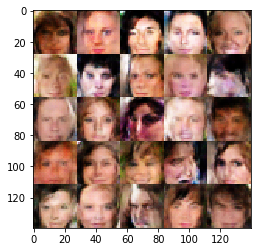

Epoch: 2/2 Discriminator Loss: 0.6363425850868225 Generator Loss: 2.9329447746276855
Epoch: 2/2 Discriminator Loss: 0.7654474377632141 Generator Loss: 1.9969170093536377
Epoch: 2/2 Discriminator Loss: 1.175494909286499 Generator Loss: 1.903778314590454
Epoch: 2/2 Discriminator Loss: 0.8495775461196899 Generator Loss: 4.252388954162598
Epoch: 2/2 Discriminator Loss: 0.7368488311767578 Generator Loss: 2.1513986587524414
Epoch: 2/2 Discriminator Loss: 0.5798426866531372 Generator Loss: 2.134464979171753
Epoch: 2/2 Discriminator Loss: 0.9803914427757263 Generator Loss: 1.6236546039581299
Epoch: 2/2 Discriminator Loss: 0.7105121612548828 Generator Loss: 2.4351396560668945
Epoch: 2/2 Discriminator Loss: 0.5599549412727356 Generator Loss: 2.44638729095459
Epoch: 2/2 Discriminator Loss: 0.6723796725273132 Generator Loss: 3.69038462638855


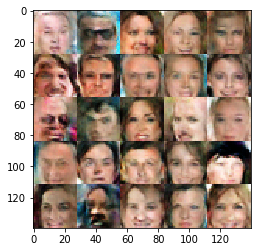

Epoch: 2/2 Discriminator Loss: 0.5569078326225281 Generator Loss: 3.5729146003723145
Epoch: 2/2 Discriminator Loss: 0.3999590575695038 Generator Loss: 3.315352439880371
Epoch: 2/2 Discriminator Loss: 0.6653105020523071 Generator Loss: 1.7836439609527588
Epoch: 2/2 Discriminator Loss: 0.4790329039096832 Generator Loss: 2.843153953552246
Epoch: 2/2 Discriminator Loss: 0.6523739099502563 Generator Loss: 1.8140606880187988
Epoch: 2/2 Discriminator Loss: 0.8052486181259155 Generator Loss: 3.616804599761963
Epoch: 2/2 Discriminator Loss: 0.7544680833816528 Generator Loss: 1.9624758958816528
Epoch: 2/2 Discriminator Loss: 0.48826634883880615 Generator Loss: 2.9140100479125977
Epoch: 2/2 Discriminator Loss: 0.5522909760475159 Generator Loss: 3.830517292022705
Epoch: 2/2 Discriminator Loss: 0.43077826499938965 Generator Loss: 3.392040967941284


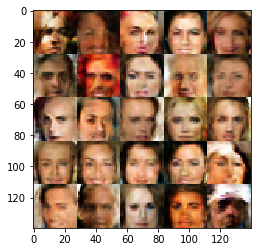

Epoch: 2/2 Discriminator Loss: 0.6284216046333313 Generator Loss: 3.351541519165039
Epoch: 2/2 Discriminator Loss: 0.42451024055480957 Generator Loss: 2.9407191276550293
Epoch: 2/2 Discriminator Loss: 0.5773401260375977 Generator Loss: 3.0885632038116455
Epoch: 2/2 Discriminator Loss: 0.7608400583267212 Generator Loss: 3.141191005706787
Epoch: 2/2 Discriminator Loss: 0.6326707005500793 Generator Loss: 2.5473947525024414
Epoch: 2/2 Discriminator Loss: 0.5568490028381348 Generator Loss: 2.4363503456115723
Epoch: 2/2 Discriminator Loss: 0.9315703511238098 Generator Loss: 1.6466087102890015
Epoch: 2/2 Discriminator Loss: 0.5442590713500977 Generator Loss: 3.0548291206359863
Epoch: 2/2 Discriminator Loss: 0.6830522418022156 Generator Loss: 2.9179983139038086
Epoch: 2/2 Discriminator Loss: 0.5431584119796753 Generator Loss: 2.1389503479003906


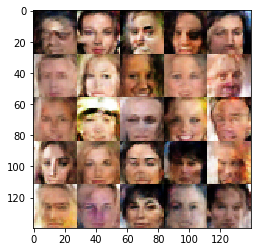

Epoch: 2/2 Discriminator Loss: 0.5434530973434448 Generator Loss: 3.1075096130371094
Epoch: 2/2 Discriminator Loss: 0.7088912725448608 Generator Loss: 2.625328779220581
Epoch: 2/2 Discriminator Loss: 0.6737509369850159 Generator Loss: 3.259324550628662
Epoch: 2/2 Discriminator Loss: 0.4501601755619049 Generator Loss: 2.9246985912323
Epoch: 2/2 Discriminator Loss: 0.6729998588562012 Generator Loss: 2.5408830642700195
Epoch: 2/2 Discriminator Loss: 0.9164950847625732 Generator Loss: 3.1568918228149414
Epoch: 2/2 Discriminator Loss: 0.5763438940048218 Generator Loss: 1.6430907249450684
Epoch: 2/2 Discriminator Loss: 0.9003013372421265 Generator Loss: 2.566072702407837
Epoch: 2/2 Discriminator Loss: 0.8164383172988892 Generator Loss: 3.4618747234344482
Epoch: 2/2 Discriminator Loss: 0.4586743414402008 Generator Loss: 4.6744279861450195


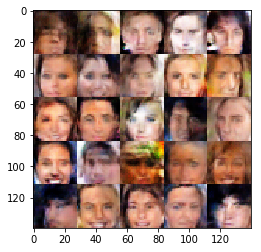

Epoch: 2/2 Discriminator Loss: 0.85202956199646 Generator Loss: 1.7785370349884033
Epoch: 2/2 Discriminator Loss: 0.6095210909843445 Generator Loss: 2.5882933139801025
Epoch: 2/2 Discriminator Loss: 1.0370537042617798 Generator Loss: 3.900669574737549
Epoch: 2/2 Discriminator Loss: 0.4511535167694092 Generator Loss: 2.265129804611206
Epoch: 2/2 Discriminator Loss: 1.4175852537155151 Generator Loss: 1.3108903169631958
Epoch: 2/2 Discriminator Loss: 0.5132381916046143 Generator Loss: 1.0134779214859009
Epoch: 2/2 Discriminator Loss: 0.6267733573913574 Generator Loss: 2.5578253269195557
Epoch: 2/2 Discriminator Loss: 0.5717381238937378 Generator Loss: 2.3514907360076904
Epoch: 2/2 Discriminator Loss: 1.5045934915542603 Generator Loss: 2.0175018310546875
Epoch: 2/2 Discriminator Loss: 0.4054943025112152 Generator Loss: 5.01948356628418


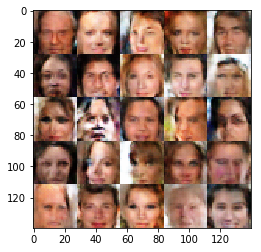

Epoch: 2/2 Discriminator Loss: 0.70125412940979 Generator Loss: 2.4618358612060547
Epoch: 2/2 Discriminator Loss: 0.8214713931083679 Generator Loss: 1.1840972900390625
Epoch: 2/2 Discriminator Loss: 0.7621986269950867 Generator Loss: 1.5923486948013306
Epoch: 2/2 Discriminator Loss: 1.0218762159347534 Generator Loss: 1.37148916721344
Epoch: 2/2 Discriminator Loss: 0.6687935590744019 Generator Loss: 1.6509678363800049
Epoch: 2/2 Discriminator Loss: 0.5930426120758057 Generator Loss: 2.7876644134521484
Epoch: 2/2 Discriminator Loss: 0.8351262807846069 Generator Loss: 4.170393943786621
Epoch: 2/2 Discriminator Loss: 0.514258086681366 Generator Loss: 1.5024127960205078
Epoch: 2/2 Discriminator Loss: 0.47224390506744385 Generator Loss: 2.081080913543701
Epoch: 2/2 Discriminator Loss: 0.5254368782043457 Generator Loss: 2.6909871101379395


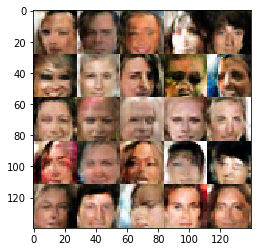

Epoch: 2/2 Discriminator Loss: 0.6638721227645874 Generator Loss: 3.6518187522888184
Epoch: 2/2 Discriminator Loss: 0.7311098575592041 Generator Loss: 1.8489480018615723
Epoch: 2/2 Discriminator Loss: 0.5780224800109863 Generator Loss: 2.3169736862182617
Epoch: 2/2 Discriminator Loss: 0.9777255654335022 Generator Loss: 2.8742470741271973
Epoch: 2/2 Discriminator Loss: 1.1818745136260986 Generator Loss: 1.6387883424758911
Epoch: 2/2 Discriminator Loss: 0.9186614751815796 Generator Loss: 2.831906318664551
Epoch: 2/2 Discriminator Loss: 0.5530849695205688 Generator Loss: 1.5794321298599243
Epoch: 2/2 Discriminator Loss: 0.5500897765159607 Generator Loss: 3.2947897911071777
Epoch: 2/2 Discriminator Loss: 0.5783653259277344 Generator Loss: 2.6610536575317383
Epoch: 2/2 Discriminator Loss: 1.4572609663009644 Generator Loss: 4.009459495544434


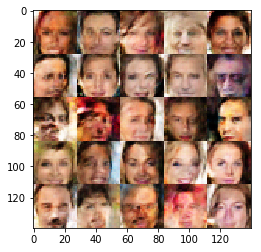

Epoch: 2/2 Discriminator Loss: 0.8053023815155029 Generator Loss: 4.557636737823486
Epoch: 2/2 Discriminator Loss: 0.759905993938446 Generator Loss: 2.325803279876709
Epoch: 2/2 Discriminator Loss: 0.8184304237365723 Generator Loss: 1.5562736988067627
Epoch: 2/2 Discriminator Loss: 1.1015185117721558 Generator Loss: 4.09510612487793
Epoch: 2/2 Discriminator Loss: 0.7085431218147278 Generator Loss: 1.596300482749939
Epoch: 2/2 Discriminator Loss: 0.6547451019287109 Generator Loss: 1.6616528034210205
Epoch: 2/2 Discriminator Loss: 1.260925054550171 Generator Loss: 1.1471611261367798
Epoch: 2/2 Discriminator Loss: 1.0440075397491455 Generator Loss: 1.9319477081298828
Epoch: 2/2 Discriminator Loss: 0.5401950478553772 Generator Loss: 2.3843812942504883
Epoch: 2/2 Discriminator Loss: 1.0722085237503052 Generator Loss: 0.9628603458404541


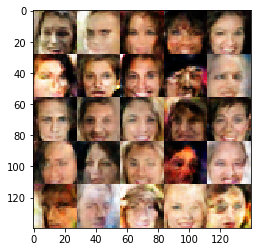

Epoch: 2/2 Discriminator Loss: 1.0194518566131592 Generator Loss: 2.8112258911132812
Epoch: 2/2 Discriminator Loss: 0.9910818338394165 Generator Loss: 0.9856817722320557
Epoch: 2/2 Discriminator Loss: 0.6665902137756348 Generator Loss: 3.0515220165252686
Epoch: 2/2 Discriminator Loss: 0.6747052669525146 Generator Loss: 2.682654857635498
Epoch: 2/2 Discriminator Loss: 0.7843961715698242 Generator Loss: 1.9378154277801514
Epoch: 2/2 Discriminator Loss: 0.5719504952430725 Generator Loss: 2.3809919357299805
Epoch: 2/2 Discriminator Loss: 1.4503498077392578 Generator Loss: 0.8207619190216064
Epoch: 2/2 Discriminator Loss: 0.6586389541625977 Generator Loss: 2.1822714805603027
Epoch: 2/2 Discriminator Loss: 0.849872350692749 Generator Loss: 2.265364170074463
Epoch: 2/2 Discriminator Loss: 0.9258019924163818 Generator Loss: 1.2302926778793335


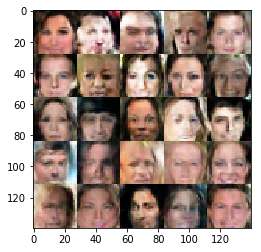

Epoch: 2/2 Discriminator Loss: 1.2408714294433594 Generator Loss: 2.5123889446258545
Epoch: 2/2 Discriminator Loss: 0.6015940308570862 Generator Loss: 1.5818854570388794
Epoch: 2/2 Discriminator Loss: 0.6797071099281311 Generator Loss: 2.1849894523620605
Epoch: 2/2 Discriminator Loss: 0.46039578318595886 Generator Loss: 2.3880906105041504
Epoch: 2/2 Discriminator Loss: 0.9294805526733398 Generator Loss: 1.095503807067871
Epoch: 2/2 Discriminator Loss: 0.7259101867675781 Generator Loss: 1.7632430791854858
Epoch: 2/2 Discriminator Loss: 0.5026166439056396 Generator Loss: 3.3824543952941895
Epoch: 2/2 Discriminator Loss: 0.655631422996521 Generator Loss: 3.650813102722168
Epoch: 2/2 Discriminator Loss: 0.8295923471450806 Generator Loss: 1.7672278881072998
Epoch: 2/2 Discriminator Loss: 0.7981691360473633 Generator Loss: 3.137990713119507


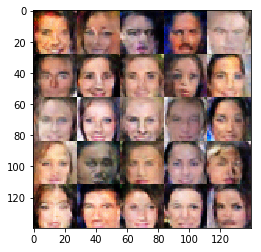

Epoch: 2/2 Discriminator Loss: 0.802791178226471 Generator Loss: 2.925820827484131
Epoch: 2/2 Discriminator Loss: 0.7104697823524475 Generator Loss: 0.933069109916687
Epoch: 2/2 Discriminator Loss: 0.6495059728622437 Generator Loss: 1.2705368995666504
Epoch: 2/2 Discriminator Loss: 0.5341833829879761 Generator Loss: 2.0617430210113525
Epoch: 2/2 Discriminator Loss: 0.4192657172679901 Generator Loss: 5.027523994445801
Epoch: 2/2 Discriminator Loss: 0.9187158942222595 Generator Loss: 1.4859800338745117
Epoch: 2/2 Discriminator Loss: 0.892929196357727 Generator Loss: 2.8194761276245117
Epoch: 2/2 Discriminator Loss: 0.7601301670074463 Generator Loss: 0.4871863126754761
Epoch: 2/2 Discriminator Loss: 0.7751955986022949 Generator Loss: 2.1240131855010986
Epoch: 2/2 Discriminator Loss: 0.6661761999130249 Generator Loss: 2.288339138031006


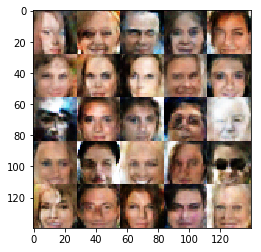

Epoch: 2/2 Discriminator Loss: 0.4835379123687744 Generator Loss: 2.5169808864593506
Epoch: 2/2 Discriminator Loss: 0.4734332263469696 Generator Loss: 1.875523567199707
Epoch: 2/2 Discriminator Loss: 0.6368282437324524 Generator Loss: 2.756007671356201
Epoch: 2/2 Discriminator Loss: 0.9213999509811401 Generator Loss: 4.031002521514893
Epoch: 2/2 Discriminator Loss: 0.6356412768363953 Generator Loss: 2.5107150077819824
Epoch: 2/2 Discriminator Loss: 1.3154726028442383 Generator Loss: 2.783879280090332
Epoch: 2/2 Discriminator Loss: 0.4193118214607239 Generator Loss: 2.5795280933380127
Epoch: 2/2 Discriminator Loss: 1.2985118627548218 Generator Loss: 3.663574457168579
Epoch: 2/2 Discriminator Loss: 0.560247540473938 Generator Loss: 2.17228627204895
Epoch: 2/2 Discriminator Loss: 0.7953854203224182 Generator Loss: 2.696564197540283


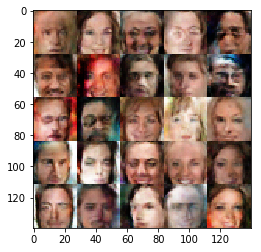

Epoch: 2/2 Discriminator Loss: 0.5108368992805481 Generator Loss: 2.294769048690796
Epoch: 2/2 Discriminator Loss: 0.7552363872528076 Generator Loss: 2.8130955696105957
Epoch: 2/2 Discriminator Loss: 0.5624750852584839 Generator Loss: 3.520132064819336
Epoch: 2/2 Discriminator Loss: 0.8521286249160767 Generator Loss: 4.604011535644531
Epoch: 2/2 Discriminator Loss: 0.8701266646385193 Generator Loss: 0.7300372123718262
Epoch: 2/2 Discriminator Loss: 0.5592669248580933 Generator Loss: 1.163433313369751
Epoch: 2/2 Discriminator Loss: 0.6867071986198425 Generator Loss: 2.361036777496338
Epoch: 2/2 Discriminator Loss: 0.7068297863006592 Generator Loss: 2.4281907081604004
Epoch: 2/2 Discriminator Loss: 0.9285320043563843 Generator Loss: 2.296966314315796
Epoch: 2/2 Discriminator Loss: 0.6890270113945007 Generator Loss: 3.2400014400482178


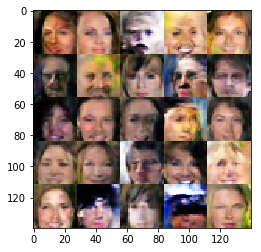

Epoch: 2/2 Discriminator Loss: 0.5326219797134399 Generator Loss: 1.7463526725769043
Epoch: 2/2 Discriminator Loss: 0.9055650234222412 Generator Loss: 1.564807415008545
Epoch: 2/2 Discriminator Loss: 0.6166892647743225 Generator Loss: 3.6942219734191895
Epoch: 2/2 Discriminator Loss: 1.2063711881637573 Generator Loss: 3.109685182571411
Epoch: 2/2 Discriminator Loss: 0.8629505634307861 Generator Loss: 0.8029457330703735
Epoch: 2/2 Discriminator Loss: 1.001875638961792 Generator Loss: 1.9869718551635742
Epoch: 2/2 Discriminator Loss: 0.7046744227409363 Generator Loss: 3.295900344848633
Epoch: 2/2 Discriminator Loss: 0.813026487827301 Generator Loss: 2.6206088066101074
Epoch: 2/2 Discriminator Loss: 0.7532779574394226 Generator Loss: 1.5539939403533936
Epoch: 2/2 Discriminator Loss: 0.8426096439361572 Generator Loss: 1.4829806089401245


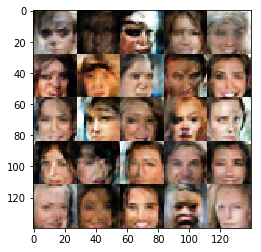

Epoch: 2/2 Discriminator Loss: 0.8745086193084717 Generator Loss: 3.2494888305664062
Epoch: 2/2 Discriminator Loss: 0.6257514357566833 Generator Loss: 1.8621002435684204
Epoch: 2/2 Discriminator Loss: 0.4612949788570404 Generator Loss: 2.153618812561035
Epoch: 2/2 Discriminator Loss: 0.8028725385665894 Generator Loss: 3.0141873359680176
Epoch: 2/2 Discriminator Loss: 0.8143590688705444 Generator Loss: 2.531867027282715
Epoch: 2/2 Discriminator Loss: 0.6551849842071533 Generator Loss: 1.1540168523788452
Epoch: 2/2 Discriminator Loss: 0.5024282336235046 Generator Loss: 1.8424060344696045
Epoch: 2/2 Discriminator Loss: 0.6110746264457703 Generator Loss: 4.081100940704346
Epoch: 2/2 Discriminator Loss: 0.5257688760757446 Generator Loss: 2.5553135871887207
Epoch: 2/2 Discriminator Loss: 0.4508233070373535 Generator Loss: 2.1478538513183594


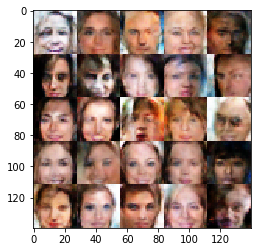

Epoch: 2/2 Discriminator Loss: 0.504051923751831 Generator Loss: 4.072779655456543
Epoch: 2/2 Discriminator Loss: 0.4475080668926239 Generator Loss: 2.2148332595825195
Epoch: 2/2 Discriminator Loss: 0.6465444564819336 Generator Loss: 4.041079044342041
Epoch: 2/2 Discriminator Loss: 0.7794047594070435 Generator Loss: 3.6722307205200195
Epoch: 2/2 Discriminator Loss: 0.5759469270706177 Generator Loss: 1.4434510469436646
Epoch: 2/2 Discriminator Loss: 0.6164078116416931 Generator Loss: 2.652705669403076
Epoch: 2/2 Discriminator Loss: 0.44151344895362854 Generator Loss: 3.08131742477417
Epoch: 2/2 Discriminator Loss: 0.6143842935562134 Generator Loss: 2.3695197105407715
Epoch: 2/2 Discriminator Loss: 0.3510211110115051 Generator Loss: 1.8781625032424927
Epoch: 2/2 Discriminator Loss: 0.8870055675506592 Generator Loss: 1.763256311416626


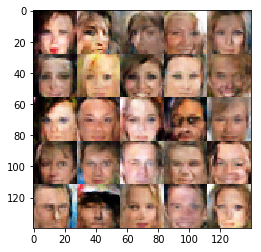

Epoch: 2/2 Discriminator Loss: 1.187312364578247 Generator Loss: 2.0010719299316406
Epoch: 2/2 Discriminator Loss: 0.5897607803344727 Generator Loss: 3.4101436138153076
Epoch: 2/2 Discriminator Loss: 0.5757542848587036 Generator Loss: 1.109029769897461
Epoch: 2/2 Discriminator Loss: 0.5084917545318604 Generator Loss: 2.468444585800171
Epoch: 2/2 Discriminator Loss: 0.800194263458252 Generator Loss: 3.1147360801696777
Epoch: 2/2 Discriminator Loss: 0.49867916107177734 Generator Loss: 1.4720420837402344
Epoch: 2/2 Discriminator Loss: 0.8244768977165222 Generator Loss: 3.0099501609802246
Epoch: 2/2 Discriminator Loss: 0.9014890193939209 Generator Loss: 3.7629356384277344
Epoch: 2/2 Discriminator Loss: 0.596397876739502 Generator Loss: 1.8221263885498047
Epoch: 2/2 Discriminator Loss: 0.6890371441841125 Generator Loss: 2.800846576690674


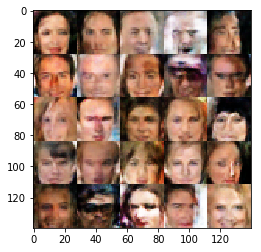

Epoch: 2/2 Discriminator Loss: 0.5846236348152161 Generator Loss: 2.77323579788208
Epoch: 2/2 Discriminator Loss: 0.5878024101257324 Generator Loss: 2.8482487201690674
Epoch: 2/2 Discriminator Loss: 0.5366808772087097 Generator Loss: 1.6482102870941162
Epoch: 2/2 Discriminator Loss: 1.2406370639801025 Generator Loss: 1.811888575553894
Epoch: 2/2 Discriminator Loss: 0.6212971210479736 Generator Loss: 1.2020480632781982
Epoch: 2/2 Discriminator Loss: 0.8614346981048584 Generator Loss: 0.7622188329696655
Epoch: 2/2 Discriminator Loss: 1.794539213180542 Generator Loss: 3.1940743923187256
Epoch: 2/2 Discriminator Loss: 1.0450220108032227 Generator Loss: 3.5557029247283936
Epoch: 2/2 Discriminator Loss: 0.43437761068344116 Generator Loss: 5.540146827697754
Epoch: 2/2 Discriminator Loss: 0.6108521223068237 Generator Loss: 4.415879249572754


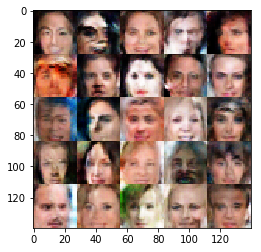

Epoch: 2/2 Discriminator Loss: 0.5940181016921997 Generator Loss: 2.694457530975342
Epoch: 2/2 Discriminator Loss: 0.6726868748664856 Generator Loss: 4.713940143585205
Epoch: 2/2 Discriminator Loss: 0.9710521101951599 Generator Loss: 1.7895150184631348
Epoch: 2/2 Discriminator Loss: 0.4971734285354614 Generator Loss: 1.9694242477416992
Epoch: 2/2 Discriminator Loss: 0.4434223771095276 Generator Loss: 3.234805107116699
Epoch: 2/2 Discriminator Loss: 0.8878275156021118 Generator Loss: 2.677328109741211
Epoch: 2/2 Discriminator Loss: 0.7356759309768677 Generator Loss: 1.757469892501831
Epoch: 2/2 Discriminator Loss: 0.5191184878349304 Generator Loss: 3.9728879928588867
Epoch: 2/2 Discriminator Loss: 0.5936061143875122 Generator Loss: 1.449297547340393
Epoch: 2/2 Discriminator Loss: 0.6583684682846069 Generator Loss: 1.3112447261810303


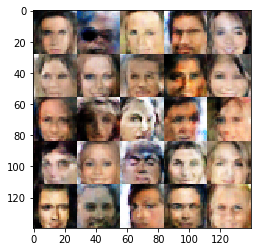

Epoch: 2/2 Discriminator Loss: 0.6137101650238037 Generator Loss: 1.4164257049560547
Epoch: 2/2 Discriminator Loss: 0.6690478324890137 Generator Loss: 3.111018657684326
Epoch: 2/2 Discriminator Loss: 0.595415472984314 Generator Loss: 1.0960094928741455
Epoch: 2/2 Discriminator Loss: 1.0037691593170166 Generator Loss: 3.514753818511963
Epoch: 2/2 Discriminator Loss: 0.600898802280426 Generator Loss: 3.117814064025879
Epoch: 2/2 Discriminator Loss: 0.6296011209487915 Generator Loss: 2.904025077819824
Epoch: 2/2 Discriminator Loss: 0.44556665420532227 Generator Loss: 3.8774030208587646
Epoch: 2/2 Discriminator Loss: 0.6034678816795349 Generator Loss: 2.80810546875
Epoch: 2/2 Discriminator Loss: 0.6001856327056885 Generator Loss: 1.576084852218628
Epoch: 2/2 Discriminator Loss: 1.7308672666549683 Generator Loss: 0.8437298536300659


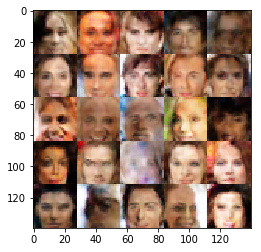

Epoch: 2/2 Discriminator Loss: 0.5150661468505859 Generator Loss: 3.244600534439087
Epoch: 2/2 Discriminator Loss: 0.6534294486045837 Generator Loss: 3.2650909423828125
Epoch: 2/2 Discriminator Loss: 0.49440649151802063 Generator Loss: 1.769710898399353
Epoch: 2/2 Discriminator Loss: 0.8201172351837158 Generator Loss: 2.4816431999206543
Epoch: 2/2 Discriminator Loss: 0.9809473156929016 Generator Loss: 1.0939133167266846
Epoch: 2/2 Discriminator Loss: 1.0151023864746094 Generator Loss: 0.9779857397079468
Epoch: 2/2 Discriminator Loss: 0.4557521343231201 Generator Loss: 2.4402260780334473
Epoch: 2/2 Discriminator Loss: 0.7779068350791931 Generator Loss: 1.4503272771835327
Epoch: 2/2 Discriminator Loss: 0.4819890856742859 Generator Loss: 2.5156188011169434
Epoch: 2/2 Discriminator Loss: 0.5123670697212219 Generator Loss: 2.440765857696533


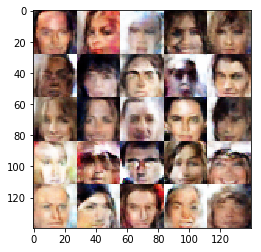

Epoch: 2/2 Discriminator Loss: 0.4120078384876251 Generator Loss: 2.5132827758789062
Epoch: 2/2 Discriminator Loss: 1.1026359796524048 Generator Loss: 1.385605812072754
Epoch: 2/2 Discriminator Loss: 1.0276087522506714 Generator Loss: 2.230388641357422
Epoch: 2/2 Discriminator Loss: 0.7460199594497681 Generator Loss: 3.357522487640381
Epoch: 2/2 Discriminator Loss: 0.5920553803443909 Generator Loss: 3.1471810340881348
Epoch: 2/2 Discriminator Loss: 0.712104082107544 Generator Loss: 1.7765437364578247
Epoch: 2/2 Discriminator Loss: 0.39478424191474915 Generator Loss: 4.0054612159729
Epoch: 2/2 Discriminator Loss: 0.46888312697410583 Generator Loss: 2.927175521850586
Epoch: 2/2 Discriminator Loss: 0.618768036365509 Generator Loss: 4.931397914886475
Epoch: 2/2 Discriminator Loss: 0.952431321144104 Generator Loss: 4.29326057434082


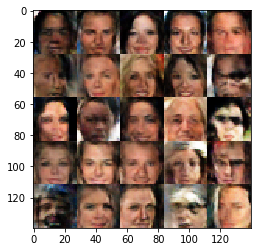

Epoch: 2/2 Discriminator Loss: 0.5054476857185364 Generator Loss: 2.3143064975738525
Epoch: 2/2 Discriminator Loss: 0.5644735097885132 Generator Loss: 2.0938379764556885
Epoch: 2/2 Discriminator Loss: 0.6435679197311401 Generator Loss: 2.7528176307678223
Epoch: 2/2 Discriminator Loss: 0.759403645992279 Generator Loss: 1.4807603359222412
Epoch: 2/2 Discriminator Loss: 0.7447051405906677 Generator Loss: 2.485508918762207
Epoch: 2/2 Discriminator Loss: 0.5688666701316833 Generator Loss: 3.5821022987365723
Epoch: 2/2 Discriminator Loss: 0.7715270519256592 Generator Loss: 2.6376395225524902
Epoch: 2/2 Discriminator Loss: 0.67159104347229 Generator Loss: 4.362607002258301
Epoch: 2/2 Discriminator Loss: 1.4678558111190796 Generator Loss: 1.1281068325042725
Epoch: 2/2 Discriminator Loss: 0.6527113914489746 Generator Loss: 3.5706100463867188


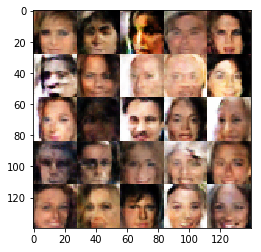

Epoch: 2/2 Discriminator Loss: 0.8930038213729858 Generator Loss: 2.627711772918701
Epoch: 2/2 Discriminator Loss: 0.6669700145721436 Generator Loss: 2.209383726119995
Epoch: 2/2 Discriminator Loss: 1.1338675022125244 Generator Loss: 1.023722767829895
Epoch: 2/2 Discriminator Loss: 1.0601314306259155 Generator Loss: 1.2581329345703125
Epoch: 2/2 Discriminator Loss: 0.6775538921356201 Generator Loss: 1.569136381149292
Epoch: 2/2 Discriminator Loss: 0.7818581461906433 Generator Loss: 0.8044519424438477
Epoch: 2/2 Discriminator Loss: 1.0271602869033813 Generator Loss: 3.5850701332092285
Epoch: 2/2 Discriminator Loss: 0.5661433339118958 Generator Loss: 1.5889952182769775
Epoch: 2/2 Discriminator Loss: 0.5530927181243896 Generator Loss: 4.288761615753174
Epoch: 2/2 Discriminator Loss: 1.0572785139083862 Generator Loss: 2.295720100402832


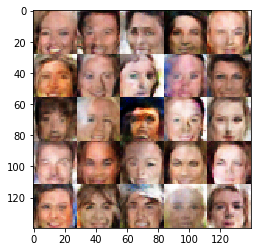

Epoch: 2/2 Discriminator Loss: 0.7531118392944336 Generator Loss: 3.877786636352539
Epoch: 2/2 Discriminator Loss: 0.9414427280426025 Generator Loss: 3.1063780784606934
Epoch: 2/2 Discriminator Loss: 0.9019762277603149 Generator Loss: 1.7397265434265137
Epoch: 2/2 Discriminator Loss: 1.2130346298217773 Generator Loss: 1.2112786769866943
Epoch: 2/2 Discriminator Loss: 0.44798094034194946 Generator Loss: 2.3338680267333984
Epoch: 2/2 Discriminator Loss: 0.6223570108413696 Generator Loss: 1.8463023900985718
Epoch: 2/2 Discriminator Loss: 0.908535361289978 Generator Loss: 2.6950206756591797
Epoch: 2/2 Discriminator Loss: 0.5383912920951843 Generator Loss: 3.062044143676758
Epoch: 2/2 Discriminator Loss: 0.7311409711837769 Generator Loss: 3.726677179336548
Epoch: 2/2 Discriminator Loss: 0.7309967279434204 Generator Loss: 1.5643243789672852


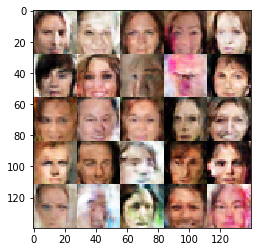

Epoch: 2/2 Discriminator Loss: 0.4384888708591461 Generator Loss: 4.639317512512207
Epoch: 2/2 Discriminator Loss: 0.7953857183456421 Generator Loss: 2.4484152793884277
Epoch: 2/2 Discriminator Loss: 0.6849786043167114 Generator Loss: 2.967848777770996
Epoch: 2/2 Discriminator Loss: 0.7427217960357666 Generator Loss: 4.6418890953063965
Epoch: 2/2 Discriminator Loss: 1.195273756980896 Generator Loss: 2.1021196842193604
Epoch: 2/2 Discriminator Loss: 0.7063243389129639 Generator Loss: 1.8299946784973145
Epoch: 2/2 Discriminator Loss: 0.8906545639038086 Generator Loss: 0.8329607248306274
Epoch: 2/2 Discriminator Loss: 0.6281007528305054 Generator Loss: 2.280576705932617
Epoch: 2/2 Discriminator Loss: 0.5696908235549927 Generator Loss: 3.733405351638794
Epoch: 2/2 Discriminator Loss: 0.5059794187545776 Generator Loss: 3.1786866188049316


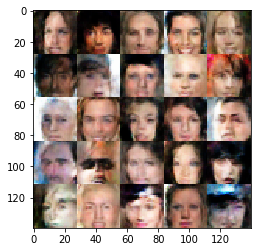

Epoch: 2/2 Discriminator Loss: 0.5265275239944458 Generator Loss: 1.8995366096496582
Epoch: 2/2 Discriminator Loss: 0.6657555103302002 Generator Loss: 1.3428759574890137
Epoch: 2/2 Discriminator Loss: 1.1077995300292969 Generator Loss: 3.3795223236083984
Epoch: 2/2 Discriminator Loss: 1.0634894371032715 Generator Loss: 3.385913133621216
Epoch: 2/2 Discriminator Loss: 0.6296979784965515 Generator Loss: 0.9870722889900208
Epoch: 2/2 Discriminator Loss: 0.5556451678276062 Generator Loss: 2.4418444633483887
Epoch: 2/2 Discriminator Loss: 0.5986025333404541 Generator Loss: 2.5087194442749023
Epoch: 2/2 Discriminator Loss: 0.5093039274215698 Generator Loss: 2.039689302444458
Epoch: 2/2 Discriminator Loss: 1.2966526746749878 Generator Loss: 0.8779144883155823
Epoch: 2/2 Discriminator Loss: 1.0352563858032227 Generator Loss: 1.8354778289794922


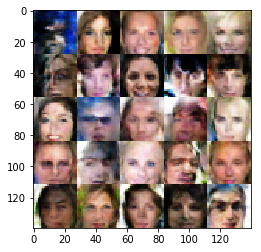

Epoch: 2/2 Discriminator Loss: 0.40262696146965027 Generator Loss: 3.8139443397521973
Epoch: 2/2 Discriminator Loss: 0.4760062098503113 Generator Loss: 3.658210277557373
Epoch: 2/2 Discriminator Loss: 0.5124327540397644 Generator Loss: 2.6730833053588867
Epoch: 2/2 Discriminator Loss: 0.4623023271560669 Generator Loss: 4.789582252502441
Epoch: 2/2 Discriminator Loss: 0.7461308240890503 Generator Loss: 1.9671554565429688
Epoch: 2/2 Discriminator Loss: 1.112797498703003 Generator Loss: 2.0307114124298096
Epoch: 2/2 Discriminator Loss: 1.075400948524475 Generator Loss: 3.2559800148010254
Epoch: 2/2 Discriminator Loss: 0.4254399538040161 Generator Loss: 3.0301170349121094
Epoch: 2/2 Discriminator Loss: 0.6710415482521057 Generator Loss: 3.3460116386413574
Epoch: 2/2 Discriminator Loss: 0.666964054107666 Generator Loss: 2.654940128326416


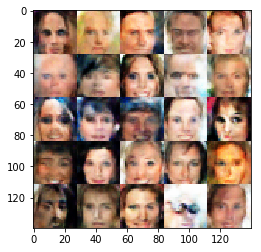

Epoch: 2/2 Discriminator Loss: 0.7342262864112854 Generator Loss: 1.6452240943908691
Epoch: 2/2 Discriminator Loss: 1.0233373641967773 Generator Loss: 3.6127769947052
Epoch: 2/2 Discriminator Loss: 0.5653733611106873 Generator Loss: 2.4435956478118896
Epoch: 2/2 Discriminator Loss: 0.5472294092178345 Generator Loss: 2.6467018127441406
Epoch: 2/2 Discriminator Loss: 0.5837353467941284 Generator Loss: 1.5335031747817993
Epoch: 2/2 Discriminator Loss: 0.6533202528953552 Generator Loss: 3.5758261680603027
Epoch: 2/2 Discriminator Loss: 1.0800448656082153 Generator Loss: 2.1515791416168213
Epoch: 2/2 Discriminator Loss: 0.6547979712486267 Generator Loss: 3.7916364669799805
Epoch: 2/2 Discriminator Loss: 0.949361264705658 Generator Loss: 1.2347458600997925
Epoch: 2/2 Discriminator Loss: 0.6781706809997559 Generator Loss: 1.9120581150054932


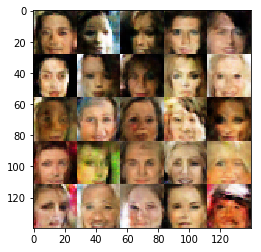

Epoch: 2/2 Discriminator Loss: 0.7516645193099976 Generator Loss: 1.6083781719207764
Epoch: 2/2 Discriminator Loss: 0.5140762329101562 Generator Loss: 3.4729084968566895
Epoch: 2/2 Discriminator Loss: 0.7622330188751221 Generator Loss: 2.245422124862671
Epoch: 2/2 Discriminator Loss: 0.5839753746986389 Generator Loss: 2.5270609855651855
Epoch: 2/2 Discriminator Loss: 0.7199643850326538 Generator Loss: 1.4803365468978882
Epoch: 2/2 Discriminator Loss: 0.7978842258453369 Generator Loss: 2.3397812843322754
Epoch: 2/2 Discriminator Loss: 0.47762125730514526 Generator Loss: 2.588433265686035
Epoch: 2/2 Discriminator Loss: 0.6156418919563293 Generator Loss: 1.5950102806091309
Epoch: 2/2 Discriminator Loss: 0.6726232767105103 Generator Loss: 2.275386333465576
Epoch: 2/2 Discriminator Loss: 0.507262647151947 Generator Loss: 2.7192697525024414


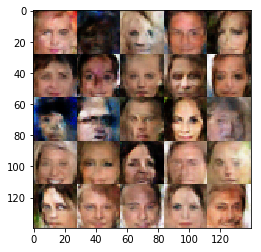

Epoch: 2/2 Discriminator Loss: 1.2809691429138184 Generator Loss: 1.7849938869476318
Epoch: 2/2 Discriminator Loss: 0.717620849609375 Generator Loss: 1.832221508026123
Epoch: 2/2 Discriminator Loss: 0.8800424337387085 Generator Loss: 2.217811107635498
Epoch: 2/2 Discriminator Loss: 0.5816185474395752 Generator Loss: 2.6220719814300537
Epoch: 2/2 Discriminator Loss: 0.7041714787483215 Generator Loss: 2.494168996810913
Epoch: 2/2 Discriminator Loss: 0.8698651790618896 Generator Loss: 2.1193060874938965
Epoch: 2/2 Discriminator Loss: 0.861965537071228 Generator Loss: 2.759458541870117
Epoch: 2/2 Discriminator Loss: 0.4788704514503479 Generator Loss: 1.2246216535568237
Epoch: 2/2 Discriminator Loss: 0.5838018655776978 Generator Loss: 3.686532974243164
Epoch: 2/2 Discriminator Loss: 0.9868830442428589 Generator Loss: 1.0636473894119263


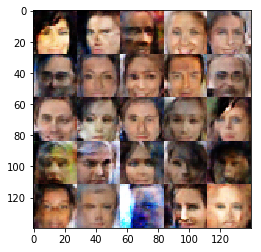

Epoch: 2/2 Discriminator Loss: 1.0445829629898071 Generator Loss: 1.4770023822784424
Epoch: 2/2 Discriminator Loss: 0.9486780762672424 Generator Loss: 1.24767005443573
Epoch: 2/2 Discriminator Loss: 0.43198227882385254 Generator Loss: 2.516679286956787
Epoch: 2/2 Discriminator Loss: 0.5181353092193604 Generator Loss: 3.06687068939209
Epoch: 2/2 Discriminator Loss: 0.6563340425491333 Generator Loss: 1.9839775562286377
Epoch: 2/2 Discriminator Loss: 0.6258700489997864 Generator Loss: 1.2740602493286133
Epoch: 2/2 Discriminator Loss: 0.43643590807914734 Generator Loss: 1.6434440612792969
Epoch: 2/2 Discriminator Loss: 0.4683201014995575 Generator Loss: 4.992027282714844
Epoch: 2/2 Discriminator Loss: 0.693264365196228 Generator Loss: 3.1890745162963867
Epoch: 2/2 Discriminator Loss: 0.5018826127052307 Generator Loss: 4.091028213500977


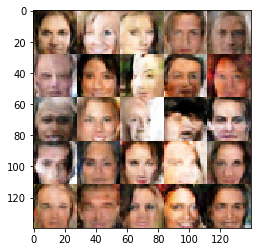

Epoch: 2/2 Discriminator Loss: 0.726749837398529 Generator Loss: 1.9680500030517578
Epoch: 2/2 Discriminator Loss: 0.6011260151863098 Generator Loss: 1.7882486581802368
Epoch: 2/2 Discriminator Loss: 0.8385093212127686 Generator Loss: 4.25624942779541
Epoch: 2/2 Discriminator Loss: 0.5150190591812134 Generator Loss: 2.00872802734375
Epoch: 2/2 Discriminator Loss: 0.4910658001899719 Generator Loss: 2.6994457244873047
Epoch: 2/2 Discriminator Loss: 0.8223059773445129 Generator Loss: 3.4170846939086914
Epoch: 2/2 Discriminator Loss: 0.43547698855400085 Generator Loss: 4.005170822143555
Epoch: 2/2 Discriminator Loss: 0.5212923884391785 Generator Loss: 3.065476179122925
Epoch: 2/2 Discriminator Loss: 1.588576316833496 Generator Loss: 3.9890966415405273
Epoch: 2/2 Discriminator Loss: 0.4090791940689087 Generator Loss: 4.465242385864258


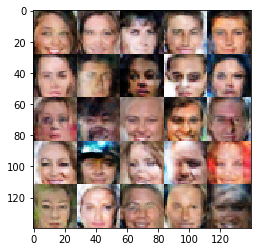

Epoch: 2/2 Discriminator Loss: 0.5346506834030151 Generator Loss: 1.7675590515136719
Epoch: 2/2 Discriminator Loss: 0.9969646334648132 Generator Loss: 1.04671049118042
Epoch: 2/2 Discriminator Loss: 0.47899994254112244 Generator Loss: 2.5470242500305176
Epoch: 2/2 Discriminator Loss: 0.5793869495391846 Generator Loss: 1.9000200033187866
Epoch: 2/2 Discriminator Loss: 0.9830788373947144 Generator Loss: 1.8767998218536377
Epoch: 2/2 Discriminator Loss: 0.7374135255813599 Generator Loss: 2.881087303161621
Epoch: 2/2 Discriminator Loss: 0.8411895632743835 Generator Loss: 2.8593192100524902
Epoch: 2/2 Discriminator Loss: 0.7871150970458984 Generator Loss: 1.3446779251098633
Epoch: 2/2 Discriminator Loss: 0.43306905031204224 Generator Loss: 1.8598253726959229
Epoch: 2/2 Discriminator Loss: 0.43882596492767334 Generator Loss: 4.750372886657715


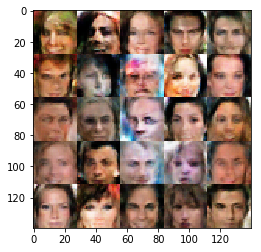

Epoch: 2/2 Discriminator Loss: 0.4783782958984375 Generator Loss: 3.212784767150879
Epoch: 2/2 Discriminator Loss: 1.1743206977844238 Generator Loss: 0.9342502951622009
Epoch: 2/2 Discriminator Loss: 1.1975542306900024 Generator Loss: 1.7318410873413086
Epoch: 2/2 Discriminator Loss: 0.9689633846282959 Generator Loss: 1.111322283744812
Epoch: 2/2 Discriminator Loss: 0.5499095916748047 Generator Loss: 1.9180344343185425
Epoch: 2/2 Discriminator Loss: 1.0017263889312744 Generator Loss: 1.4898433685302734
Epoch: 2/2 Discriminator Loss: 0.45970162749290466 Generator Loss: 4.857195854187012
Epoch: 2/2 Discriminator Loss: 0.3986734449863434 Generator Loss: 4.0024309158325195
Epoch: 2/2 Discriminator Loss: 0.47405004501342773 Generator Loss: 3.1685099601745605
Epoch: 2/2 Discriminator Loss: 0.5620447397232056 Generator Loss: 2.3281264305114746


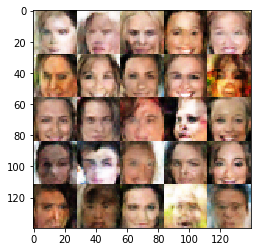

Epoch: 2/2 Discriminator Loss: 0.8366566300392151 Generator Loss: 3.820333242416382
Epoch: 2/2 Discriminator Loss: 0.617763876914978 Generator Loss: 1.8390026092529297
Epoch: 2/2 Discriminator Loss: 0.9357523918151855 Generator Loss: 3.2811224460601807
Epoch: 2/2 Discriminator Loss: 0.53801429271698 Generator Loss: 2.3144338130950928
Epoch: 2/2 Discriminator Loss: 1.4447885751724243 Generator Loss: 1.48463773727417
Epoch: 2/2 Discriminator Loss: 0.6684908866882324 Generator Loss: 2.8596506118774414
Epoch: 2/2 Discriminator Loss: 0.6732834577560425 Generator Loss: 3.606081485748291
Epoch: 2/2 Discriminator Loss: 0.8024182319641113 Generator Loss: 2.550994873046875
Epoch: 2/2 Discriminator Loss: 0.5283164978027344 Generator Loss: 2.8613743782043457
Epoch: 2/2 Discriminator Loss: 1.4842809438705444 Generator Loss: 1.6061394214630127


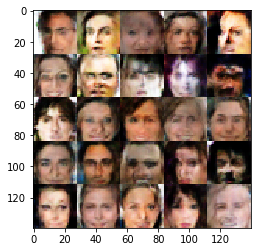

Epoch: 2/2 Discriminator Loss: 1.1015745401382446 Generator Loss: 3.139812469482422
Epoch: 2/2 Discriminator Loss: 0.49801933765411377 Generator Loss: 2.6810390949249268
Epoch: 2/2 Discriminator Loss: 0.63346266746521 Generator Loss: 4.608762264251709
Epoch: 2/2 Discriminator Loss: 1.0594288110733032 Generator Loss: 2.494715929031372
Epoch: 2/2 Discriminator Loss: 0.7069317102432251 Generator Loss: 2.716981887817383
Epoch: 2/2 Discriminator Loss: 0.5747397541999817 Generator Loss: 2.0275354385375977
Epoch: 2/2 Discriminator Loss: 0.7490327954292297 Generator Loss: 1.4699480533599854
Epoch: 2/2 Discriminator Loss: 0.6703835129737854 Generator Loss: 2.8244380950927734
Epoch: 2/2 Discriminator Loss: 0.9147233963012695 Generator Loss: 1.9716156721115112
Epoch: 2/2 Discriminator Loss: 0.5511879324913025 Generator Loss: 2.893272876739502


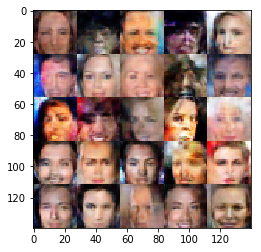

Epoch: 2/2 Discriminator Loss: 0.9238120317459106 Generator Loss: 2.9401731491088867
Epoch: 2/2 Discriminator Loss: 0.4907526969909668 Generator Loss: 1.6827336549758911
Epoch: 2/2 Discriminator Loss: 1.1708776950836182 Generator Loss: 2.312710762023926
Epoch: 2/2 Discriminator Loss: 0.5475894808769226 Generator Loss: 3.2078890800476074
Epoch: 2/2 Discriminator Loss: 0.48809996247291565 Generator Loss: 1.2906461954116821
Epoch: 2/2 Discriminator Loss: 1.0998616218566895 Generator Loss: 1.3055667877197266
Epoch: 2/2 Discriminator Loss: 0.5907554626464844 Generator Loss: 3.1808931827545166
Epoch: 2/2 Discriminator Loss: 0.5397552847862244 Generator Loss: 2.773383140563965
Epoch: 2/2 Discriminator Loss: 0.8021913766860962 Generator Loss: 1.8129688501358032
Epoch: 2/2 Discriminator Loss: 0.7338014245033264 Generator Loss: 3.3080453872680664


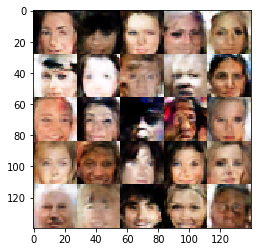

Epoch: 2/2 Discriminator Loss: 0.5706446170806885 Generator Loss: 2.1519882678985596
Epoch: 2/2 Discriminator Loss: 0.7252668142318726 Generator Loss: 0.6094512939453125
Epoch: 2/2 Discriminator Loss: 0.7730413675308228 Generator Loss: 3.5818772315979004
Epoch: 2/2 Discriminator Loss: 0.7408668994903564 Generator Loss: 2.4439139366149902
Epoch: 2/2 Discriminator Loss: 0.6499239206314087 Generator Loss: 2.0894484519958496
Epoch: 2/2 Discriminator Loss: 0.5484508275985718 Generator Loss: 2.5084238052368164
Epoch: 2/2 Discriminator Loss: 1.005217432975769 Generator Loss: 2.9926304817199707
Epoch: 2/2 Discriminator Loss: 0.7126749753952026 Generator Loss: 3.9183664321899414
Epoch: 2/2 Discriminator Loss: 0.4413953423500061 Generator Loss: 3.1441972255706787
Epoch: 2/2 Discriminator Loss: 0.5424903035163879 Generator Loss: 1.4674758911132812


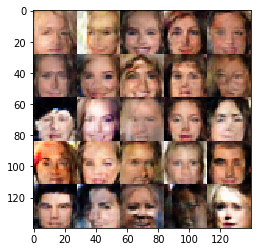

Epoch: 2/2 Discriminator Loss: 0.9968472719192505 Generator Loss: 1.7341434955596924
Epoch: 2/2 Discriminator Loss: 0.8775211572647095 Generator Loss: 3.3304686546325684
Epoch: 2/2 Discriminator Loss: 1.2476834058761597 Generator Loss: 0.8836410641670227
Epoch: 2/2 Discriminator Loss: 0.48792949318885803 Generator Loss: 3.401259422302246
Epoch: 2/2 Discriminator Loss: 0.4112135171890259 Generator Loss: 2.7575292587280273
Epoch: 2/2 Discriminator Loss: 0.6167606711387634 Generator Loss: 3.212956428527832
Epoch: 2/2 Discriminator Loss: 1.378206729888916 Generator Loss: 2.565463066101074
Epoch: 2/2 Discriminator Loss: 0.7046455144882202 Generator Loss: 1.4374977350234985
Epoch: 2/2 Discriminator Loss: 0.6785324811935425 Generator Loss: 2.111548900604248
Epoch: 2/2 Discriminator Loss: 1.6659469604492188 Generator Loss: 1.175635814666748


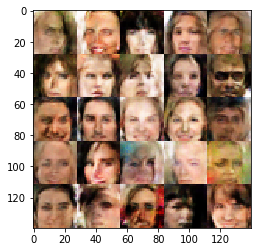

Epoch: 2/2 Discriminator Loss: 0.7153395414352417 Generator Loss: 2.162714958190918
Epoch: 2/2 Discriminator Loss: 0.6950264573097229 Generator Loss: 3.110992431640625
Epoch: 2/2 Discriminator Loss: 0.489899218082428 Generator Loss: 2.1226096153259277
Epoch: 2/2 Discriminator Loss: 0.6455811858177185 Generator Loss: 3.0100555419921875
Epoch: 2/2 Discriminator Loss: 0.4231288433074951 Generator Loss: 2.211895704269409
Epoch: 2/2 Discriminator Loss: 0.5074418783187866 Generator Loss: 3.573603868484497
Epoch: 2/2 Discriminator Loss: 0.6991342902183533 Generator Loss: 3.2372913360595703
Epoch: 2/2 Discriminator Loss: 0.8572174310684204 Generator Loss: 2.9105992317199707
Epoch: 2/2 Discriminator Loss: 0.5100672245025635 Generator Loss: 3.361429214477539
Epoch: 2/2 Discriminator Loss: 0.6294357180595398 Generator Loss: 0.7362054586410522


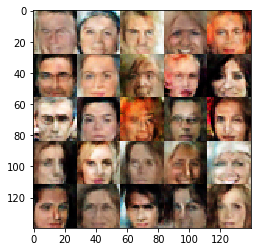

Epoch: 2/2 Discriminator Loss: 0.653786838054657 Generator Loss: 3.8542962074279785
Epoch: 2/2 Discriminator Loss: 0.47804850339889526 Generator Loss: 2.4626550674438477
Epoch: 2/2 Discriminator Loss: 0.7512487173080444 Generator Loss: 2.391606330871582
Epoch: 2/2 Discriminator Loss: 0.7583193778991699 Generator Loss: 1.6224467754364014
Epoch: 2/2 Discriminator Loss: 0.6571840047836304 Generator Loss: 3.0603840351104736
Epoch: 2/2 Discriminator Loss: 0.8102796673774719 Generator Loss: 2.303521156311035
Epoch: 2/2 Discriminator Loss: 0.8071469068527222 Generator Loss: 3.9232378005981445
Epoch: 2/2 Discriminator Loss: 0.5578349232673645 Generator Loss: 2.345123767852783
Epoch: 2/2 Discriminator Loss: 0.8538793325424194 Generator Loss: 1.2064063549041748
Epoch: 2/2 Discriminator Loss: 0.9573017954826355 Generator Loss: 4.2694091796875


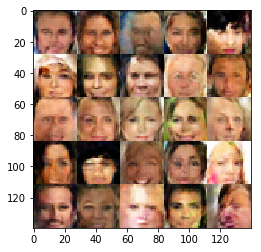

Epoch: 2/2 Discriminator Loss: 1.143836498260498 Generator Loss: 1.5170552730560303
Epoch: 2/2 Discriminator Loss: 1.0620512962341309 Generator Loss: 1.1565693616867065
Epoch: 2/2 Discriminator Loss: 0.4454464018344879 Generator Loss: 3.1319055557250977
Epoch: 2/2 Discriminator Loss: 0.7459091544151306 Generator Loss: 2.0167946815490723
Epoch: 2/2 Discriminator Loss: 0.5993262529373169 Generator Loss: 2.286623477935791
Epoch: 2/2 Discriminator Loss: 0.91363924741745 Generator Loss: 1.2213804721832275
Epoch: 2/2 Discriminator Loss: 0.8316519260406494 Generator Loss: 3.304004669189453
Epoch: 2/2 Discriminator Loss: 0.8504270315170288 Generator Loss: 2.807462692260742
Epoch: 2/2 Discriminator Loss: 0.7092970609664917 Generator Loss: 2.1725189685821533
Epoch: 2/2 Discriminator Loss: 0.47066694498062134 Generator Loss: 3.465439796447754


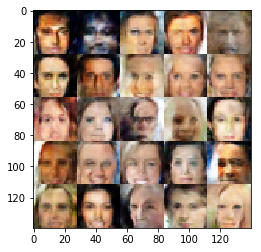

Epoch: 2/2 Discriminator Loss: 0.5912755131721497 Generator Loss: 3.5789718627929688
Epoch: 2/2 Discriminator Loss: 1.0828490257263184 Generator Loss: 1.9457306861877441
Epoch: 2/2 Discriminator Loss: 0.47234517335891724 Generator Loss: 3.746857166290283
Epoch: 2/2 Discriminator Loss: 0.42253243923187256 Generator Loss: 3.313750743865967
Epoch: 2/2 Discriminator Loss: 0.873880922794342 Generator Loss: 2.55180287361145
Epoch: 2/2 Discriminator Loss: 0.7579207420349121 Generator Loss: 1.9644041061401367
Epoch: 2/2 Discriminator Loss: 0.5562248229980469 Generator Loss: 1.2121610641479492
Epoch: 2/2 Discriminator Loss: 0.45911943912506104 Generator Loss: 4.666965484619141
Epoch: 2/2 Discriminator Loss: 0.4636602997779846 Generator Loss: 2.8037753105163574
Epoch: 2/2 Discriminator Loss: 0.4918256998062134 Generator Loss: 3.211287021636963


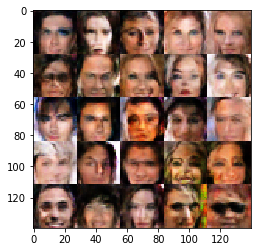

Epoch: 2/2 Discriminator Loss: 0.48564156889915466 Generator Loss: 2.094205856323242
Epoch: 2/2 Discriminator Loss: 0.7278532981872559 Generator Loss: 2.8024709224700928
Epoch: 2/2 Discriminator Loss: 0.7063993811607361 Generator Loss: 4.32819938659668
Epoch: 2/2 Discriminator Loss: 0.47593382000923157 Generator Loss: 1.8097504377365112
Epoch: 2/2 Discriminator Loss: 1.3890604972839355 Generator Loss: 0.6923859119415283
Epoch: 2/2 Discriminator Loss: 0.7309273481369019 Generator Loss: 0.5149508714675903
Epoch: 2/2 Discriminator Loss: 0.7669358253479004 Generator Loss: 2.2527689933776855
Epoch: 2/2 Discriminator Loss: 0.5190531611442566 Generator Loss: 3.308013439178467
Epoch: 2/2 Discriminator Loss: 0.6838919520378113 Generator Loss: 2.3231656551361084
Epoch: 2/2 Discriminator Loss: 0.45185917615890503 Generator Loss: 3.099675178527832


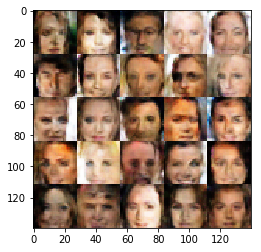

Epoch: 2/2 Discriminator Loss: 0.6777070164680481 Generator Loss: 2.934138774871826
Epoch: 2/2 Discriminator Loss: 0.7549146413803101 Generator Loss: 2.654763698577881
Epoch: 2/2 Discriminator Loss: 0.7816853523254395 Generator Loss: 4.204799175262451
Epoch: 2/2 Discriminator Loss: 0.8984553813934326 Generator Loss: 3.799670696258545
Epoch: 2/2 Discriminator Loss: 0.7670319080352783 Generator Loss: 0.9088568091392517
Epoch: 2/2 Discriminator Loss: 0.5367995500564575 Generator Loss: 2.2502384185791016
Epoch: 2/2 Discriminator Loss: 1.0035064220428467 Generator Loss: 2.0276131629943848
Epoch: 2/2 Discriminator Loss: 0.44784194231033325 Generator Loss: 3.5045533180236816
Epoch: 2/2 Discriminator Loss: 0.6346690058708191 Generator Loss: 2.2491374015808105
Epoch: 2/2 Discriminator Loss: 0.44629502296447754 Generator Loss: 3.8609585762023926


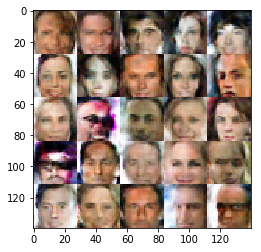

Epoch: 2/2 Discriminator Loss: 0.5000931024551392 Generator Loss: 2.2098922729492188
Epoch: 2/2 Discriminator Loss: 0.5167856216430664 Generator Loss: 1.2508269548416138
Epoch: 2/2 Discriminator Loss: 0.9177065491676331 Generator Loss: 1.683812141418457
Epoch: 2/2 Discriminator Loss: 0.5348795056343079 Generator Loss: 2.549376964569092
Epoch: 2/2 Discriminator Loss: 0.4101142883300781 Generator Loss: 2.9154820442199707
Epoch: 2/2 Discriminator Loss: 1.0027744770050049 Generator Loss: 3.116478443145752
Epoch: 2/2 Discriminator Loss: 0.5311471223831177 Generator Loss: 1.384528398513794
Epoch: 2/2 Discriminator Loss: 0.6909367442131042 Generator Loss: 3.174258232116699
Epoch: 2/2 Discriminator Loss: 0.4825369715690613 Generator Loss: 3.3110101222991943
Epoch: 2/2 Discriminator Loss: 0.7622674703598022 Generator Loss: 3.4974050521850586


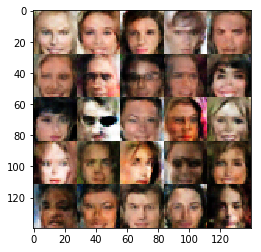

Epoch: 2/2 Discriminator Loss: 0.6667871475219727 Generator Loss: 0.9198731780052185
Epoch: 2/2 Discriminator Loss: 0.5373164415359497 Generator Loss: 2.2425804138183594
Epoch: 2/2 Discriminator Loss: 0.42308345437049866 Generator Loss: 3.4938323497772217
Epoch: 2/2 Discriminator Loss: 1.2628633975982666 Generator Loss: 0.9629494547843933
Epoch: 2/2 Discriminator Loss: 1.2157998085021973 Generator Loss: 0.7681333422660828
Epoch: 2/2 Discriminator Loss: 0.6070013046264648 Generator Loss: 3.302428960800171
Epoch: 2/2 Discriminator Loss: 0.8137202262878418 Generator Loss: 1.5354264974594116
Epoch: 2/2 Discriminator Loss: 0.6824232339859009 Generator Loss: 2.4728410243988037
Epoch: 2/2 Discriminator Loss: 0.45442143082618713 Generator Loss: 3.9674391746520996
Epoch: 2/2 Discriminator Loss: 0.5162110924720764 Generator Loss: 2.4506053924560547


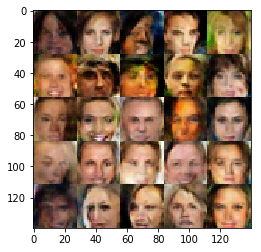

Epoch: 2/2 Discriminator Loss: 0.9553860425949097 Generator Loss: 2.7778990268707275
Epoch: 2/2 Discriminator Loss: 0.5726364850997925 Generator Loss: 2.1601672172546387
Epoch: 2/2 Discriminator Loss: 0.571152925491333 Generator Loss: 2.4537513256073
Epoch: 2/2 Discriminator Loss: 0.5937404632568359 Generator Loss: 2.1603951454162598
Epoch: 2/2 Discriminator Loss: 0.6504212617874146 Generator Loss: 4.177135467529297
Epoch: 2/2 Discriminator Loss: 0.7026413679122925 Generator Loss: 3.038750171661377
Epoch: 2/2 Discriminator Loss: 0.45741719007492065 Generator Loss: 3.6095471382141113
Epoch: 2/2 Discriminator Loss: 0.3951331079006195 Generator Loss: 2.760221004486084
Epoch: 2/2 Discriminator Loss: 0.6995282769203186 Generator Loss: 1.6651908159255981
Epoch: 2/2 Discriminator Loss: 0.45437395572662354 Generator Loss: 1.6909689903259277


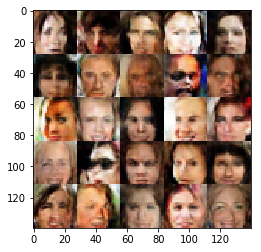

Epoch: 2/2 Discriminator Loss: 0.8593995571136475 Generator Loss: 1.7099480628967285
Epoch: 2/2 Discriminator Loss: 0.49923276901245117 Generator Loss: 3.224625825881958
Epoch: 2/2 Discriminator Loss: 0.6294991970062256 Generator Loss: 2.327350616455078
Epoch: 2/2 Discriminator Loss: 0.7686133980751038 Generator Loss: 2.889136552810669
Epoch: 2/2 Discriminator Loss: 0.8421035408973694 Generator Loss: 4.797940254211426
Epoch: 2/2 Discriminator Loss: 0.575148344039917 Generator Loss: 2.9987528324127197
Epoch: 2/2 Discriminator Loss: 0.6804417371749878 Generator Loss: 1.9812209606170654
Epoch: 2/2 Discriminator Loss: 0.8546953201293945 Generator Loss: 2.8094918727874756
Epoch: 2/2 Discriminator Loss: 0.9533692598342896 Generator Loss: 2.4328227043151855
Epoch: 2/2 Discriminator Loss: 0.7166141271591187 Generator Loss: 3.7724552154541016


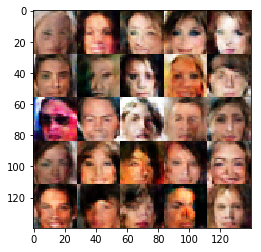

Epoch: 2/2 Discriminator Loss: 0.8853049278259277 Generator Loss: 4.01153039932251
Epoch: 2/2 Discriminator Loss: 0.4395716190338135 Generator Loss: 3.1774611473083496
Epoch: 2/2 Discriminator Loss: 0.5841542482376099 Generator Loss: 2.122218132019043
Epoch: 2/2 Discriminator Loss: 0.7140246033668518 Generator Loss: 2.426626205444336
Epoch: 2/2 Discriminator Loss: 0.5797391533851624 Generator Loss: 3.372337818145752
Epoch: 2/2 Discriminator Loss: 0.8119904398918152 Generator Loss: 4.129138946533203
Epoch: 2/2 Discriminator Loss: 0.8803358674049377 Generator Loss: 3.4134788513183594
Epoch: 2/2 Discriminator Loss: 0.5580143928527832 Generator Loss: 3.133431911468506
Epoch: 2/2 Discriminator Loss: 0.43855515122413635 Generator Loss: 2.706815481185913
Epoch: 2/2 Discriminator Loss: 0.39419659972190857 Generator Loss: 2.709146499633789


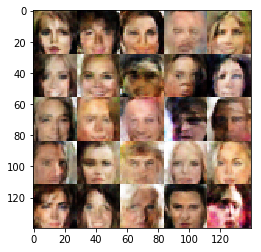

Epoch: 2/2 Discriminator Loss: 0.7655121088027954 Generator Loss: 2.0068249702453613
Epoch: 2/2 Discriminator Loss: 0.6941646337509155 Generator Loss: 3.7656607627868652
Epoch: 2/2 Discriminator Loss: 0.8253381848335266 Generator Loss: 2.692080497741699
Epoch: 2/2 Discriminator Loss: 0.5353443622589111 Generator Loss: 2.2683351039886475
Epoch: 2/2 Discriminator Loss: 0.5073707103729248 Generator Loss: 3.2105133533477783
Epoch: 2/2 Discriminator Loss: 0.5786696672439575 Generator Loss: 2.5156235694885254
Epoch: 2/2 Discriminator Loss: 0.6799893975257874 Generator Loss: 3.0455925464630127
Epoch: 2/2 Discriminator Loss: 0.6869577765464783 Generator Loss: 2.6957039833068848
Epoch: 2/2 Discriminator Loss: 0.6677773594856262 Generator Loss: 1.5311815738677979
Epoch: 2/2 Discriminator Loss: 0.9008464813232422 Generator Loss: 3.153059720993042


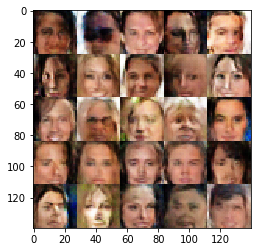

Epoch: 2/2 Discriminator Loss: 0.5885694026947021 Generator Loss: 2.5295584201812744
Epoch: 2/2 Discriminator Loss: 0.7006533145904541 Generator Loss: 2.6019206047058105
Epoch: 2/2 Discriminator Loss: 0.9211794137954712 Generator Loss: 2.377470016479492
Epoch: 2/2 Discriminator Loss: 0.5447995662689209 Generator Loss: 2.5112619400024414
Epoch: 2/2 Discriminator Loss: 0.6436738967895508 Generator Loss: 3.6726531982421875
Epoch: 2/2 Discriminator Loss: 0.8101391792297363 Generator Loss: 3.9637813568115234
Epoch: 2/2 Discriminator Loss: 0.6036384105682373 Generator Loss: 0.7440126538276672
Epoch: 2/2 Discriminator Loss: 0.8234423995018005 Generator Loss: 2.6033289432525635
Epoch: 2/2 Discriminator Loss: 1.3425631523132324 Generator Loss: 3.2440686225891113
Epoch: 2/2 Discriminator Loss: 0.5490589737892151 Generator Loss: 2.3846113681793213


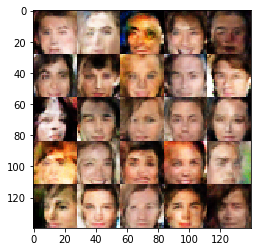

Epoch: 2/2 Discriminator Loss: 0.49045222997665405 Generator Loss: 3.247014045715332
Epoch: 2/2 Discriminator Loss: 0.5936192870140076 Generator Loss: 2.7153682708740234
Epoch: 2/2 Discriminator Loss: 0.5820027589797974 Generator Loss: 1.2089743614196777
Epoch: 2/2 Discriminator Loss: 0.49109703302383423 Generator Loss: 3.5140275955200195
Epoch: 2/2 Discriminator Loss: 0.7423256635665894 Generator Loss: 2.9446029663085938
Epoch: 2/2 Discriminator Loss: 0.8661706447601318 Generator Loss: 3.6792006492614746
Epoch: 2/2 Discriminator Loss: 1.1905059814453125 Generator Loss: 1.3854727745056152
Epoch: 2/2 Discriminator Loss: 0.6441465616226196 Generator Loss: 4.101478576660156
Epoch: 2/2 Discriminator Loss: 0.9037718772888184 Generator Loss: 3.542832136154175
Epoch: 2/2 Discriminator Loss: 0.4905959963798523 Generator Loss: 3.2299234867095947


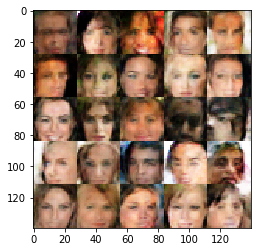

Epoch: 2/2 Discriminator Loss: 0.5752844214439392 Generator Loss: 2.040771961212158
Epoch: 2/2 Discriminator Loss: 0.5415785312652588 Generator Loss: 4.025240898132324


In [13]:
batch_size = 16
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.